# Image Segmentation with Fast.ai v2 and SemTorch

In [1]:
env = dict()
env['use_dataparallel'] = True

import os
if env['use_dataparallel']:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'
else:
    os.environ['CUDA_VISIBLE_DEVICES'] = '1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'

In [2]:
!nvidia-smi

Wed Sep 22 16:23:24 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   40C    P0    29W / 250W |      0MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

# Import-initialization


%matplotlib inline

or

%matplotlib notebook

In [3]:
!pip install semtorch
!pip install --upgrade albumentations
!pip install fastai==2.3.0
!pip show fastai

from fastai.basics import *
from fastai.vision import models
from fastai.vision.all import *
from fastai.metrics import *
from fastai.data.all import *
from fastai.callback import *

# SemTorch
from semtorch import get_segmentation_learner

from pathlib import Path
import random
import numpy as np

# Display larger jupyter cells!
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

if env['use_dataparallel']:
    from fastai.distributed import *
    cuda_training_device = 0           # otherwise: RuntimeError: module must have its parameters and buffers on device cuda:0 (device_ids[0]) but found one of them on device: cuda:1
else:
    pass
    #cuda_training_device = 1           # the device of your choice

You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.
You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.


You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.
Name: fastai
Version: 2.3.0
Summary: fastai simplifies training fast and accurate neural nets using modern best practices
Home-page: https://github.com/fastai/fastai/tree/master/
Author: Jeremy Howard, Sylvain Gugger, and contributors
Author-email: info@fast.ai
License: Apache Software License 2.0
Location: /local/ranieri/venvs/ml-local-node-10/lib/python3.6/site-packages
Requires: spacy, packaging, pandas, scikit-learn, torch, pillow, pip, torchvision, matplotlib, scipy, pyyaml, fastprogress, fastcore, requests
Required-by: SemTorch


/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


# Determinism


In [4]:
from datetime import datetime

env['seed'] = 2021
env['launch_time'] = datetime.now().strftime('%Y-%m-%d_%H.%M.%S')

random.seed(env['seed'])
set_seed(env['seed'])
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Secondary Functions


Get filenames both for images and masks

In [5]:
#export
def get_y_fn(img_fn):
    if 'mask' in str(img_fn):
        print(f'Warning! {img_fn} looks like a mask!')
    return Path(str(img_fn).replace("images", "masks").replace('.jpg', '.png'))

#export
def get_x_fns(path, folders, debug=False):
    new_fns = []
    for dset_dir in folders:
        fns = get_image_files(path / dset_dir)
        for fn in fns:
            if not 'mask' in str(fn):
                new_fns.append(fn)
    if debug:
        fn_name = inspect.currentframe().f_code.co_name
        print(f'{fn_name} - {len(new_fns)} - {new_fns}')
    return new_fns

Aux Functions



In [6]:
# dataset/train, dataset/valid
def ValidParentSplitter(x):
    return Path(x).parent.name == str(env['validation_dir'])

# dataset/train/images, dataset/train/masks, dataset/valid/images, dataset/valid/masks
def ValidGrandParentSplitter(x):
    return Path(x).parent.parent.name == env['validation_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/valid/images, dataset/subdataset/valid/masks
def ValidGrandGrandParentSplitter(x):
    return Path(x).parent.parent.parent.name == env['validation_dir'].name

Loading the codes of the different classes. All the datasets have the same codes.

In [7]:
import torchvision

codes = ['NoPatt','circlets','fringe','long_incisions','eyebrows','oblique_fringe','spirals','Background']

name2id = {v:k for k,v in enumerate(codes)}
print(name2id)
void_code   = name2id['Background']
nopatt_code = name2id['NoPatt']

#export
def surfpatt_metric(input, target):
    target      = target.squeeze(1)
    void_mask   = target != void_code
    nopatt_mask = target != nopatt_code
    mask        = torch.logical_and(void_mask, nopatt_mask)
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

{'NoPatt': 0, 'circlets': 1, 'fringe': 2, 'long_incisions': 3, 'eyebrows': 4, 'oblique_fringe': 5, 'spirals': 6, 'Background': 7}


Early Stopping parameters

In [8]:
env['monitor_training']   = "valid_loss"
env['comp_training']      = np.less

env['monitor_evaluating'] = "f1-score"
env['comp_evaluating']    = np.greater

env['patience']           = 10

Augmentations 

In [9]:
import cv2

cv2.setNumThreads(0)
cv2.ocl.setUseOpenCL(False)

from albumentations import (
    Compose,
    HorizontalFlip,
    OneOf,
    ElasticTransform,
    GridDistortion, 
    OpticalDistortion,
    Flip,
    Rotate,
    Transpose,
    CLAHE,
    ShiftScaleRotate,
    RandomRotate90,
    HueSaturationValue,
    Emboss,
    Sharpen,
    PiecewiseAffine,
    #IAAEmboss,
    #IAASharpen,
    #IAAPiecewiseAffine,
    #IAAAdditiveGaussianNoise,
    GaussNoise,
    Blur,
    MotionBlur,
    MedianBlur,
    RandomContrast,
    RandomBrightness,
)

In [10]:
class SegmentationAlbumentationsTransform(ItemTransform):
    split_idx = 0
    def __init__(self, aug): 
        self.aug = aug
    def encodes(self, x):
        img,mask = x
        aug = self.aug(image=np.array(img), mask=np.array(mask))
        return PILImage.create(aug["image"]), PILMask.create(aug["mask"])

def strong_aug(p=1):
    return Compose([
        RandomRotate90(),
        Flip(),
        Transpose(),
        OneOf([
            #IAAAdditiveGaussianNoise(),
            GaussNoise(),
        ], p=0.2),
        OneOf([
            MotionBlur(p=.2),
            MedianBlur(blur_limit=3, p=.1),
            Blur(blur_limit=3, p=.1),
        ], p=0.2),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=45, p=.2),
        OneOf([
            OpticalDistortion(p=0.3),
            GridDistortion(p=.1),
            PiecewiseAffine(p=0.3),
            #IAAPiecewiseAffine(p=0.3),
        ], p=0.2),
        OneOf([
            CLAHE(clip_limit=2),
            Sharpen(),
            #IAASharpen(),
            #IAAEmboss(),
            Emboss(),
            RandomContrast(),
            RandomBrightness(),
        ], p=0.3),
        #HueSaturationValue(p=0.3),
    ], p=p)
    
basicTransformPipeline=Compose([
                        HorizontalFlip    (p=0.25),
                        RandomRotate90    (p=0.25),
                        Transpose         (p=0.25),
                        ShiftScaleRotate  (p=0.25, shift_limit=0.0625, scale_limit=0.50, rotate_limit=45),
                        Blur              (p=0.1,  blur_limit=3),
                        ElasticTransform  (p=0.1,  alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                        GridDistortion    (p=0.1,  num_steps=1, distort_limit=0.05),
                        OpticalDistortion (p=0.1,  distort_limit=0.05, shift_limit=0.01),
                        HueSaturationValue(p=0.1),
                        CLAHE             (p=0.1),
                    ],p=1)

basicTransformPipeline  = SegmentationAlbumentationsTransform(basicTransformPipeline)

strongTransformPipeline = strong_aug(p=1)
strongTransformPipeline = SegmentationAlbumentationsTransform(strongTransformPipeline)

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/albumentations/augmentations/transforms.py:1772: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,
/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/albumentations/augmentations/transforms.py:1746: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,


# Get and setup dataset


In [11]:
basepath       = '/home/ranieri/dataset/surface-pattern-recognition/segmentation'
dataset_suffix = 'v3alpha-RGB+SI-patch-radius-1.25'
#newbasepath   = '/local/ranieri/dataset/surface-pattern-recognition/segmentation'
newbasepath    = '/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation'

In [12]:
# rsync the dataset to the node's scratch space (much faster I/O)
!echo "Copying files to: {newbasepath}"
!mkdir -p {newbasepath}
!rsync -a "{basepath}/SURFpattSegmentation_{dataset_suffix}" "{newbasepath}"
basepath = newbasepath

Copying files to: /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation


In [13]:
env['orig_img_size'] = (1585, 1502)

In [14]:
env['project_name'] = f'SURFpatt_{dataset_suffix}'

env['path'] = Path(basepath) / f'SURFpattSegmentation_{dataset_suffix}'

env['training_dir']   = env['path'] / 'training'
env['validation_dir'] = env['path'] / 'validation'

### Perform RGB-to-grayscale conversion of masks



In [15]:
#export
from fastcore.transform import ItemTransform
        
class TargetMaskConvertTransform(ItemTransform):
    def __init__(self):
        self.mapping = {
                        (0, 0, 255): 0,  # 0 = blue - NoPatt
                        (255, 0, 0): 1,  # 1 = red - circlets
                        (0, 255, 0): 2,  # 2 = green - fringe
                        (0, 0, 44): 3,  # 3 = black - long incisions
                        (255, 26, 185): 4,  # 4 = magenta - eyebrows
                        (255, 211, 0): 5,  # 5 = yellow - oblique fringe
                        (0, 88, 0): 6,  # 6 = dark green - spirals
                        (255,255,255): 7, # 7 = white - Background
        }
        
    def mask_to_class_rgb(self, mask, debug=False):
        if debug:
            print('mask_to_class_rgb() - converting RGB mask to grayscale')
        mask = torch.from_numpy(np.array(mask))
        mask = torch.squeeze(mask)  # remove 1

        # check the present values in the mask, 0 and 255 in my case
        if debug:
            print(f'Unique RGB values: {torch.unique(mask)}') 
        # -> unique values rgb     tensor([  0, 255], dtype=torch.uint8)

        class_mask = mask
        if debug:
            print(f'class_mask: {class_mask.shape}')
        class_mask = class_mask.permute(2, 0, 1).contiguous()
        h, w = class_mask.shape[1], class_mask.shape[2]
        mask_out = torch.empty(h, w, dtype=torch.long)

        for k in self.mapping:
            idx = (class_mask == torch.tensor(k, dtype=torch.uint8).unsqueeze(1).unsqueeze(2))         
            validx = (idx.sum(0) == 3)          
            mask_out[validx] = torch.tensor(self.mapping[k], dtype=torch.long)

        # check the present values after mapping, in my case 0, 1, 2, 3
        if debug:
            print(f'Unique grayscale values mapped: {torch.unique(mask)}')
        # -> unique values mapped  tensor([0, 1, 2, 3])
       
        return mask_out
    
    def gray_to_rgb(self, gray):
        rgb = np.zeros((gray.shape[0], gray.shape[1], 3)).astype(np.uint8)
        rgb[:,:,0] = gray
        rgb[:,:,1] = gray
        rgb[:,:,2] = gray
        return rgb
    
    def encodes(self, x, debug=False):
        if type(x) is not tuple and type(x) is not list:        # this is necessary because TargetMaskConvertTransform gets trapped into the PKL even just doing learn.export()
            return x
        img,mask = x
        
        #Convert to array
        mask_arr = np.array(mask)
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques before: {np.unique(mask_arr)}')
        
        gray_torch_mask = self.mask_to_class_rgb(mask_arr, debug=debug)
        if debug:
            print(type(gray_torch_mask))
            print(gray_torch_mask.shape)
        gray_mask_arr = gray_torch_mask.numpy().astype(np.uint8)
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques middle: {np.unique(gray_mask_arr)}')
            print(type(gray_mask_arr))
            print(gray_mask_arr.dtype)
            print(gray_mask_arr.shape)
            print(gray_mask_arr)
        
        gray_mask_arr_3ch = self.gray_to_rgb(gray_mask_arr)
        if debug:
            print(type(gray_mask_arr_3ch))
            print(gray_mask_arr_3ch.dtype)
            print(gray_mask_arr_3ch.shape)
            print(gray_mask_arr_3ch)
        
        # Back to PILMask
        mask = PILMask(PILMask.create(gray_mask_arr_3ch).convert('L'))
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques after: {np.unique(mask)} - mask mode: {mask.mode}')
        return img, mask

In [16]:
#export
def segmentron_splitter(model):
    return [params(model.backbone), params(model.head)]

# DeepLabV3+

In [17]:
for s in [ 'training', 'validation' ]:
        env[s+'_images'] = env[s+'_dir']  / 'images'
        env[s+'_masks']  = env[s+'_dir']  / 'masks'
    
for s in [ 'training', 'validation' ]:
        print(env[s+'_images'])
        print(env[s+'_masks'])

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/images
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/masks


In [18]:
for s in [ 'training', 'validation' ]:
        env[s+'_images_fns'] = get_image_files(env[s+'_images'])
        env[s+'_masks_fns']  = get_image_files(env[s+'_masks'])

for s in [ 'training', 'validation' ]:
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        print(env[s+'_images_fns'][n])
        print(env[s+'_masks_fns'][n])

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/24_390-si.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/24_390-si.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/images/24_214-col.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/masks/24_214-col.png


/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/1_4-si.jpg (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/1_4-si.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/images/15_15-si.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/masks/15_15-si.png (1554, 1503)


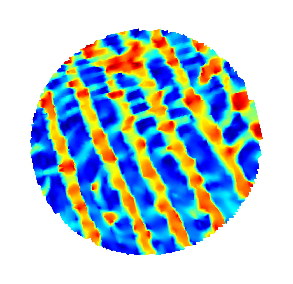

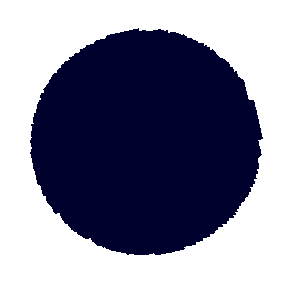

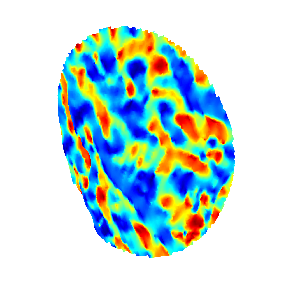

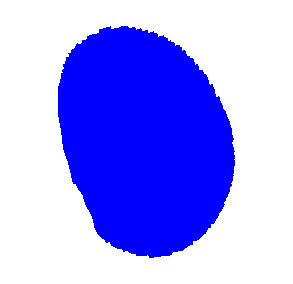

In [19]:
for s in [ 'training', 'validation' ]:
        # open and show random image
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        img_f = env[s+'_images_fns'][n]
        image = PILImage.create(img_f)
        image.show(figsize=(5, 5))
        print(img_f, image.size)
        mask_f = env[s+'_masks_fns'][n]
        mask = PILImage.create(mask_f)
        mask.show(figsize=(5, 5))
        print(mask_f, mask.size)

tensor(255, dtype=torch.uint8)
<class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILMask'>
tensor(7, dtype=torch.uint8)


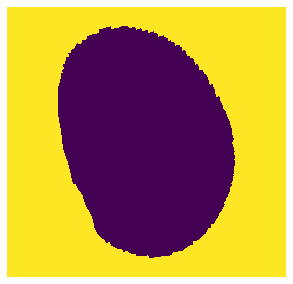

In [20]:
print(torch.max(image2tensor(mask)))
tfm = TargetMaskConvertTransform()
image2, mask2 = tfm.encodes((image, mask))
print(type(image), type(mask), type(image2), type(mask2))
print(torch.max(image2tensor(mask2)))
show_image(mask2)

In [21]:
for s in [ 'training', 'validation' ]:
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        img_f = env[s+'_images_fns'][n]
        print(img_f)
        print(get_y_fn(img_f))

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/26_7-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/26_7-col.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/images/4_90-col.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/masks/4_90-col.png


In [22]:
# double check the whole dataset to see if every pair (image, mask) is in place
missing_pairs = 0
for s in [ 'training', 'validation' ]:
        for img_fn in env[s+'_images_fns']:
            #print(str(img_fn) + ' -> ' + str(get_y_fn(img_fn)))
            if not img_fn.is_file() or not get_y_fn(img_fn).is_file():
                short_img_fn  = str(img_fn).replace(str(env["path"])+'/',"")
                short_mask_fn = str(get_y_fn(img_fn)).replace(str(env["path"])+'/',"")
                print(f'One between {short_img_fn} and {short_mask_fn} is missing!')
                missing_pairs += 1
                
print(f'A total of {missing_pairs} missing pairs were found...')

A total of 0 missing pairs were found...


# Learning Setup


In [23]:
env['segmentation_type'] = "Semantic Segmentation"
env['arch'] = "deeplabv3+"
env['backbone'] = "resnet152"
env['wd'] = 1e-4
env['n_classes'] = len(codes)

#env['num_workers'] = 0      # 20 min per epoch @ bs = 8
#env['num_workers'] = 8      # 12 min  per epoch @ bs = 8
env['num_workers'] = 16      # 10 min  per epoch @ bs = 8
#env['num_workers'] = 32     # 12 min  per epoch @ bs = 8

env['cmap']        = matplotlib.colors.LinearSegmentedColormap.from_list("", ['blue','red','green','black','magenta','yellow','pink','white'])

In [24]:
def is_frozen(learn, debug=False):
    for child in learn.model.children():
        if debug:
            print(child)
        for param in child.parameters():
            if debug:
                print(param.requires_grad)
            if param.requires_grad == False:
                return True, 'a', 'frozen'
    return False, 'b', 'unfrozen'

In [25]:
def show_hyperparams():
    dp_str = ''
    dv_ids = learn.model.device_ids if 'device_ids' in learn.model.__dict__ else ''
    if 'use_dataparallel' in env:
        dp_str = f' - device_ids: {dv_ids}, n_gpu: {torch.cuda.device_count()}'
    print(f'Batch size: {env["bs"]}, image size: {env["img_size"]}, learning rate: {env["lr"]}, round: {env["train_round"]}' + dp_str)

In [26]:
def get_save_fn(env, debug=False):
    part1 = env['project_name'] + '-' + env['arch'] + '-' + env['backbone'] + '-'
    part2 = env['data-augmentation'] + '-img_size-' + '-'.join(str(x) for x in env['img_size']) + '-'
    part3 = str(env['train_round']) + env['model_frozen_letter']+ '-' + env['launch_time']
    part4 = '-' + 'WD-' + str(env['wd']) + '-' + 'BS-' + str(env['bs']) + '-'
    part5 = 'LR-' + (str(env['lr'].start) + '-' + str(env['lr'].stop) if type(env['lr']) is slice else str(env['lr']))
    env['save_fn'] = part1 + part2 + part3 + part4 + part5   # at the third unspecified error on a four-lines long instruction, one gives up with the one-linearism
    if debug:
        print(f'save_fn = {env["save_fn"]}')
    return 

In [27]:
class SaveBestAccuracyCallback(TrackerCallback):
    def __init__(self, monitor='accuracy', save_str:str='best-accuracy-model'):
        super().__init__(monitor=monitor) #, reset_on_fit=True)
        #self.prev_acc = 0.0
        self.save_str = save_str
        
    def after_epoch(self):
        super().after_epoch()
        if self.new_best:
            print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
            self.save(f'{self.save_str}-epoch-{self.epoch}-{self.monitor}-{self.best:.4f}')

In [28]:
def fit_one_cycle(env, learn, epochs):
    get_save_fn(env, debug=True)
    
    monitor_training   = env['monitor_training']
    comp_training      = env['comp_training']

    monitor_evaluating = env['monitor_evaluating']
    comp_evaluating    = env['comp_evaluating']

    patience           = env['patience']
    
    callbacks = [
        ShowGraphCallback(),
        EarlyStoppingCallback(monitor=monitor_training, comp=comp_training, patience=patience),
        SaveModelCallback(monitor=monitor_training, comp=comp_training, every_epoch=False, fname=env['save_fn']+'-best'),
        SaveBestAccuracyCallback(monitor=monitor_training, save_str=env['save_fn'])
        ]
    
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"Training in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        !nvidia-smi
    else:    
        learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        
    learn.show_results(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

In [29]:
import sklearn.metrics as skm
import sklearn.metrics._classification as skmc

'''
**********************************************************************************
** Here we split Scikit Learn precision_recall_fscore_support() function in two **
** parts. The first one takes preds and targets for each batch and gives the *****
** confusion matrix for the batch. The accumulate() function sums up all the *****
** confusion matrices, at the end of the validation step, the value() function ***
** calls the second part of precision_recall_fscore_support() function and *******
** computes precision/recall/f-score/support all at once.
**********************************************************************************
'''

def precision_recall_fscore_support_part_one(y_true, y_pred, beta=1.0, labels=None,
                                    pos_label=1, average=None,
                                    warn_for=('precision', 'recall', 'f-score'),
                                    sample_weight=None,
                                    zero_division="warn"):
    '''
    Given y_true, y_pred (of any kind, even segmentation masks), returns the
    Multiclass Confusion Matrix. In segmentation tasks, you can pass the whole
    dataset's y_true, y_pred (uncompressed masks of thousands of images), so
    this function has to be called for each validation batch.
    '''
    skmc._check_zero_division(zero_division)
    if beta < 0:
        raise ValueError("beta should be >=0 in the F-beta score")
    labels = skmc._check_set_wise_labels(y_true, y_pred, average, labels, pos_label)

    # Calculate tp_sum, pred_sum, true_sum ###
    samplewise = average == 'samples'
    partial_MCM = skm.multilabel_confusion_matrix(y_true, y_pred,
                                      sample_weight=sample_weight,
                                      labels=labels, samplewise=samplewise)
    return partial_MCM


def precision_recall_fscore_support_part_two(MCM, beta=1.0, labels=None,
                                    pos_label=1, average=None,
                                    warn_for=('precision', 'recall', 'f-score'),
                                    sample_weight=None,
                                    zero_division="warn"):
    tp_sum = MCM[:, 1, 1]
    pred_sum = tp_sum + MCM[:, 0, 1]
    true_sum = tp_sum + MCM[:, 1, 0]

    if average == 'micro':
        tp_sum = np.array([tp_sum.sum()])
        pred_sum = np.array([pred_sum.sum()])
        true_sum = np.array([true_sum.sum()])

    # Finally, we have all our sufficient statistics. Divide! #
    beta2 = beta ** 2

    # Divide, and on zero-division, set scores and/or warn according to
    # zero_division:
    precision = skmc._prf_divide(tp_sum, pred_sum, 'precision', 'predicted', average, warn_for, zero_division)
    recall = skmc._prf_divide(tp_sum, true_sum, 'recall', 'true', average, warn_for, zero_division)
    
    # warn for f-score only if zero_division is warn, it is in warn_for
    # and BOTH prec and rec are ill-defined
    if zero_division == "warn" and ("f-score",) == warn_for:
        if (pred_sum[true_sum == 0] == 0).any():
            skmc._warn_prf(average, "true nor predicted", 'F-score is', len(true_sum))

    # if tp == 0 F will be 1 only if all predictions are zero, all labels are
    # zero, and zero_division=1. In all other case, 0
    if np.isposinf(beta):
        f_score = recall
    else:
        denom = beta2 * precision + recall

        denom[denom == 0.] = 1  # avoid division by 0
        f_score = (1 + beta2) * precision * recall / denom

    # Average the results
    if average == 'weighted':
        weights = true_sum
        if weights.sum() == 0:
            zero_division_value = 0.0 if zero_division in ["warn", 0] else 1.0
            # precision is zero_division if there are no positive predictions
            # recall is zero_division if there are no positive labels
            # fscore is zero_division if all labels AND predictions are
            # negative
            return (zero_division_value if pred_sum.sum() == 0 else 0,
                    zero_division_value,
                    zero_division_value if pred_sum.sum() == 0 else 0,
                    None)

    elif average == 'samples':
        weights = sample_weight
    else:
        weights = None

    if average is not None:
        assert average != 'binary' or len(precision) == 1
        precision = np.average(precision, weights=weights)
        recall = np.average(recall, weights=weights)
        f_score = np.average(f_score, weights=weights)
        true_sum = None  # return no support

    return precision, recall, f_score, true_sum


mk_class('ActivationType', **{o:o.lower() for o in ['No', 'Sigmoid', 'Softmax', 'BinarySoftmax']},
         doc="All possible activation classes for `AccumMetric")

class PrecisionRecallAUCROCMulticlass(Metric):
    "Helper function for calculating Averaged Precision/Recall/Area Under the Receiver Operating Characteristic Curve (AUC-ROC) metrics for multiclass target in segmentation"
    def __init__(self, skm_metric=skm.precision_score, axis=1): self.axis,self.skm_metric = axis,skm_metric
    def reset(self): self.metric, self.learn = {}, None
    def accumulate(self, learn):
        self.learn = learn
        pred,targ  = flatten_check(learn.pred.argmax(dim=self.axis), learn.y)
        activation = ActivationType.Sigmoid if sigmoid else ActivationType.No
        
        if self.skm_metric == skm.roc_auc_score:
            self.metric = skm_to_fastai(self.skm_metric, axis=self.axis, thresh=None, activation=activation, flatten=True,
                                 labels=None, multi_class='ovo', average='macro', sample_weight=None)
        else:
            self.metric = skm_to_fastai(self.skm_metric, axis=self.axis, thresh=None, activation=activation, flatten=True,
                                 labels=None, pos_label=1,       average='macro', sample_weight=None)

    @property
    def name(self): return self.skm_metric.__name__
    @property
    def value(self):
        pred,targ  = flatten_check(self.learn.pred.argmax(dim=self.axis), self.learn.y)
        metric = self.metric(pred,targ)
        print(f'metric.shape = {metric.shape} - metric = {metric}')
        return metric

In [30]:
f1score = precision = recall = support = None

class MulticlassPrecisionRecallFScoreSupport(Metric):
    "Macro F1 Score/Precision/Recall/Support metrics for multiclass target in segmentation problems. Confusion matrix is accumulated batch by batch using sklearn modified code."
    def __init__(self, axis=1, metric='f-score', debug=False): self.axis, self.debug, self.metric = axis, debug, metric    # 'fscore', 'precision', 'recall', 'support'
    def reset(self): self.MCM, self.counter = None, 0
    def accumulate(self, learn):
        if self.isfscore():
            self.learn  = learn
            pred,targ   = flatten_check(learn.pred.argmax(dim=self.axis), learn.y)
            y_true      = targ.cpu().numpy()
            y_pred      = pred.cpu().numpy()
            partial_MCM = precision_recall_fscore_support_part_one(y_true, y_pred, beta=1.0,      # builds the partial Multiclass Confusion Matrix for the current validation batch
                                                               labels=None, pos_label=1,
                                                               average='macro',
                                                               warn_for=('precision', 'recall', 'f-score'),
                                                               sample_weight=None, zero_division="warn")
        
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - accumulate() batch: {self.counter} -> partial MCM: {partial_MCM}')
        
            if self.MCM is None:
                self.MCM = partial_MCM
            else:
                self.MCM += partial_MCM

            if self.debug:
                print(self.counter, self.MCM)
        else:
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - skipping accumulate() batch: {self.counter}')
        self.counter += 1
    
    def isfscore(self):
        return self.metric.replace('-','').replace('_','') == 'fscore' or self.metric.replace('-','').replace('_','') == 'f1score'
    @property
    def name(self): return self.metric
    @property
    def value(self):
        global f1score, precision, recall, support
        if self.isfscore():
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - value() n_batch: {self.counter} -> partial MCM: {self.MCM}')
            p, r, f1, s = precision_recall_fscore_support_part_two(self.MCM, beta=1.0,
                                                                   labels=None, pos_label=1,
                                                                   average='macro',
                                                                   warn_for=('precision', 'recall', 'f-score'),
                                                                   sample_weight=None, zero_division="warn")
            precision, recall, f1score, support = p, r, f1, s
        else:
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - value() n_batch: {self.counter} -> using p, r, f1, s precomputed values: {precision} - {recall} - {f1score} - {support}')

        if self.isfscore():
            metric_value = f1score
        elif self.metric == 'precision':
            metric_value = precision
        elif self.metric == 'recall':
            metric_value = recall
        elif self.metric == 'support':
            metric_value = support
        else:
            metric_value = float('nan')
        return metric_value

In [31]:
class PILMask(PILBase): _open_args,_show_args = {'mode':'RGB'},{'alpha':0.5}
PILMask._open_args = {'mode':'RGB'}
OpenMask = Transform(PILMask.create)
OpenMask.loss_func = CrossEntropyLossFlat(axis=1)
PILMask.create = OpenMask
PILMask._tensor_cls = TensorMask

def MaskBlock(codes=None):
    "A `TransformBlock` for segmentation masks, potentially with `codes`"
    return TransformBlock(type_tfms=PILMask.create, item_tfms=AddMaskCodes(codes=codes), batch_tfms=IntToFloatTensor)

def init_learner(env):
    env['img_size']    = [int(x / 2) for x in env['orig_img_size']]
    env['bs']          = 8
       
    db = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=partial(get_x_fns, folders=['training', 'validation']),
                   get_y=get_y_fn,
                   splitter=FuncSplitter(ValidGrandParentSplitter),
                   item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform()],
                   batch_tfms=Normalize.from_stats(*imagenet_stats)
                  )
    db.summary(env['path'])
    dls = db.dataloaders(env['path'], bs=env['bs'], num_workers=env['num_workers'])
    dls.show_batch(figsize=(8, 8), vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

    metrics = [surfpatt_metric, # DiceMulti(),
               MulticlassPrecisionRecallFScoreSupport(metric='f-score'),
               MulticlassPrecisionRecallFScoreSupport(metric='precision'),
               MulticlassPrecisionRecallFScoreSupport(metric='recall'),
              ]
    
    learn = get_segmentation_learner(dls=dls, number_classes=env['n_classes'], segmentation_type=env['segmentation_type'],
                                 architecture_name=env['arch'], backbone_name=env['backbone'], 
                                 metrics=metrics, wd=env['wd'],
                                 splitter=segmentron_splitter).to_fp16()
    learn.freeze() # Freezing the backbone
    return learn

Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1554x1503
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/11_15-si.png
    applying PILBase.create gives
      PILMask mode=RGB size=1554x1503

Final sample: (PILImage mode=RGB size=1554x1503, PILMask mode=RGB size=

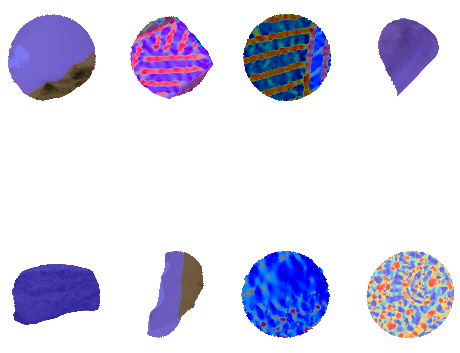

In [32]:
learn = init_learner(env)

In [33]:
import os
def reload_best_model(learn, prefix, debug=False):
    model_dir = learn.path.absolute() / learn.model_dir
    print(f'Looking for {prefix}-*-best models in: {model_dir}')
    print(20*'-')
    files = model_dir.glob(f'{prefix}*-best.pth')
    files = sorted(files, key=os.path.getmtime)
    for i in files:
        print(i)
    print(20*'-')
    print(f'Reloading {i}')
    learn.load(str(i).replace('.pth', ''))
    metrics = learn.validate()
    if debug:
        print(f'learn.metrics: {learn.metrics}')
        for idx, this_metric in enumerate(learn.metrics):
            print(f'this_metric.name: {this_metric.name}')
        print(f'metrics: {metrics}')
    for idx, metric_score in enumerate(metrics):
        if idx != 0:
            metric_str = str(learn.metrics[idx-1].name)
            print(f'{idx} - {metric_str} = {metric_score}')
        else:
            print(f'{idx} - valid_loss = {metric_score}')

In [34]:
def garbage_collect():
    import gc
    gc.collect()
    torch.cuda.empty_cache()

In [35]:
def test_albumentation_transforms(which_pipeline):
    for s in [ 'training', 'validation' ]:
            n = random.randint(0, len(env[s+'_images_fns'])-1)
            img_f = env[s+'_images_fns'][n]
            image = PILImage.create(img_f)
            print(img_f, image.size)
            mask_f = env[s+'_masks_fns'][n]
            mask = PILImage.create(mask_f)
            print(mask_f, mask.size)
            augimg, augmask = which_pipeline.encodes((image, mask))

            #subplot(r,c) provide the no. of rows and columns
            f, axarr = plt.subplots(1,4,figsize=(15,5)) 

            # use the created array to output your multiple images. In this case I have stacked 4 images vertically
            axarr[0].imshow(image)
            axarr[1].imshow(augimg)
            axarr[2].imshow(mask)
            axarr[3].imshow(augmask)

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/18_16-si.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/18_16-si.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/images/3_19-si.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/masks/3_19-si.png (1554, 1503)


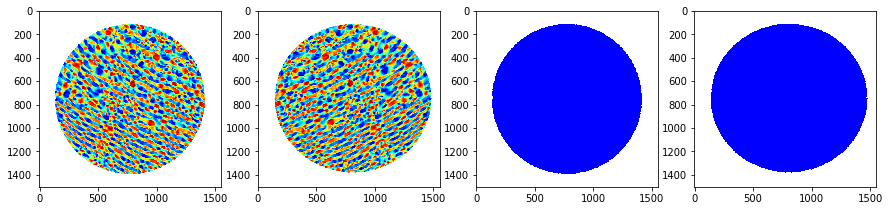

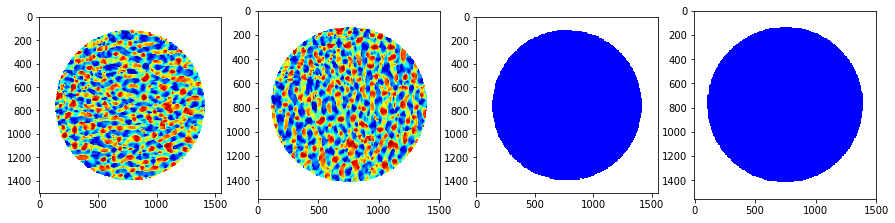

In [36]:
test_albumentation_transforms(basicTransformPipeline)

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/15_17-col.jpg (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/15_17-col.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/images/27_13-si.png (1554, 1503)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/validation/masks/27_13-si.png (1554, 1503)


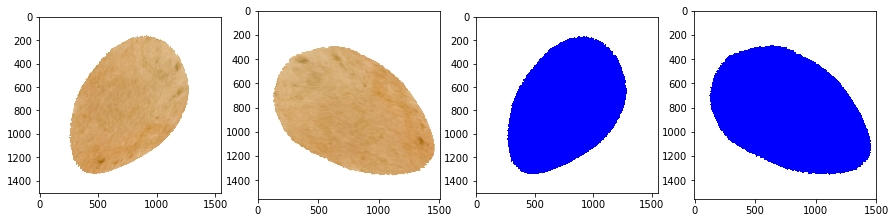

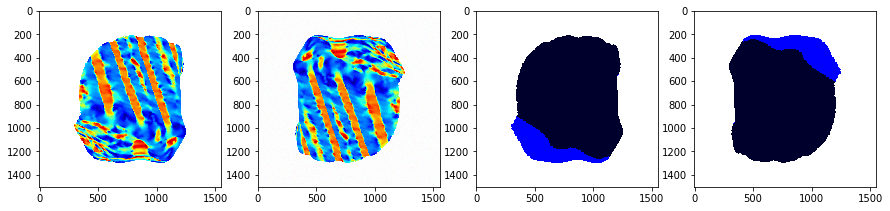

In [37]:
test_albumentation_transforms(strongTransformPipeline)

In [38]:
env['img_size_div'] = [1]
env['batch_sizes']  = [8]

# Define training ground functions

In [39]:
def next_round(env):
    env['train_round'] += 1
    env['img_size']     = [int(env['orig_img_size'][0] / env['img_size_div'][env['train_round']-1])] * 2     
    env['bs']           = env['batch_sizes'][env['train_round']-1]

In [40]:
def alloc_datablock(env, splitter=ValidGrandParentSplitter, training_dir='training', valid_dir='validation'):
    if env['data-augmentation'] == 'no-data-aug':
        print('---------------------------------')
        print('Running with no data augmentation')
        print('---------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform()]
    elif env['data-augmentation'] == 'basic-data-aug':
        print('------------------------------------')
        print('Running with basic data augmentation')
        print('------------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform(), basicTransformPipeline]
    elif env['data-augmentation'] == 'strong-data-aug':
        print('-------------------------------------')
        print('Running with strong data augmentation')
        print('-------------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform(), strongTransformPipeline]
    db = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=partial(get_x_fns, folders=[training_dir, valid_dir]),
                   get_y=get_y_fn,
                   splitter=FuncSplitter(splitter),
                   item_tfms=item_tfms,
                   batch_tfms=Normalize.from_stats(*imagenet_stats)
                  )
    db.summary(env['path'])
    dls = db.dataloaders(env['path'], bs=env['bs'], num_workers=env['num_workers'])
    dls.show_batch(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])
    return dls

In [41]:
def do_lr_find_impl(env, learn):
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"LR_finding in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            suggested_lrs = learn.lr_find() # find learning rate
            
        !nvidia-smi
    else:
        suggested_lrs = learn.lr_find()     # find learning rate
    
    learn.recorder                          # plot learning rate graph
    print(f'Suggested LRs: {suggested_lrs}')
    if suggested_lrs is None:
        suggested_lrs = [1e-4, 1e-4]
    return suggested_lrs

In [42]:
def do_lr_find(env, learn, dls):
    learn.dls = dls
    learn.freeze()
    return do_lr_find_impl(env, learn)

In [43]:
def set_lr(env, learn, suggested_lrs):
    # lr_min is the minimum value in the curve plotted by lr_find()   -> this means that it may be 1e-1 or even 1e0 so it's actually 10x or even 100x the "reasonable" lr_max
    # lr_steep is the x coord of the plot where the slope is steepest -> this means that it may be 1e-2 or so, so it's a reasonable value for actual lr_max
    lr_min = min(suggested_lrs[1]/100, 1e-2)
    lr_max = min(suggested_lrs[1]/10,  5e-2)
    lr_min = max(lr_min, 1e-4)
    lr_max = max(lr_max, 1e-3)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [44]:
def train_model(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [45]:
def do_lr_find_unfreeze(env, learn):
    learn.unfreeze()
    return do_lr_find_impl(env, learn)

In [46]:
def set_lr_unfreeze(env, learn, suggested_lrs):
    lr_min = min(suggested_lrs[1]/100, 1e-5)
    lr_max = min(suggested_lrs[1]/10,  1e-4)
    lr_min = max(lr_min, 1e-7)
    lr_max = max(lr_max, 1e-6)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [47]:
def train_model_unfreeze(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [48]:
def do_training_round (env, learn, epochs=10):
    next_round(env)
    dls = alloc_datablock(env)
    
    suggested_lrs = do_lr_find(env, learn, dls)
    set_lr(env, learn, suggested_lrs)
    train_model(env, learn, epochs=epochs)
                
    suggested_lrs = do_lr_find_unfreeze(env, learn)
    set_lr_unfreeze(env, learn, suggested_lrs)
    train_model_unfreeze(env, learn, epochs=epochs)

In [49]:
def show_results(env, learn):
    learn.show_results(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

In [50]:
learn.model

DeepLabV3Plus(
  (backbone): ResNetV1(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BottleneckV1b(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential

# No data Aug


## Round 1

In [51]:
env['train_round']       = 0
env['data-augmentation'] = 'no-data-aug'

---------------------------------
Running with no data augmentation
---------------------------------
Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1554x1503
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/11_15-si.png
    applying PILBase.create gives
      PI

Wed Sep 22 16:27:53 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   43C    P0    45W / 250W |  30959MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.545597,0.469975,0.007303,0.235003,0.330880,0.252093,22:50
1,0.434223,0.385855,0.140150,0.304259,0.486366,0.323668,22:52
2,0.399934,0.357341,0.149790,0.320853,0.577821,0.330289,22:51
3,0.392401,0.361876,0.178430,0.353738,0.509208,0.353085,22:56
4,0.382888,0.411998,0.219288,0.348679,0.472261,0.370354,22:51
5,0.401728,0.343621,0.243628,0.410885,0.571675,0.401633,22:51
6,0.380846,0.313591,0.209574,0.405867,0.685821,0.389726,22:56
7,0.354320,0.344613,0.166648,0.350999,0.745021,0.349745,22:54
8,0.342447,0.330149,0.213068,0.431130,0.657692,0.402210,22:55
9,0.333961,0.300219,0.271943,0.489051,0.680534,0.466635,22:56


/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Better model found at epoch 0 with valid_loss value: 0.4699746370315552.
Better model found at epoch 0 with valid_loss value: 0.4699746370315552.


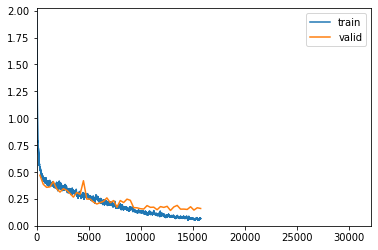

Better model found at epoch 1 with valid_loss value: 0.3858552873134613.
Better model found at epoch 1 with valid_loss value: 0.3858552873134613.
Better model found at epoch 2 with valid_loss value: 0.3573412299156189.
Better model found at epoch 2 with valid_loss value: 0.3573412299156189.
Better model found at epoch 5 with valid_loss value: 0.34362074732780457.
Better model found at epoch 5 with valid_loss value: 0.34362074732780457.
Better model found at epoch 6 with valid_loss value: 0.313591331243515.
Better model found at epoch 6 with valid_loss value: 0.313591331243515.
Better model found at epoch 9 with valid_loss value: 0.3002190887928009.
Better model found at epoch 9 with valid_loss value: 0.3002190887928009.
Better model found at epoch 10 with valid_loss value: 0.2667030096054077.
Better model found at epoch 10 with valid_loss value: 0.2667030096054077.
Better model found at epoch 14 with valid_loss value: 0.2484508752822876.
Better model found at epoch 14 with valid_loss v

Looking for SURFpatt_v3alpha-RGB+SI-patch-radius-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_14.46.24-WD-0.0001-BS-8-LR-0.0022908675670623778-0.02290867567062378-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-0.00010000000149011613-0.0010000000149011613-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-2.0892961401841603e-08-2.08929614018416e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-22_16.23.32-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
--------------------
Reloading /home/

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


0 - valid_loss = 0.14261728525161743
1 - surfpatt_metric = 0.6003506183624268
2 - f-score = 0.7783068319816484
3 - precision = 0.7983398526376386
4 - recall = 0.7754786799854007
LR_finding in parallel_ctx context on GPU [0, 1]


Thu Sep 23 11:53:02 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   43C    P0    46W / 250W |  31127MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.078369,0.149542,0.615089,0.779987,0.780011,0.793722,24:00
1,0.082033,0.145621,0.611868,0.783985,0.777137,0.797642,24:03
2,0.069287,0.148051,0.621752,0.781667,0.776717,0.799484,24:00
3,0.066712,0.148575,0.609750,0.779331,0.786032,0.788129,23:59
4,0.071811,0.137601,0.618128,0.787137,0.798245,0.789214,23:57
5,0.064891,0.138845,0.609758,0.784237,0.793856,0.785788,24:01
6,0.073044,0.135140,0.607899,0.781894,0.797158,0.782041,24:00
7,0.069413,0.139606,0.603435,0.783021,0.798318,0.782573,23:58
8,0.072887,0.134325,0.601572,0.785485,0.807998,0.781112,23:57
9,0.074166,0.139853,0.598375,0.781896,0.794305,0.777385,23:59


Better model found at epoch 0 with valid_loss value: 0.14954222738742828.
Better model found at epoch 0 with valid_loss value: 0.14954222738742828.


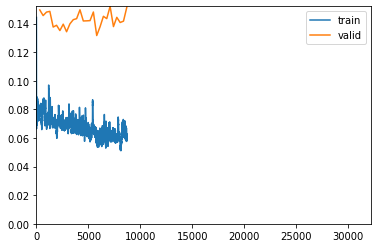

Better model found at epoch 1 with valid_loss value: 0.1456211507320404.
Better model found at epoch 1 with valid_loss value: 0.1456211507320404.
Better model found at epoch 4 with valid_loss value: 0.1376008540391922.
Better model found at epoch 4 with valid_loss value: 0.1376008540391922.
Better model found at epoch 6 with valid_loss value: 0.13513998687267303.
Better model found at epoch 6 with valid_loss value: 0.13513998687267303.
Better model found at epoch 8 with valid_loss value: 0.13432510197162628.
Better model found at epoch 8 with valid_loss value: 0.13432510197162628.
Better model found at epoch 17 with valid_loss value: 0.1316615492105484.
Better model found at epoch 17 with valid_loss value: 0.1316615492105484.
No improvement since epoch 17: early stopping
Thu Sep 23 23:06:28 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------

Looking for SURFpatt_v3alpha-RGB+SI-patch-radius-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_14.46.24-WD-0.0001-BS-8-LR-0.0022908675670623778-0.02290867567062378-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-0.00010000000149011613-0.0010000000149011613-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-2.0892961401841603e-08-2.08929614018416e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-22_16.23.32-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpa

0 - valid_loss = 0.13166934251785278
1 - surfpatt_metric = 0.5991966724395752
2 - f-score = 0.8002080859107705
3 - precision = 0.8097856449201128
4 - recall = 0.7934092280094268


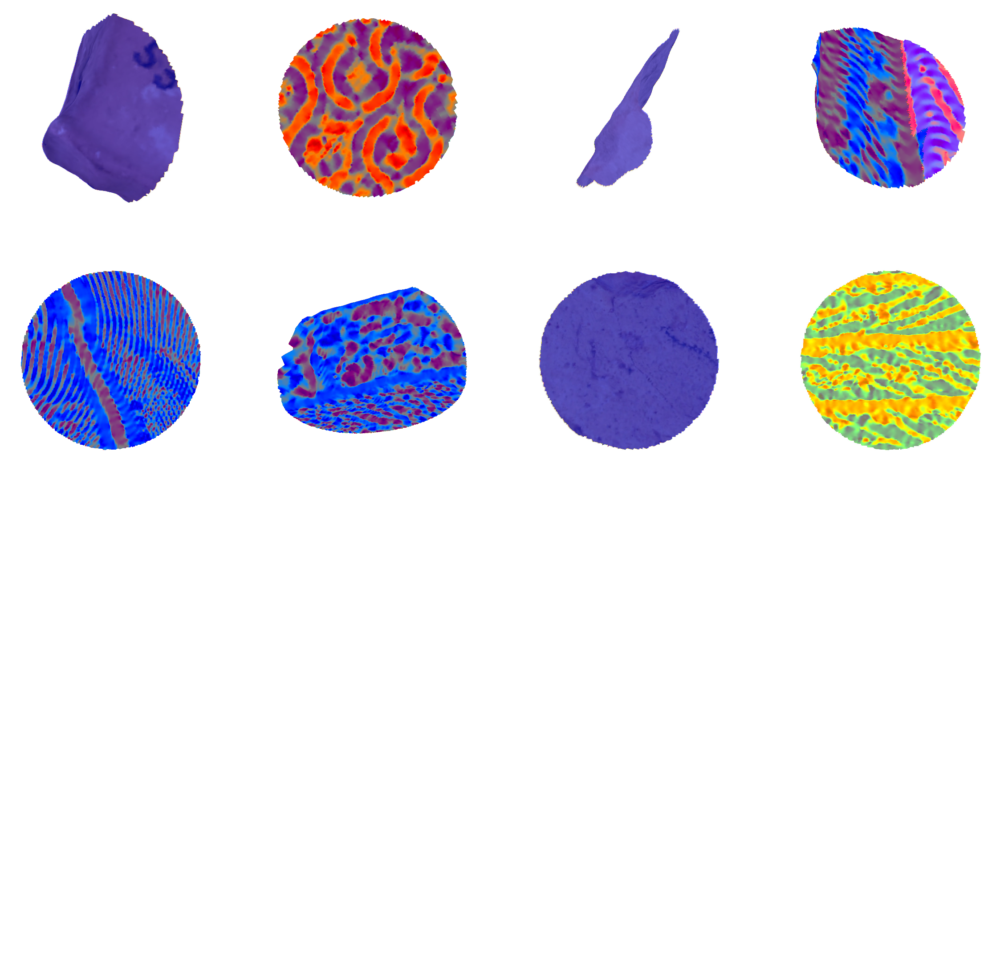

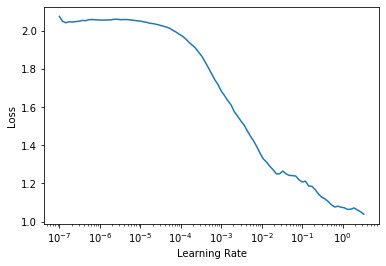

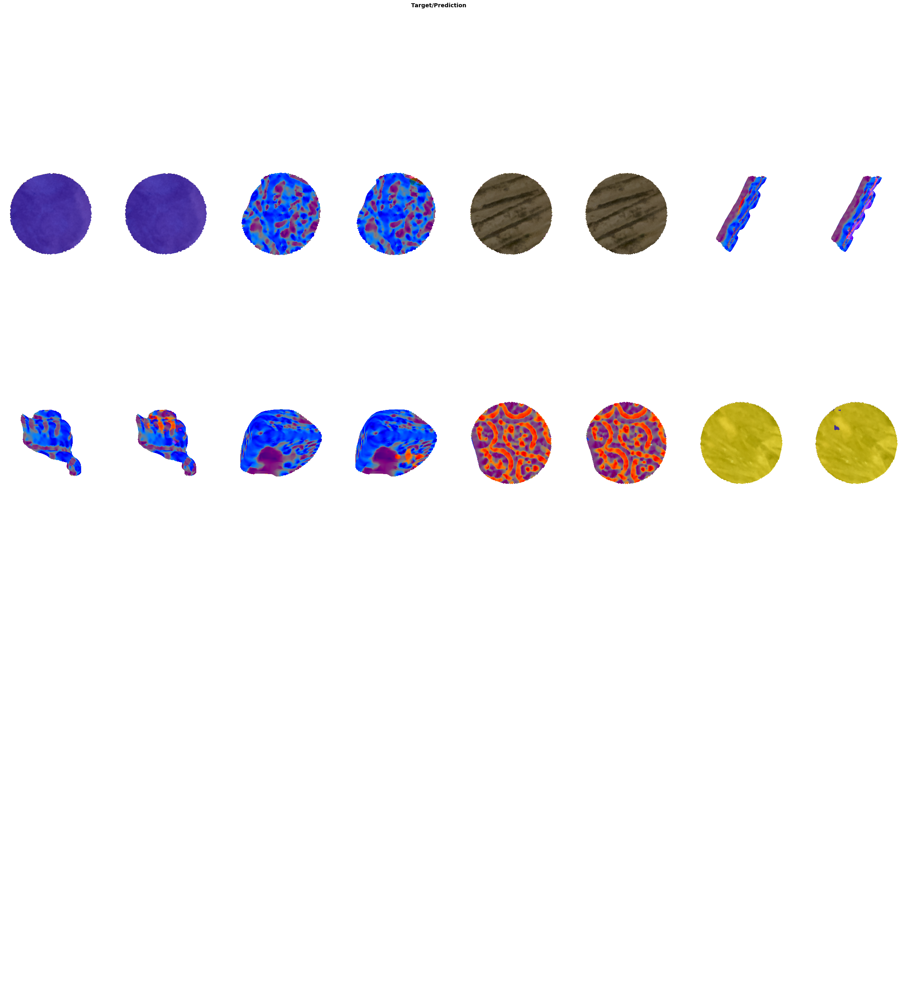

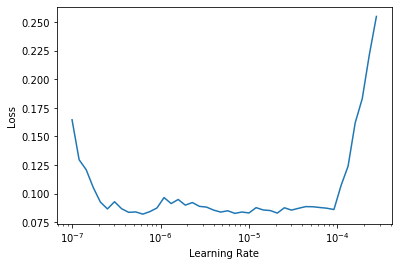

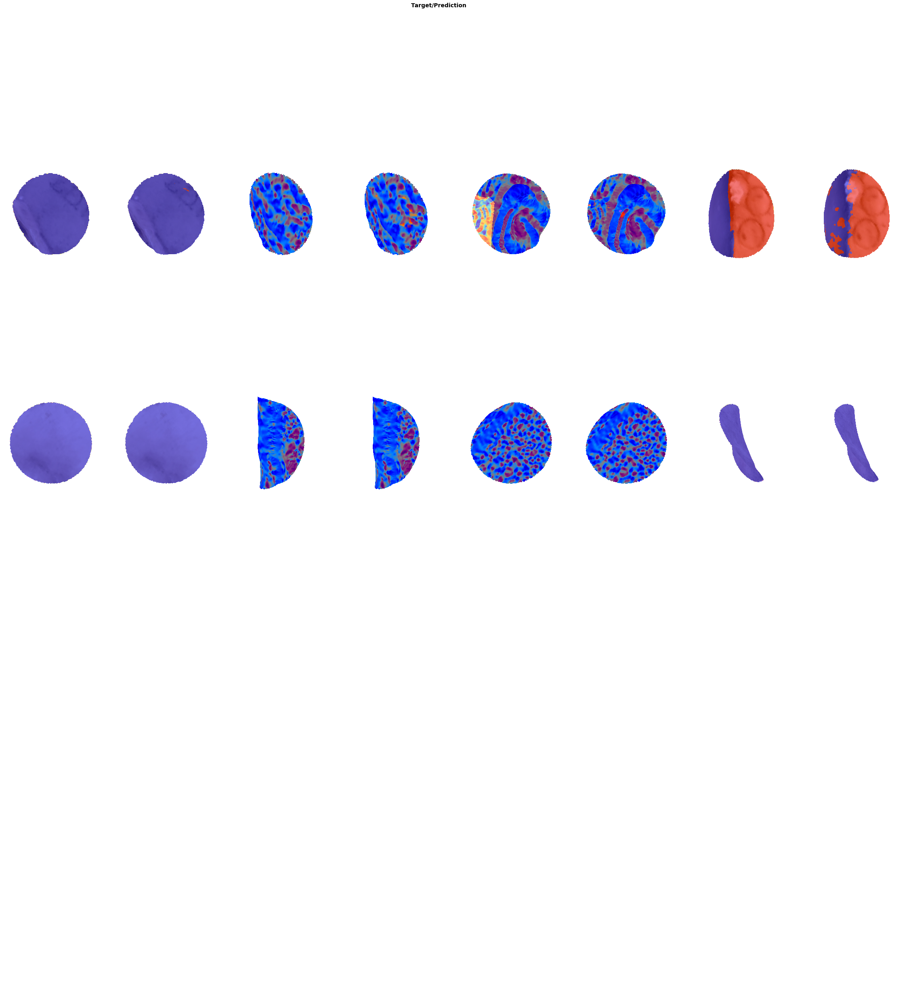

In [52]:
do_training_round(env, learn, epochs=100)

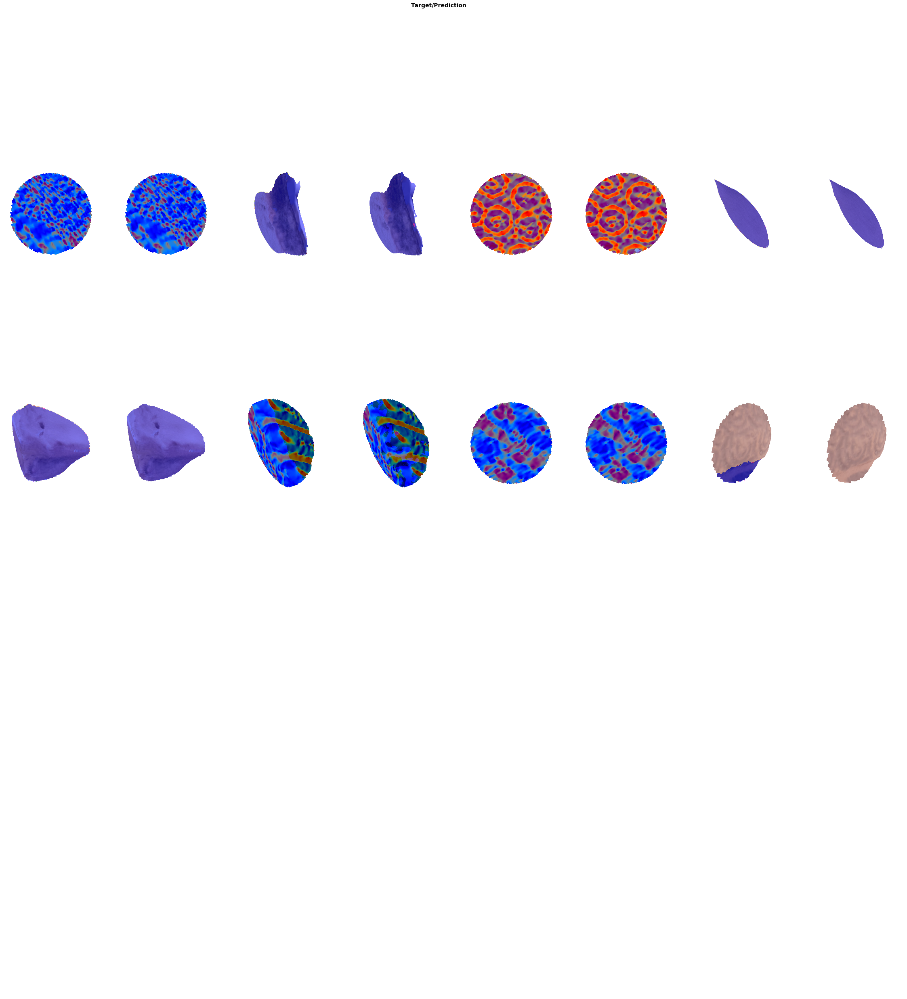

In [53]:
show_results(env, learn)

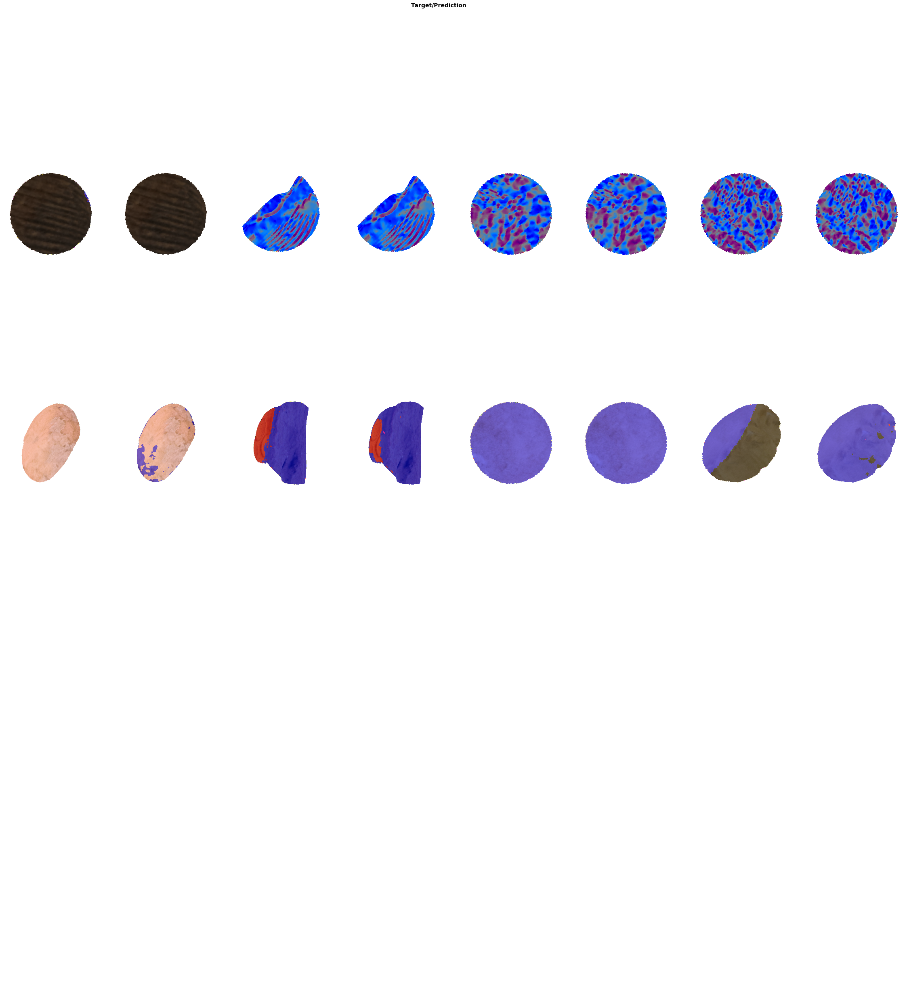

In [54]:
show_results(env, learn)

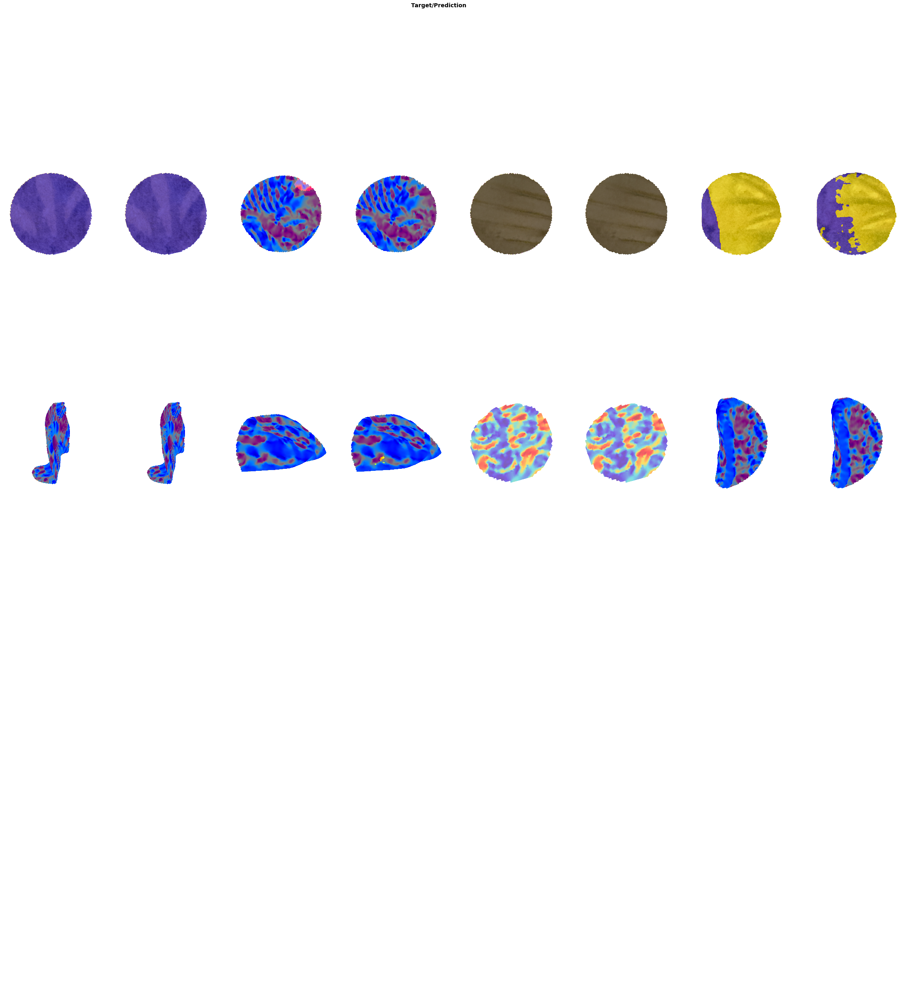

In [55]:
show_results(env, learn)

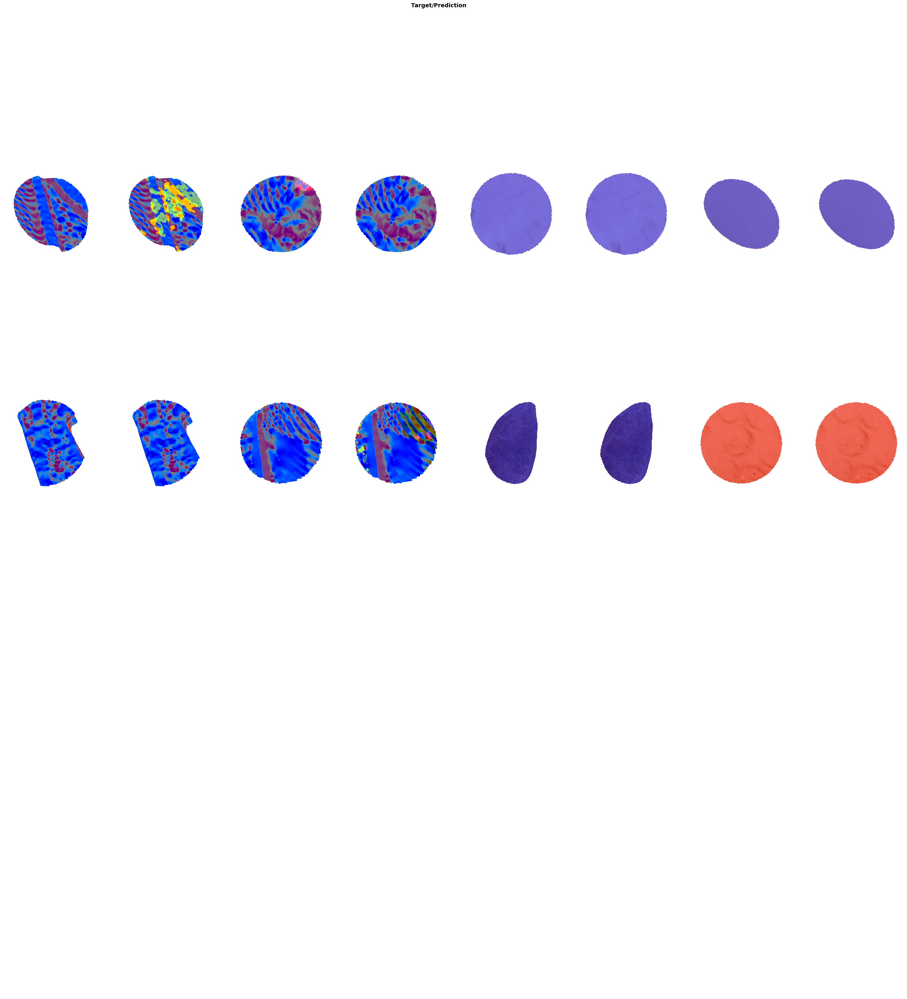

In [56]:
show_results(env, learn)

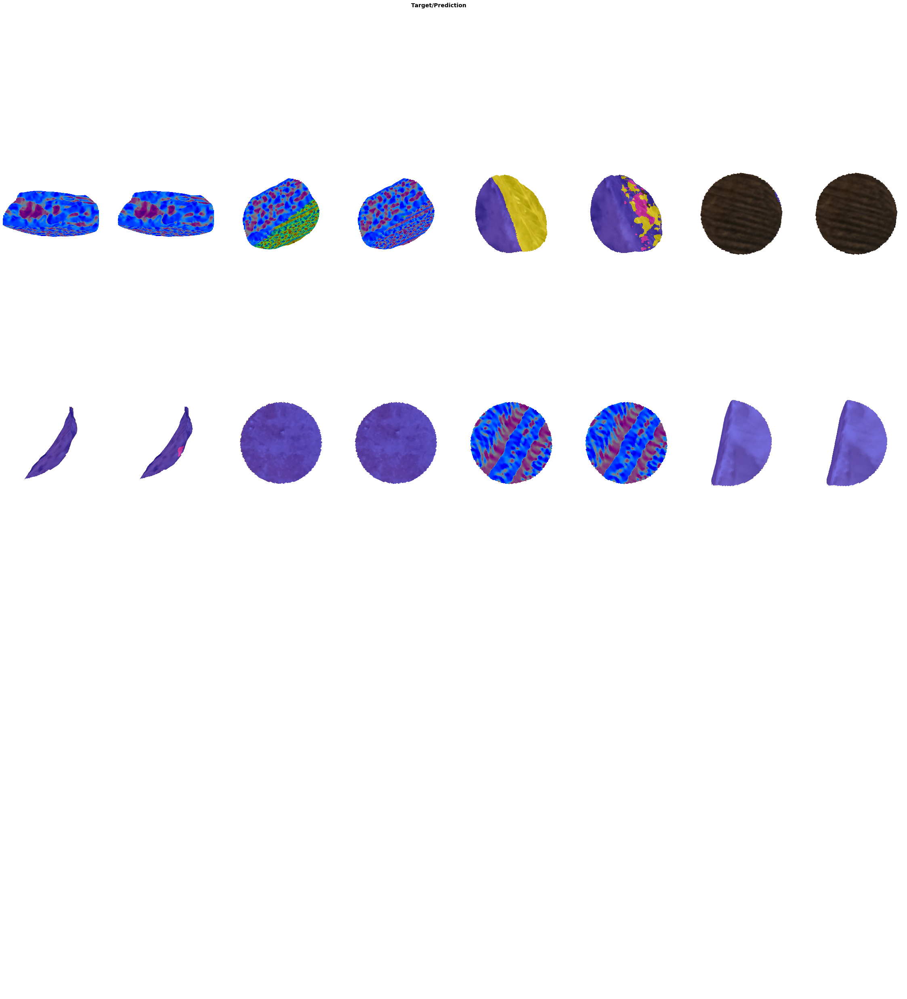

In [57]:
show_results(env, learn)

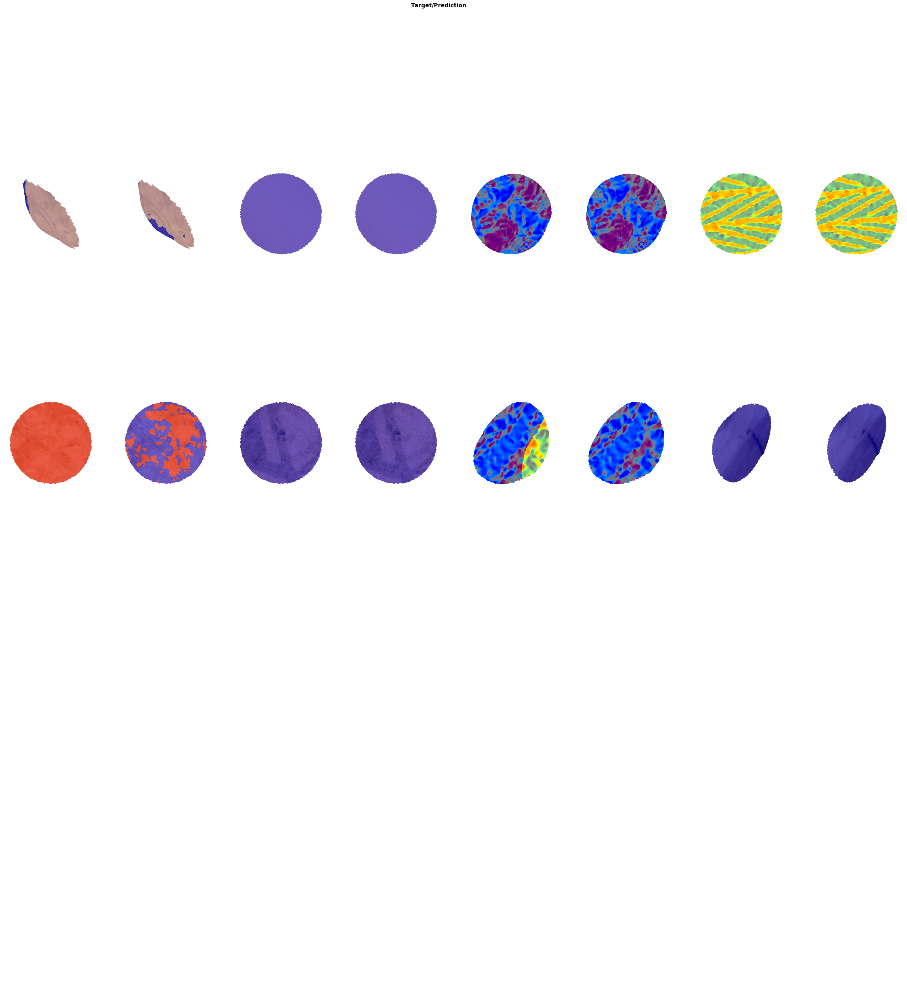

In [58]:
show_results(env, learn)

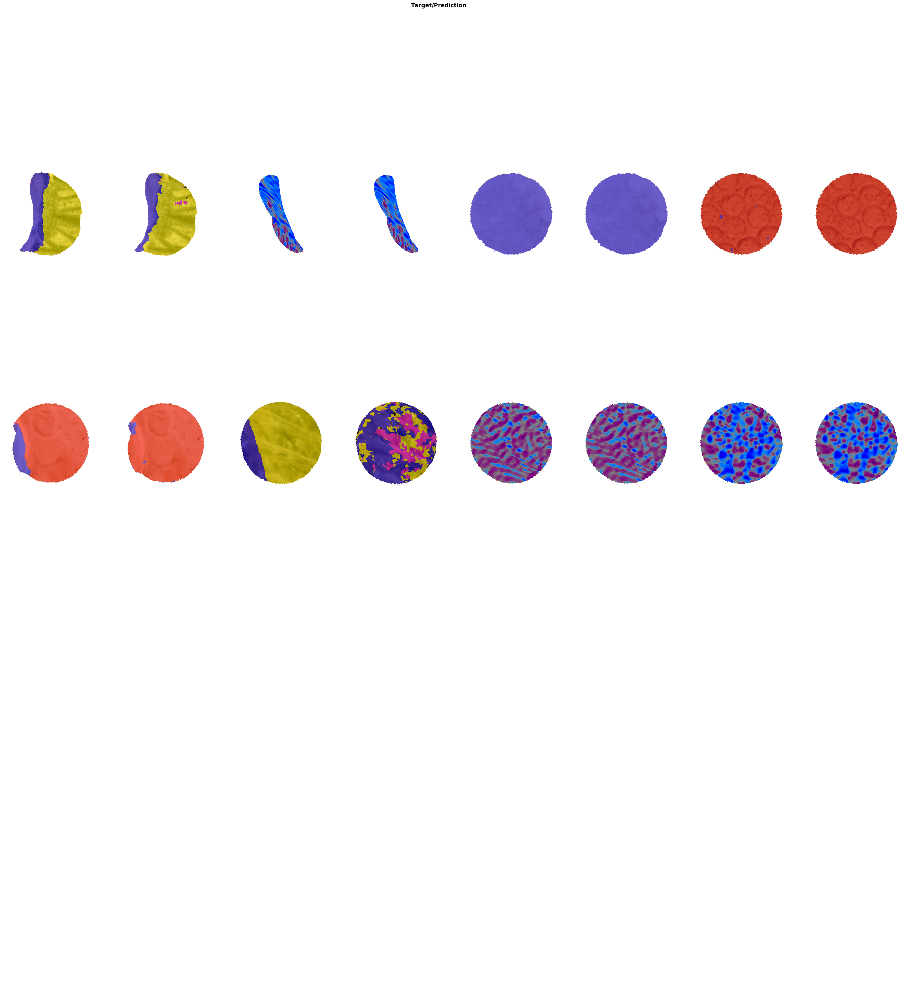

In [59]:
show_results(env, learn)

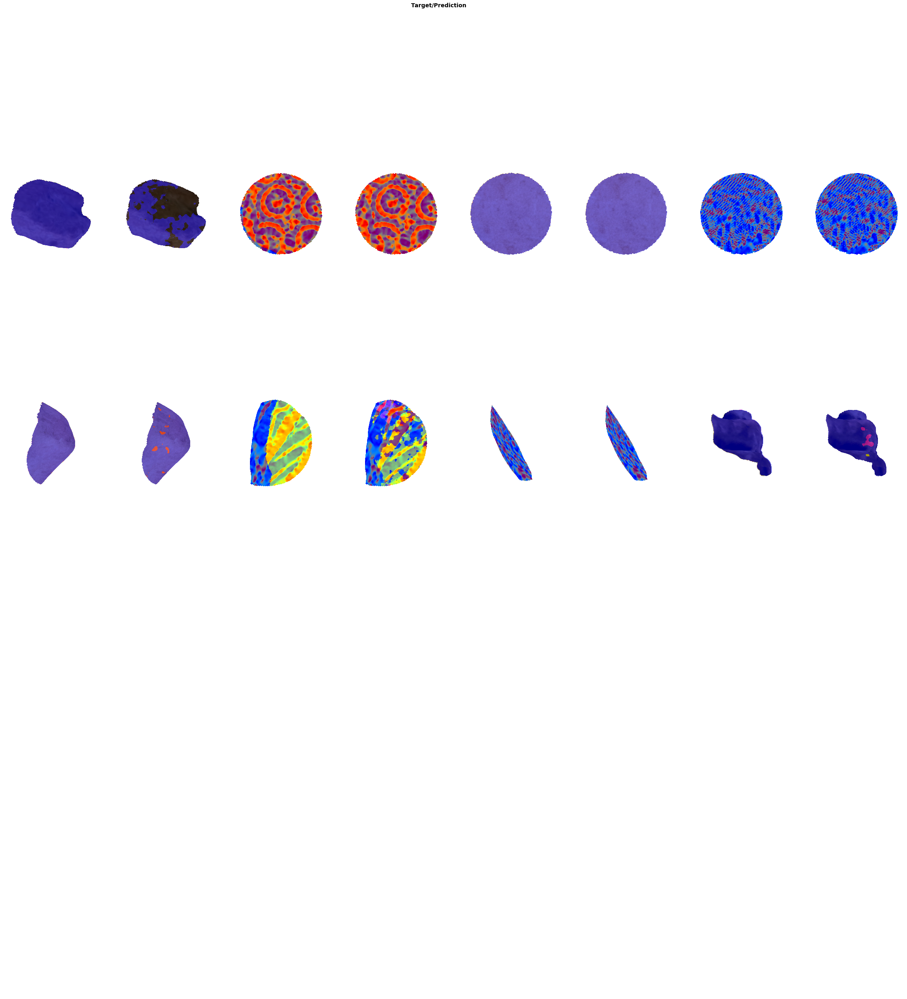

In [60]:
show_results(env, learn)

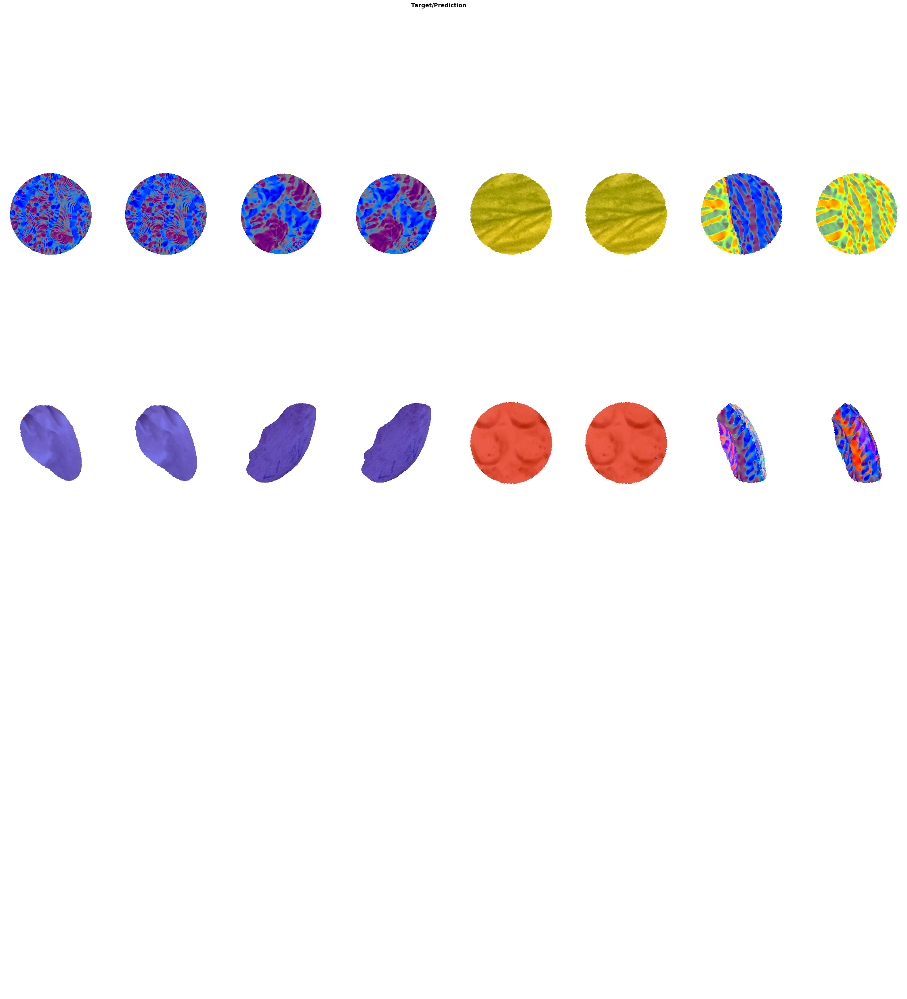

In [61]:
show_results(env, learn)

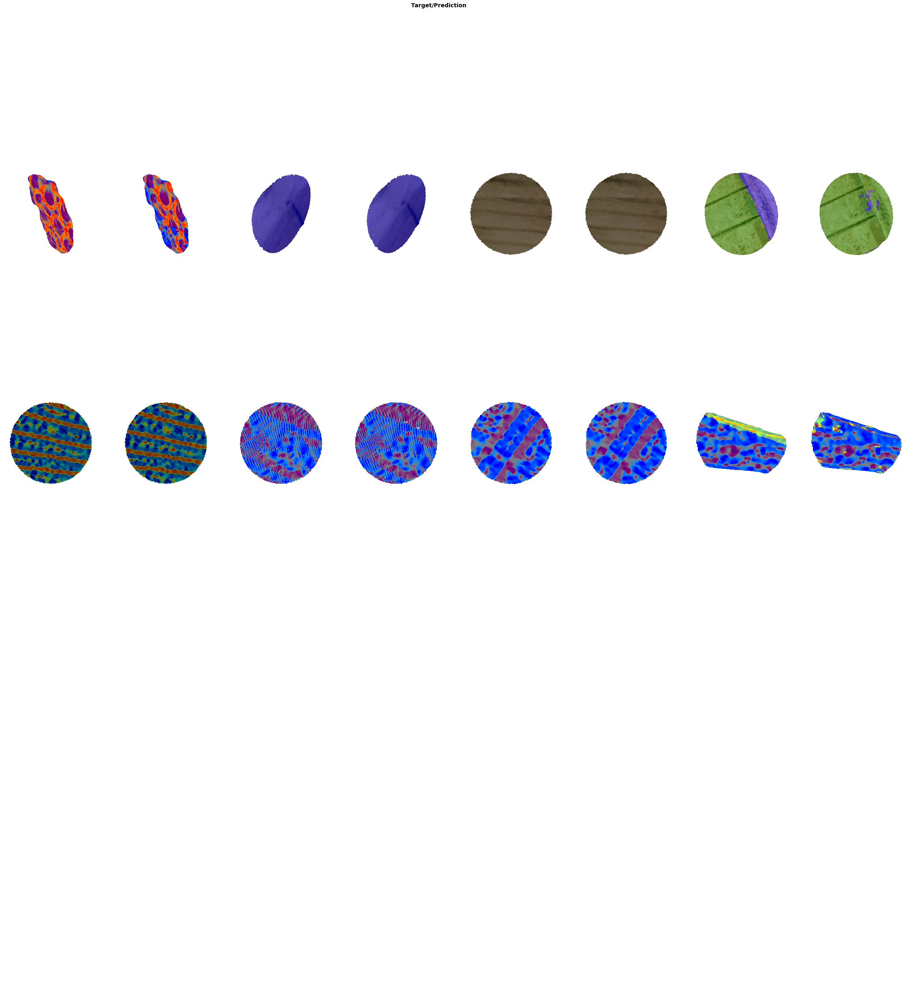

In [62]:
show_results(env, learn)

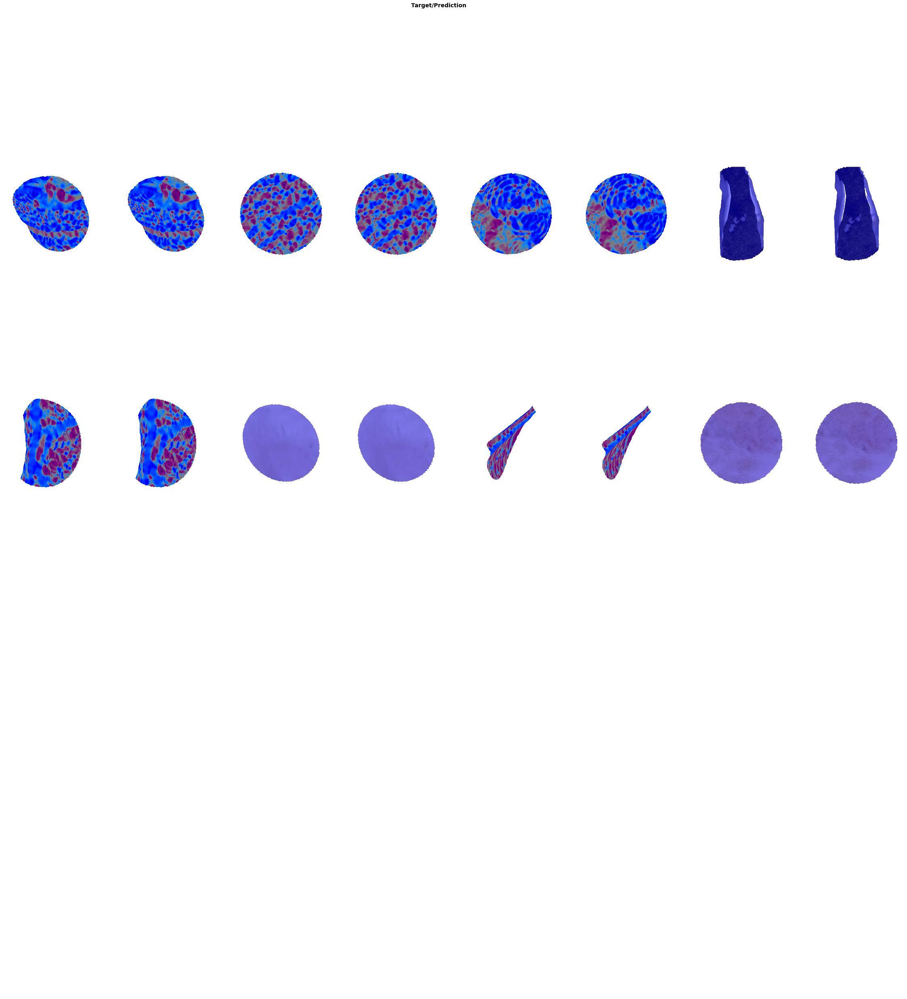

In [63]:
show_results(env, learn)

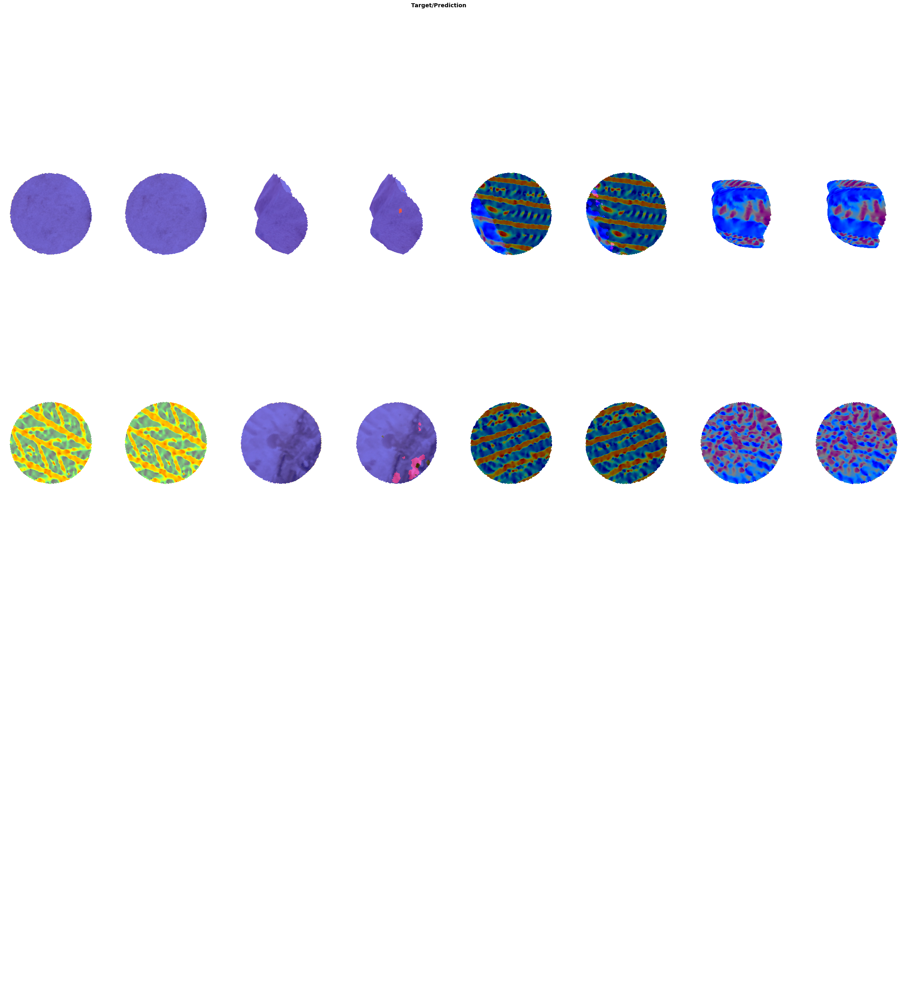

In [64]:
show_results(env, learn)

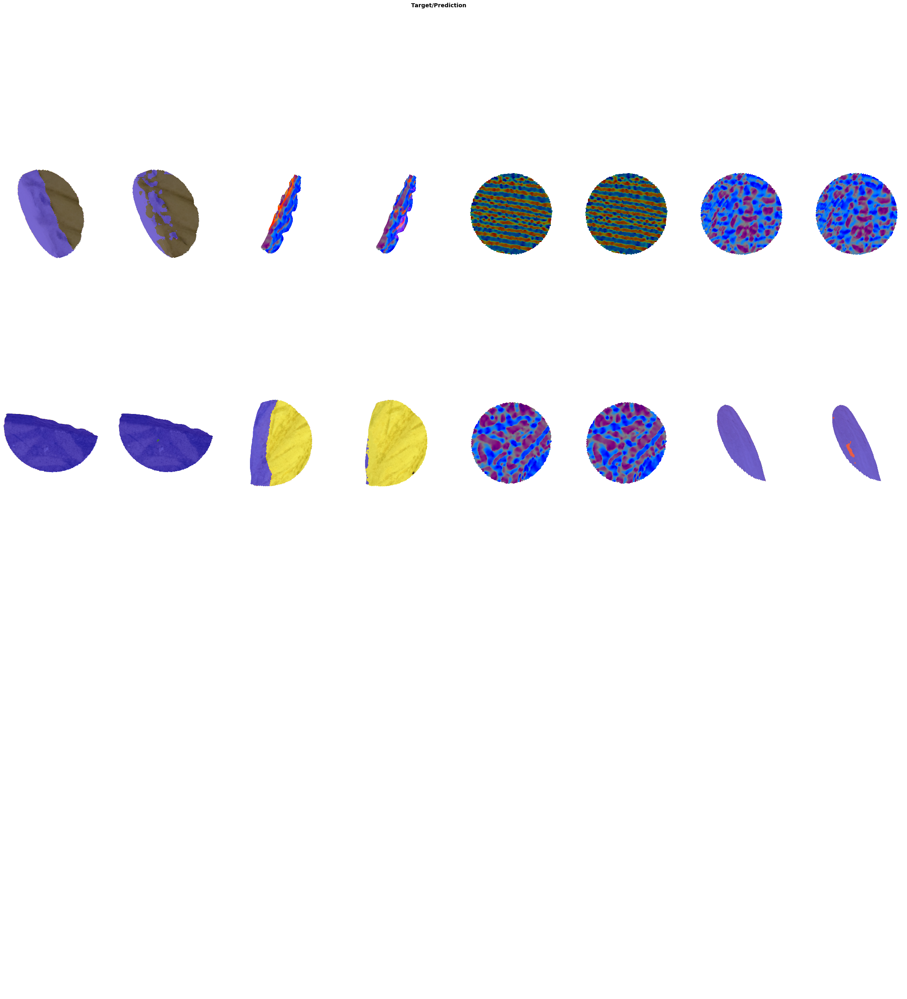

In [65]:
show_results(env, learn)

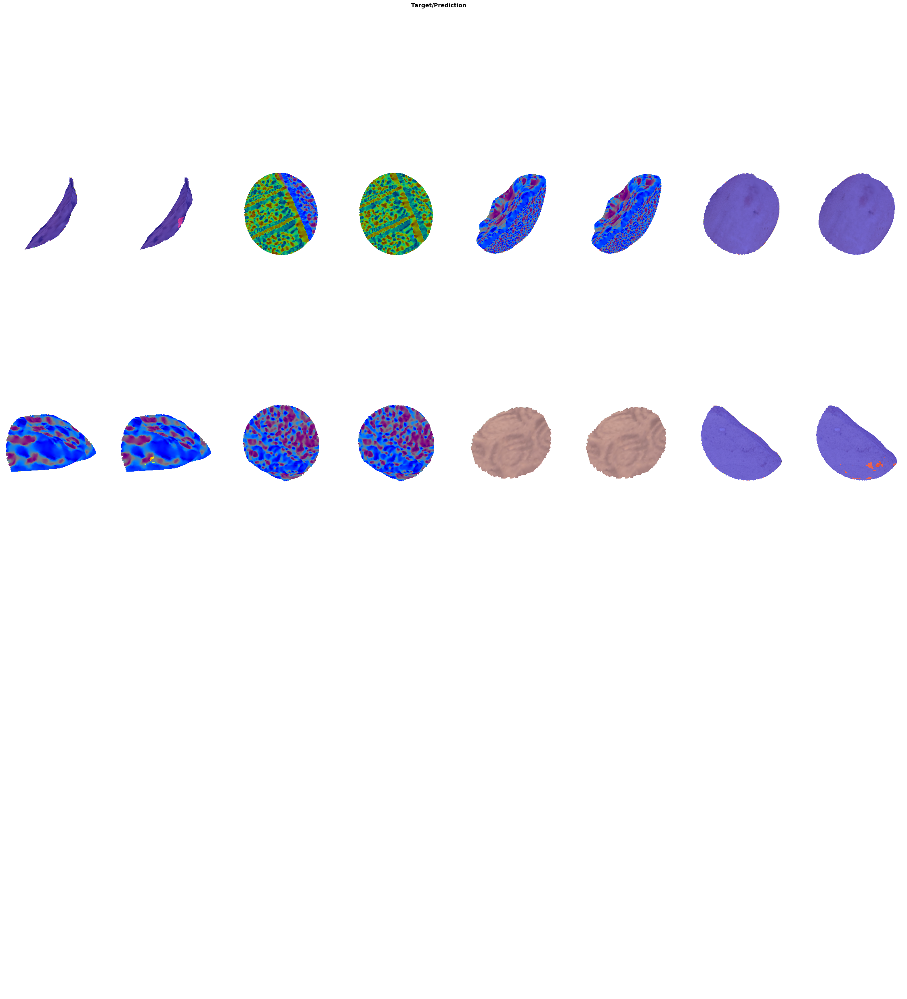

In [66]:
show_results(env, learn)

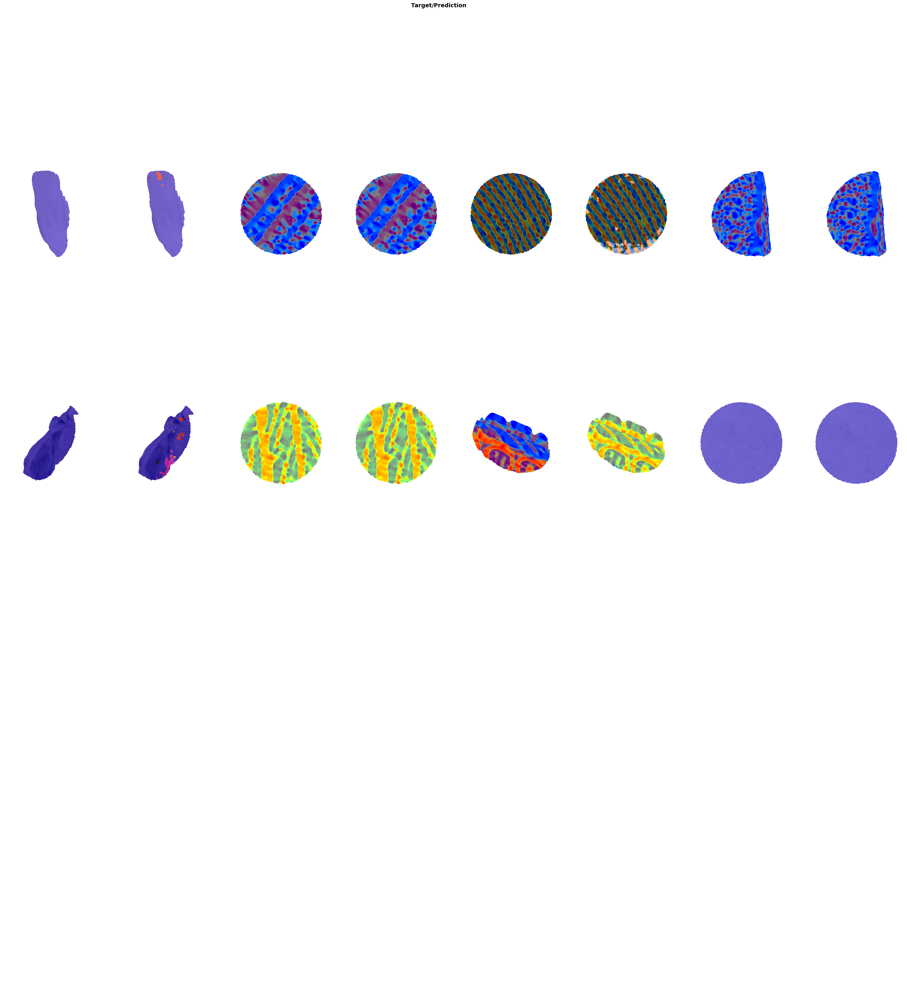

In [67]:
show_results(env, learn)

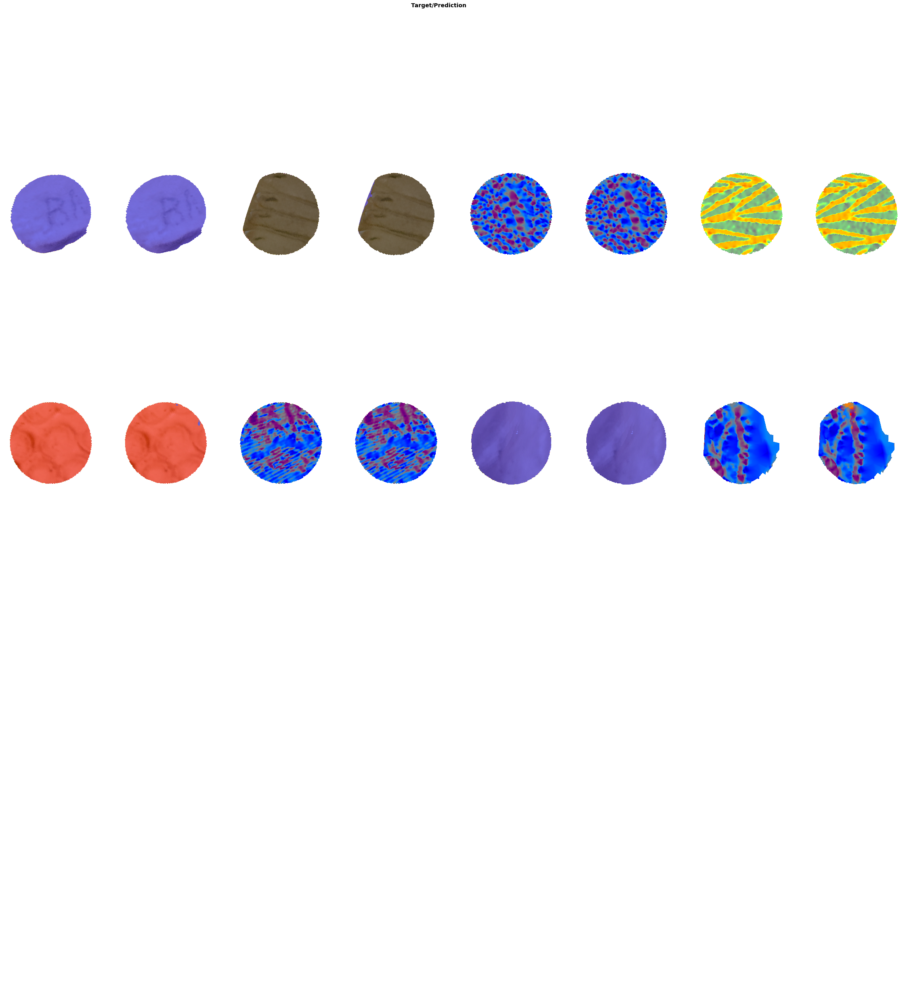

In [68]:
show_results(env, learn)

# Basic Data Aug

Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1554x1503
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/11_15-si.png
    applying PILBase.create gives
      PILMask mode=RGB size=1554x1503

Final sample: (PILImage mode=RGB size=1554x1503, PILMask mode=RGB size=

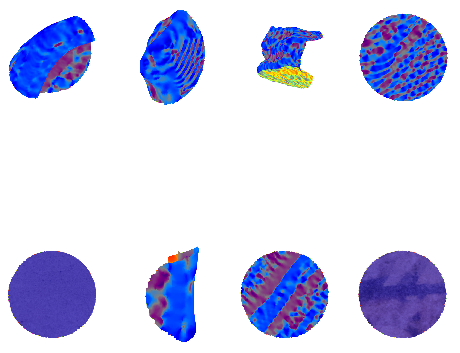

In [69]:
learn = init_learner(env)

## Round 1

------------------------------------
Running with basic data augmentation
------------------------------------
Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1554x1503
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/11_15-si.png
    applying PILBase.create gives

Fri Sep 24 00:03:30 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   43C    P0    40W / 250W |  31127MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.560214,0.489445,0.000000,0.227462,0.274918,0.248070,22:08
1,0.487806,0.419315,0.033262,0.256950,0.345166,0.265935,22:15
2,0.464763,0.408084,0.046675,0.268484,0.329887,0.274277,22:15
3,0.425788,0.393207,0.110226,0.293520,0.439021,0.306993,22:14
4,0.438126,0.380610,0.177788,0.355338,0.473426,0.348899,22:15
5,0.424183,0.380418,0.098407,0.297004,0.470458,0.302430,22:20
6,0.399743,0.357407,0.161688,0.369429,0.511544,0.350732,22:14
7,0.433576,0.334254,0.144785,0.331649,0.498849,0.331099,22:17
8,0.402216,0.337404,0.198830,0.385223,0.490418,0.373447,22:15
9,0.399989,0.309231,0.238067,0.404298,0.469055,0.407136,22:13


Better model found at epoch 0 with valid_loss value: 0.48944517970085144.
Better model found at epoch 0 with valid_loss value: 0.48944517970085144.


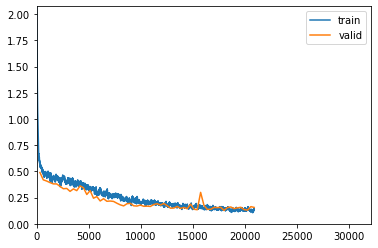

Better model found at epoch 1 with valid_loss value: 0.419315367937088.
Better model found at epoch 1 with valid_loss value: 0.419315367937088.
Better model found at epoch 2 with valid_loss value: 0.4080844521522522.
Better model found at epoch 2 with valid_loss value: 0.4080844521522522.
Better model found at epoch 3 with valid_loss value: 0.3932074308395386.
Better model found at epoch 3 with valid_loss value: 0.3932074308395386.
Better model found at epoch 4 with valid_loss value: 0.38061004877090454.
Better model found at epoch 4 with valid_loss value: 0.38061004877090454.
Better model found at epoch 5 with valid_loss value: 0.38041800260543823.
Better model found at epoch 5 with valid_loss value: 0.38041800260543823.
Better model found at epoch 6 with valid_loss value: 0.35740676522254944.
Better model found at epoch 6 with valid_loss value: 0.35740676522254944.
Better model found at epoch 7 with valid_loss value: 0.3342544436454773.
Better model found at epoch 7 with valid_loss v

Looking for SURFpatt_v3alpha-RGB+SI-patch-radius-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_14.46.24-WD-0.0001-BS-8-LR-0.0022908675670623778-0.02290867567062378-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-0.00010000000149011613-0.0010000000149011613-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-2.0892961401841603e-08-2.08929614018416e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-22_16.23.32-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpa

0 - valid_loss = 0.12733450531959534
1 - surfpatt_metric = 0.5908914804458618
2 - f-score = 0.7568793839781192
3 - precision = 0.8247489738406621
4 - recall = 0.7603899820702716
LR_finding in parallel_ctx context on GPU [0, 1]


Sat Sep 25 00:51:48 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   42C    P0    45W / 250W |  31211MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.133520,0.132465,0.585227,0.758190,0.832114,0.755273,23:16
1,0.133376,0.141472,0.577853,0.746433,0.803088,0.749586,23:26
2,0.132242,0.135864,0.579649,0.744264,0.813238,0.752477,23:18
3,0.129497,0.131009,0.589284,0.754938,0.809351,0.759235,23:21
4,0.125682,0.133200,0.595983,0.756698,0.814369,0.763689,23:15
5,0.132557,0.133672,0.587530,0.753011,0.811369,0.758778,23:20
6,0.121897,0.129480,0.586680,0.751713,0.809794,0.759480,23:22
7,0.124946,0.136127,0.581291,0.745095,0.799759,0.754475,23:16
8,0.142513,0.128300,0.587634,0.756736,0.823536,0.756790,23:20
9,0.129851,0.129469,0.588623,0.760236,0.834485,0.758567,23:22


Better model found at epoch 0 with valid_loss value: 0.1324649304151535.
Better model found at epoch 0 with valid_loss value: 0.1324649304151535.


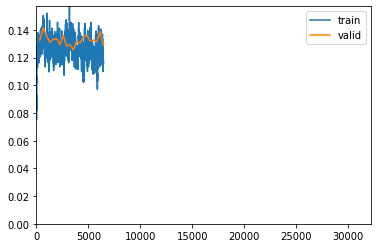

Better model found at epoch 3 with valid_loss value: 0.13100911676883698.
Better model found at epoch 3 with valid_loss value: 0.13100911676883698.
Better model found at epoch 6 with valid_loss value: 0.12948034703731537.
Better model found at epoch 6 with valid_loss value: 0.12948034703731537.
Better model found at epoch 8 with valid_loss value: 0.12830018997192383.
Better model found at epoch 8 with valid_loss value: 0.12830018997192383.
Better model found at epoch 10 with valid_loss value: 0.12556692957878113.
Better model found at epoch 10 with valid_loss value: 0.12556692957878113.
No improvement since epoch 10: early stopping
Sat Sep 25 09:02:32 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  T

Looking for SURFpatt_v3alpha-RGB+SI-patch-radius-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_14.46.24-WD-0.0001-BS-8-LR-0.0022908675670623778-0.02290867567062378-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-0.00010000000149011613-0.0010000000149011613-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-2.0892961401841603e-08-2.08929614018416e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-22_16.23.32-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpa

0 - valid_loss = 0.125567227602005
1 - surfpatt_metric = 0.5810757875442505
2 - f-score = 0.7575404151098778
3 - precision = 0.8352783886626889
4 - recall = 0.7547960188838573


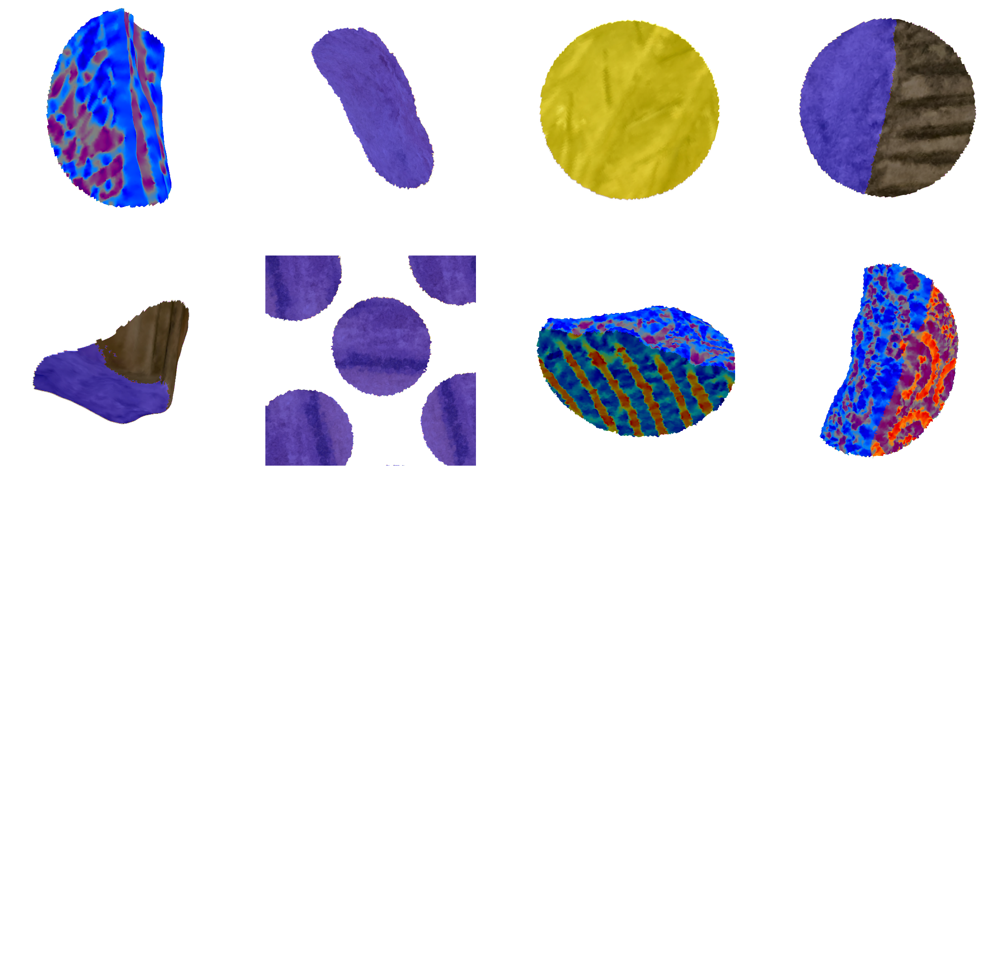

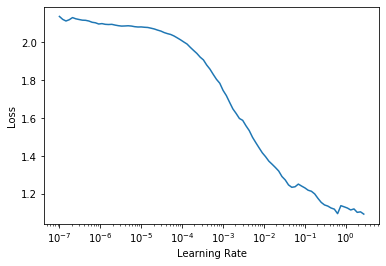

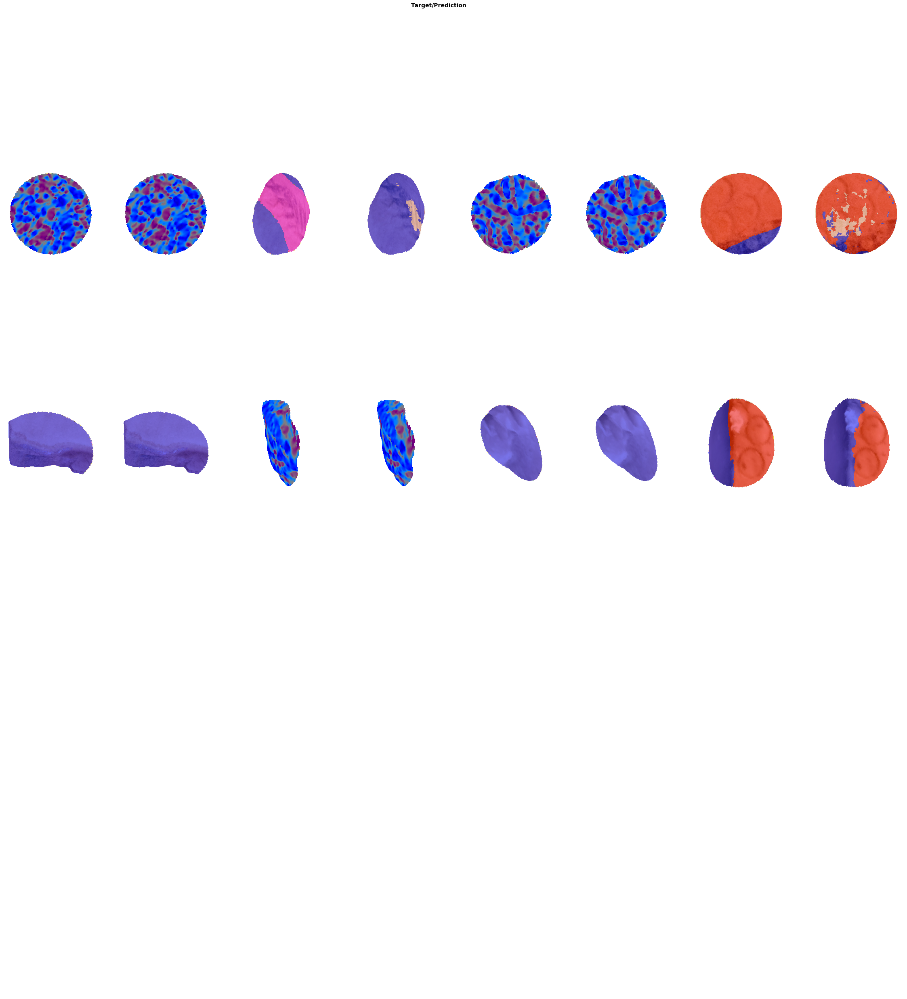

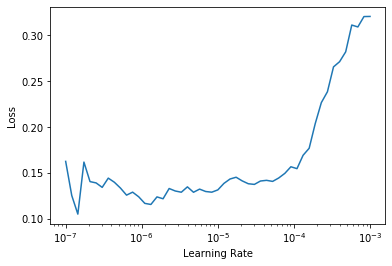

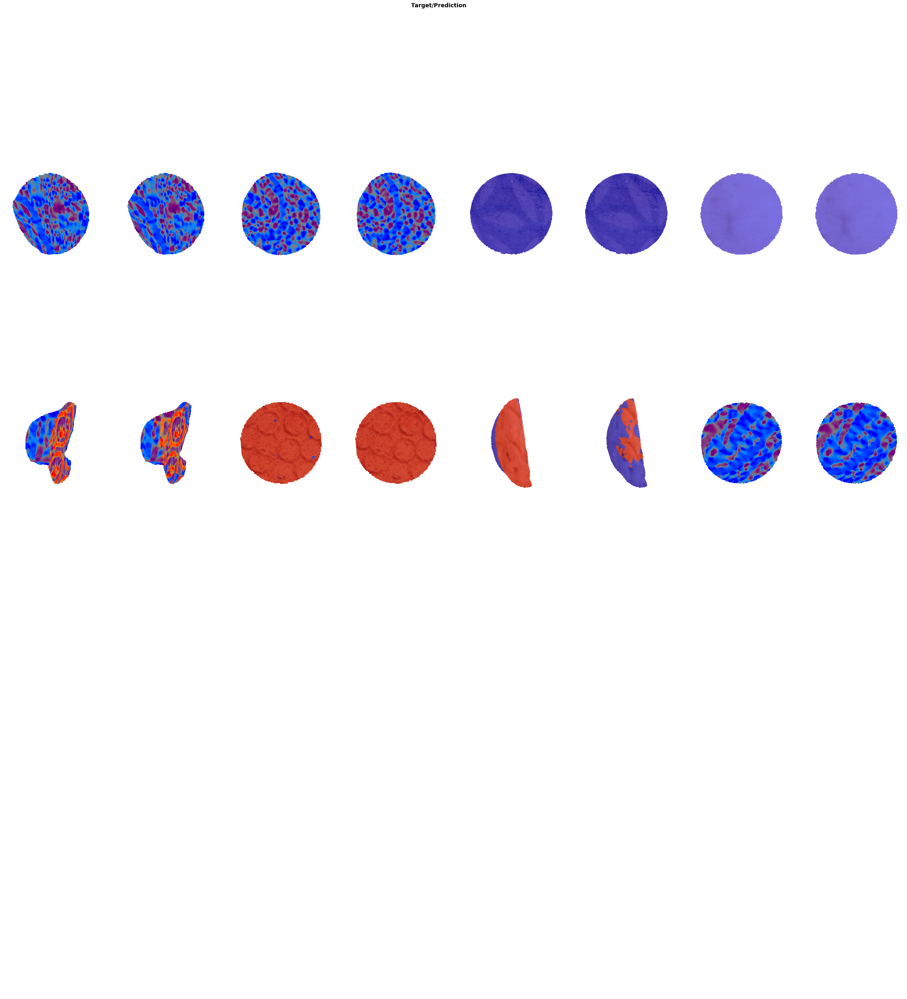

In [70]:
env['train_round']       = 0
env['data-augmentation'] = 'basic-data-aug'
do_training_round(env, learn, epochs=100)

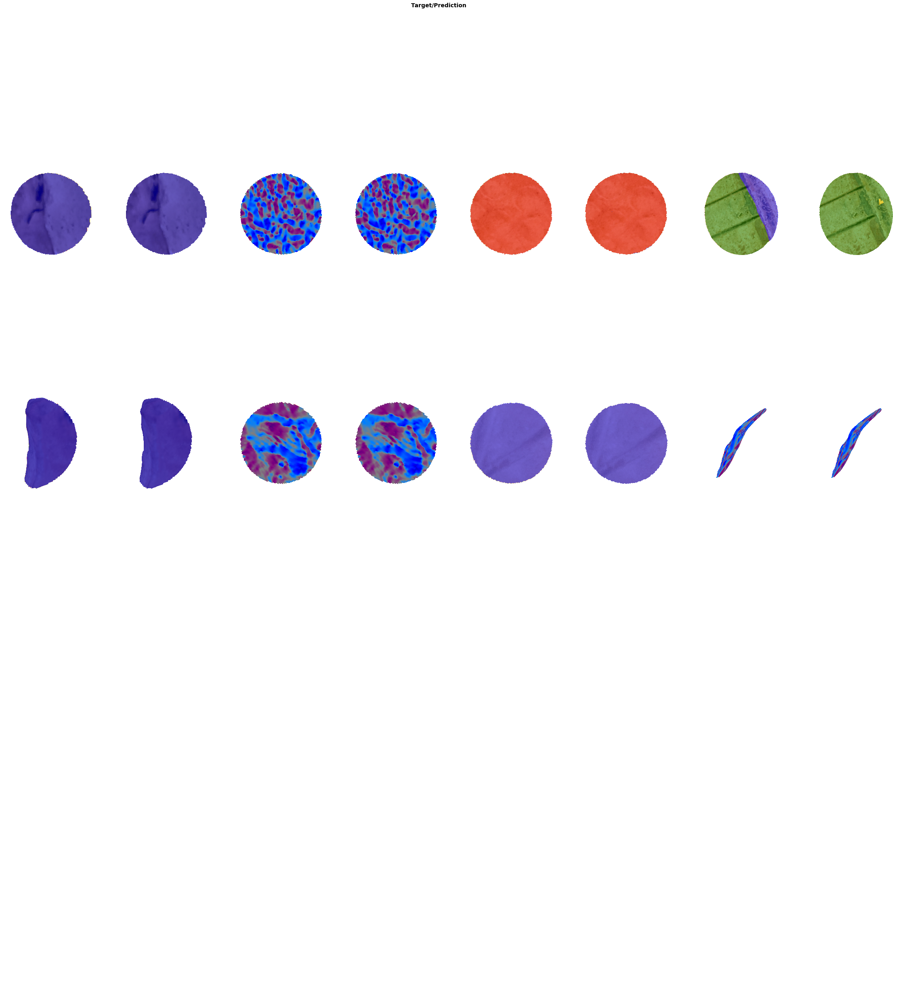

In [71]:
show_results(env, learn)

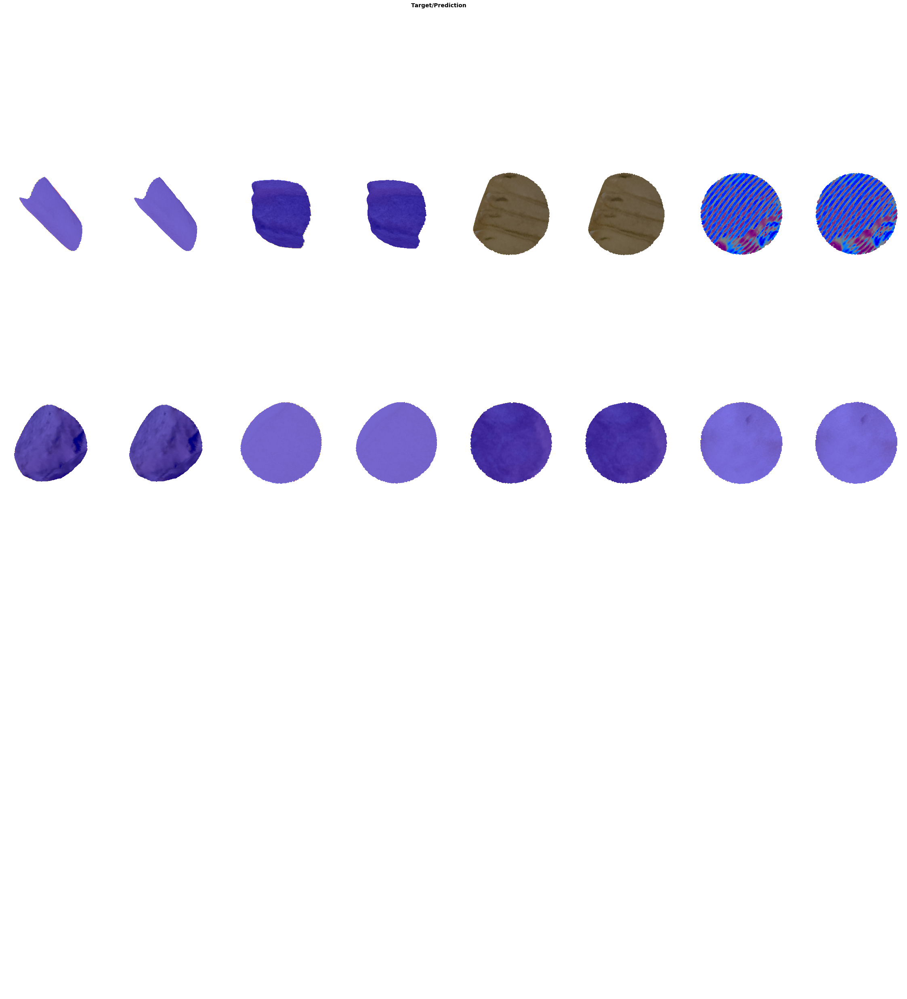

In [72]:
show_results(env, learn)

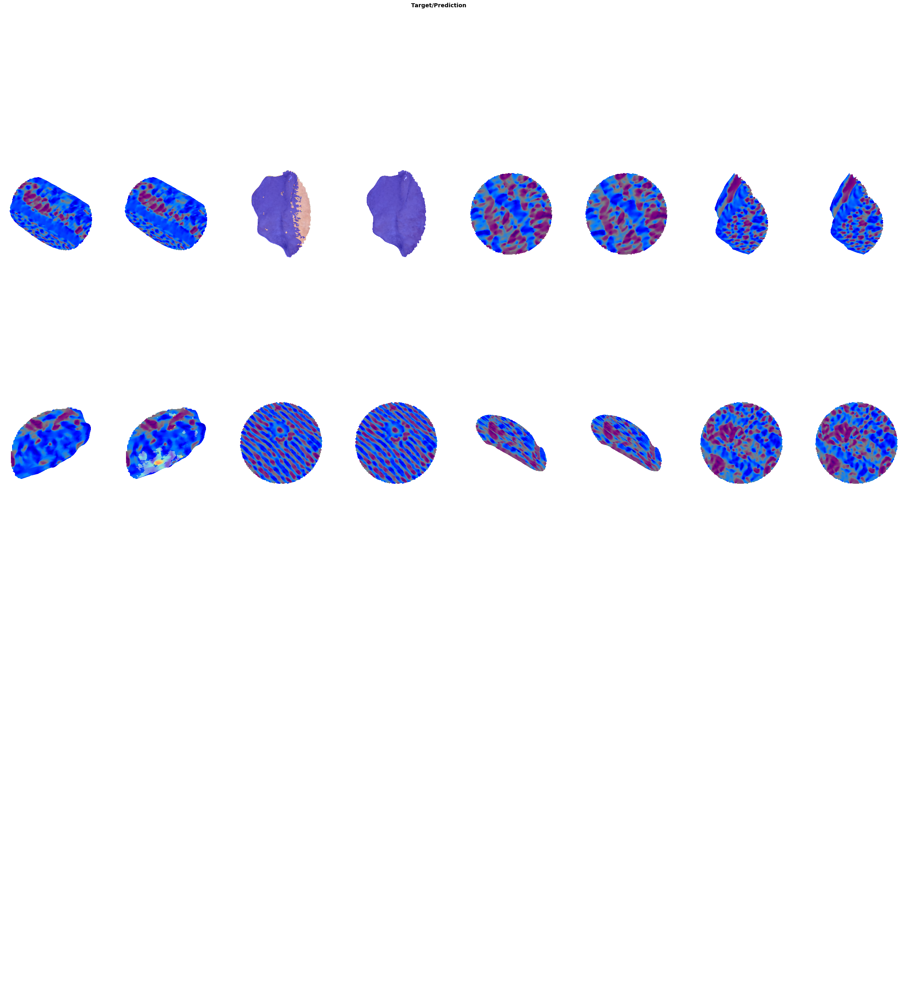

In [73]:
show_results(env, learn)

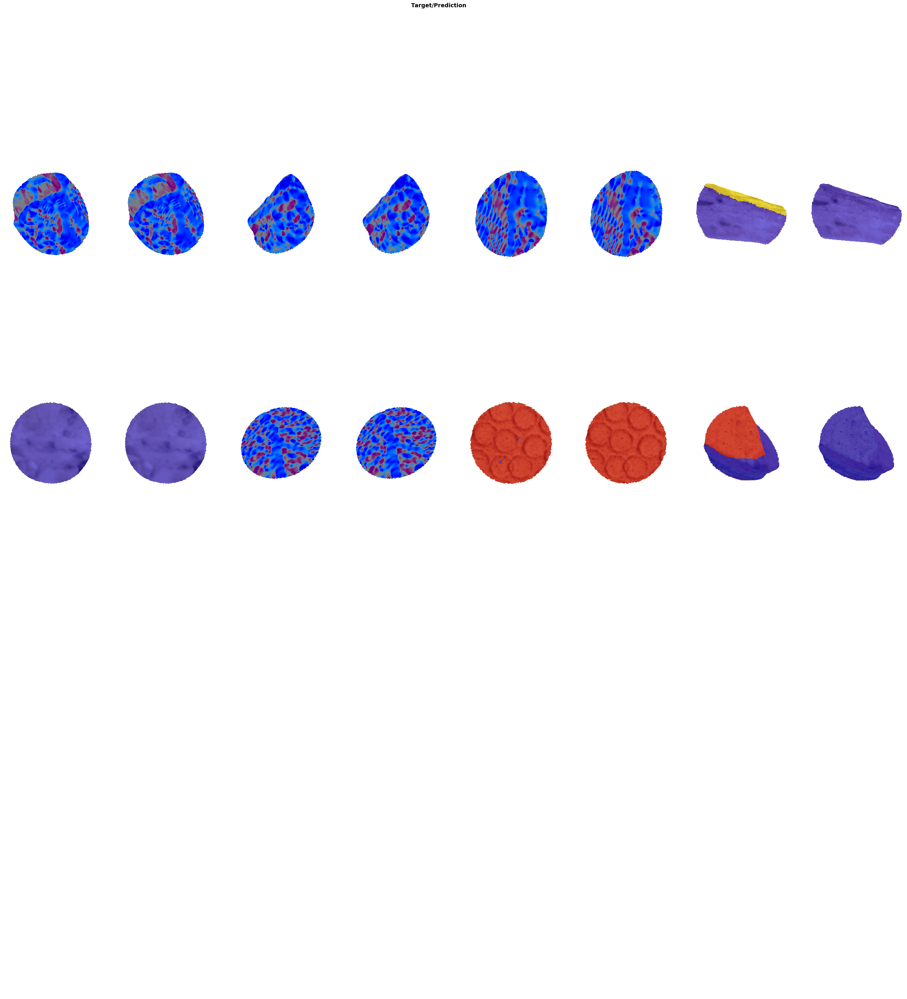

In [74]:
show_results(env, learn)

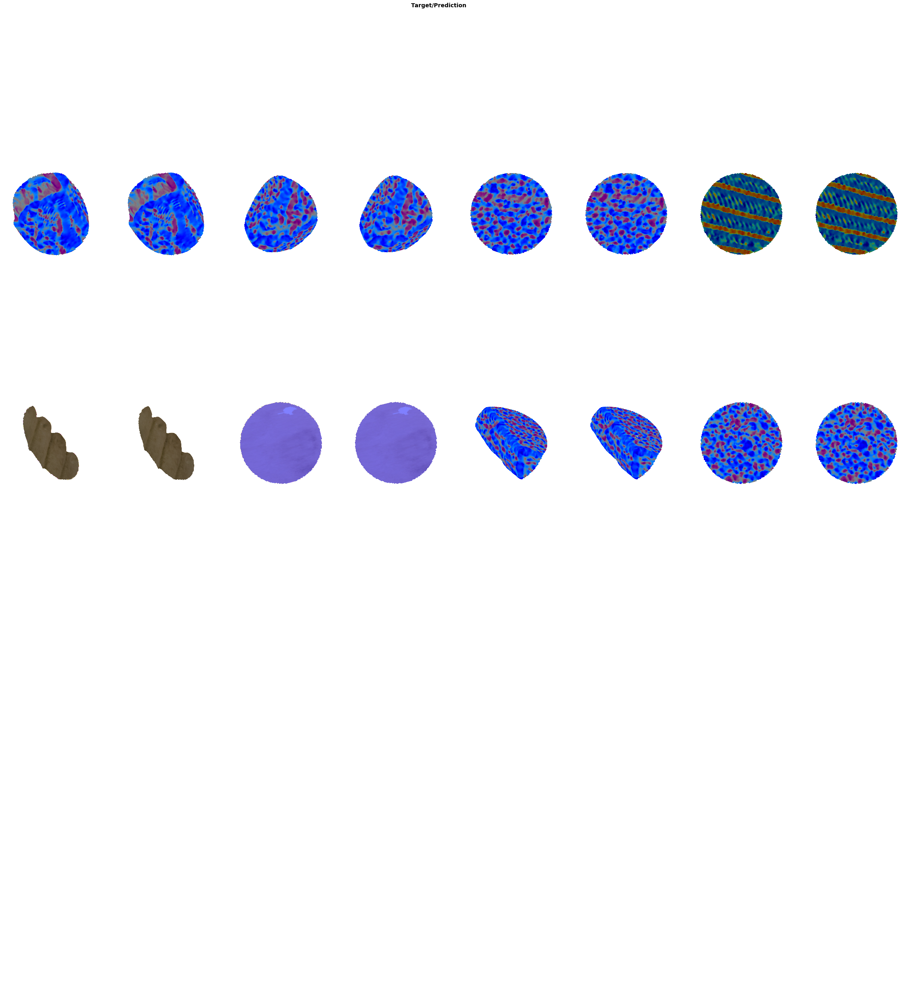

In [75]:
show_results(env, learn)

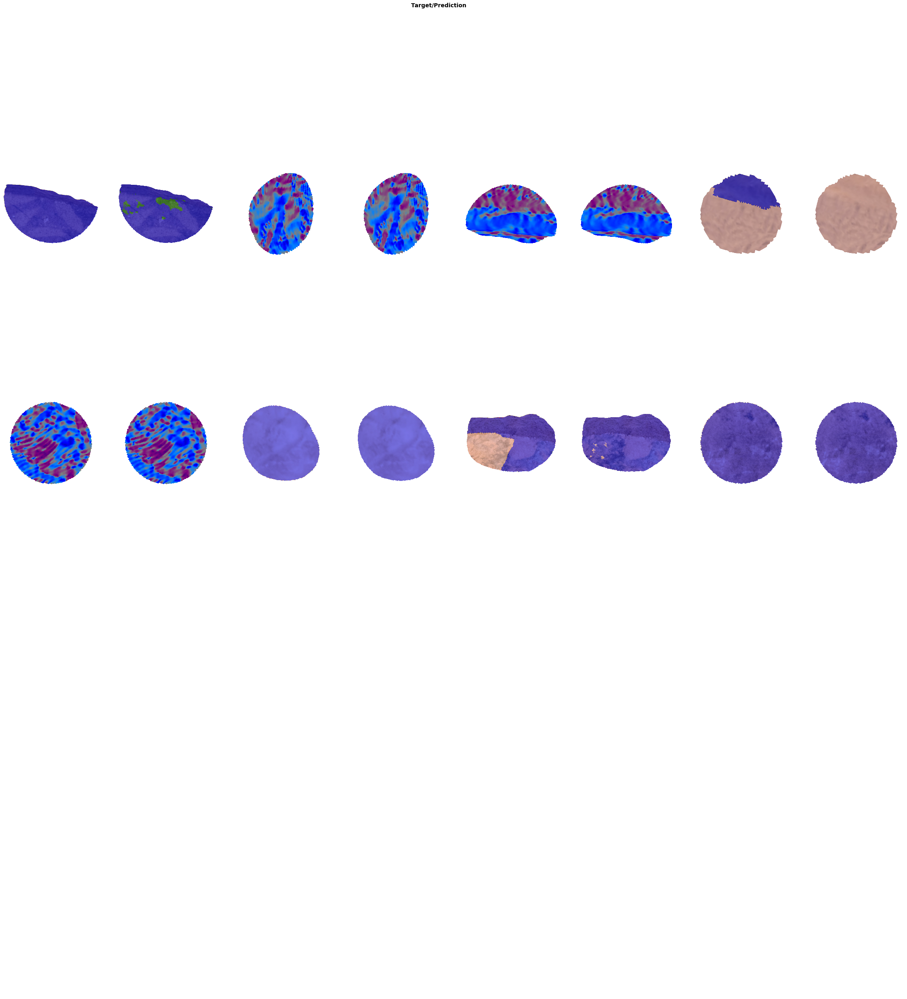

In [76]:
show_results(env, learn)

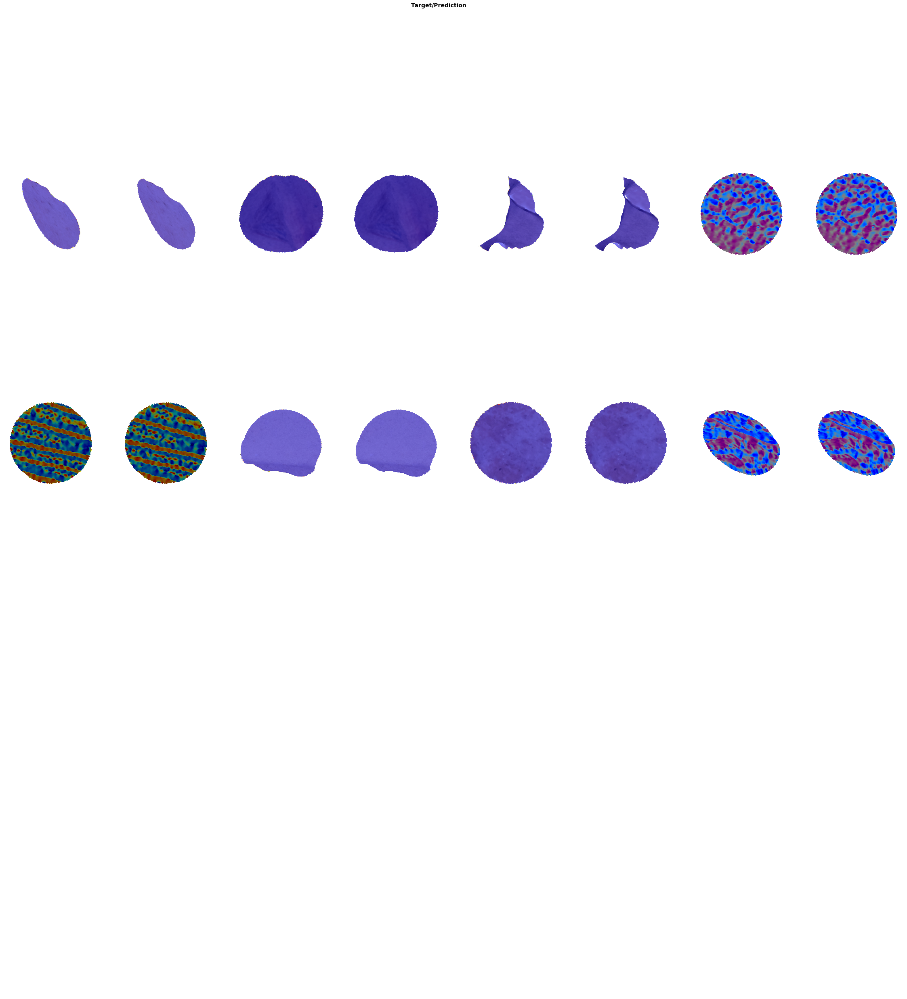

In [77]:
show_results(env, learn)

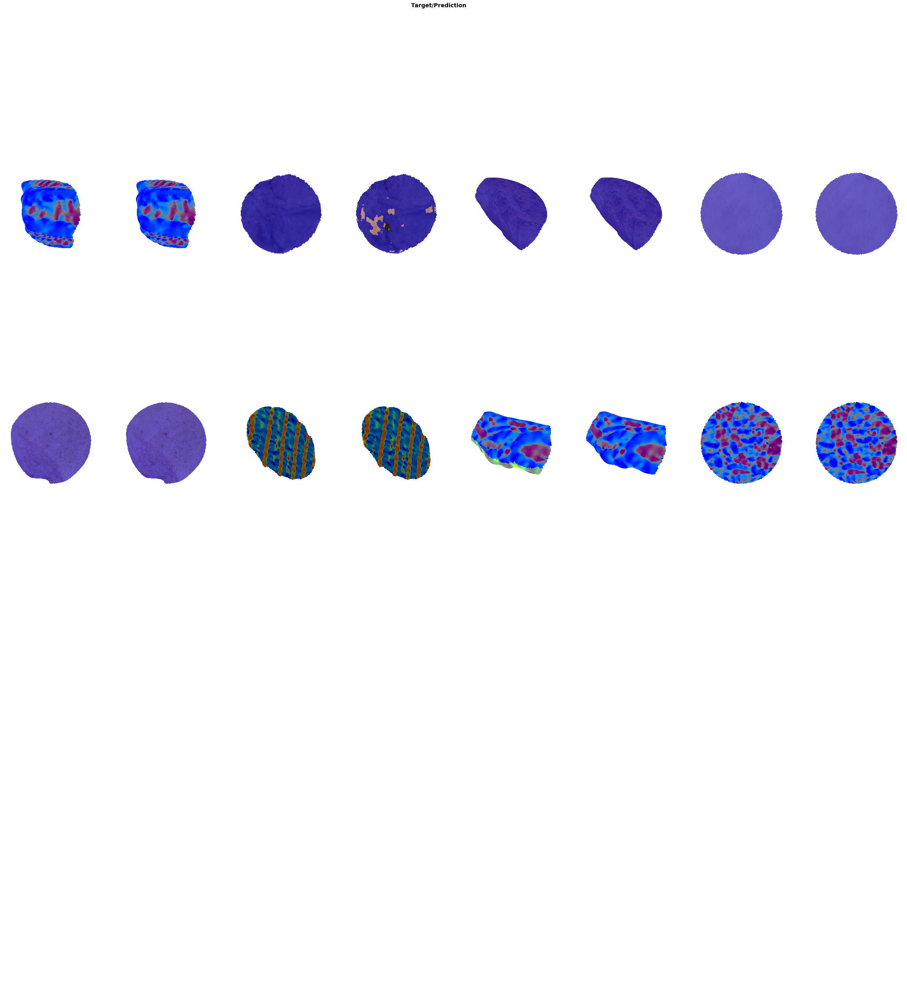

In [78]:
show_results(env, learn)

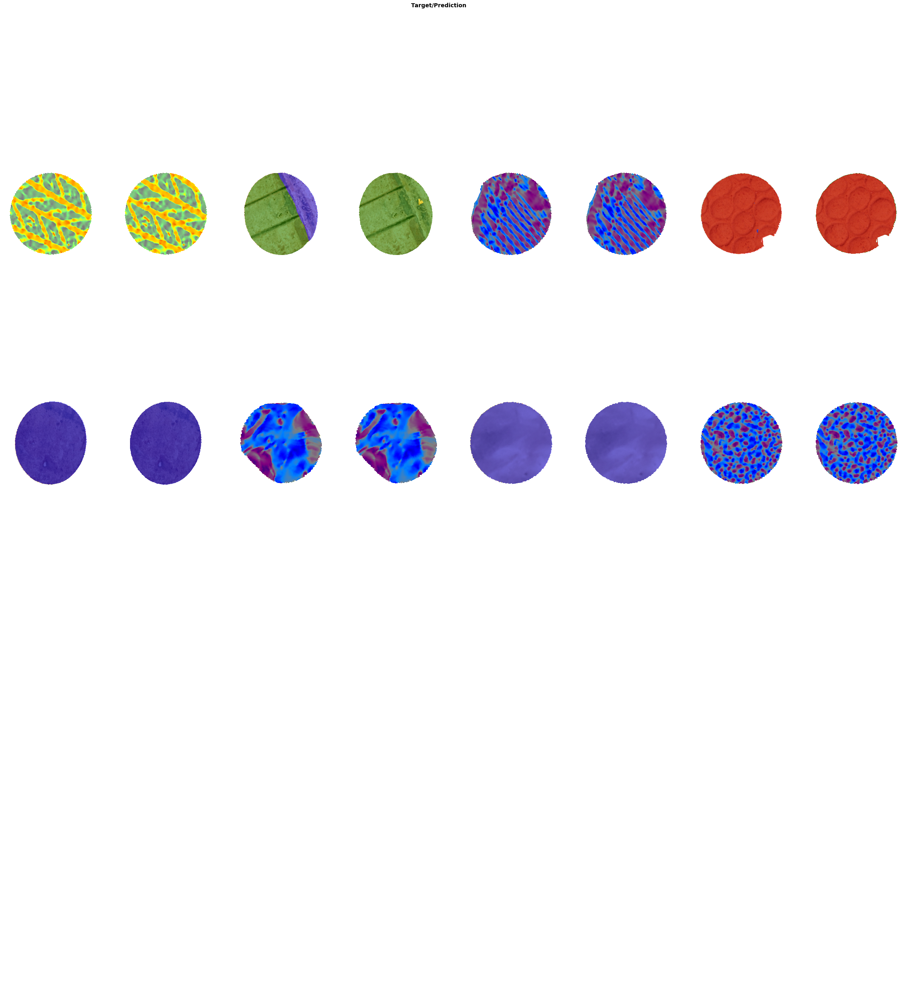

In [79]:
show_results(env, learn)

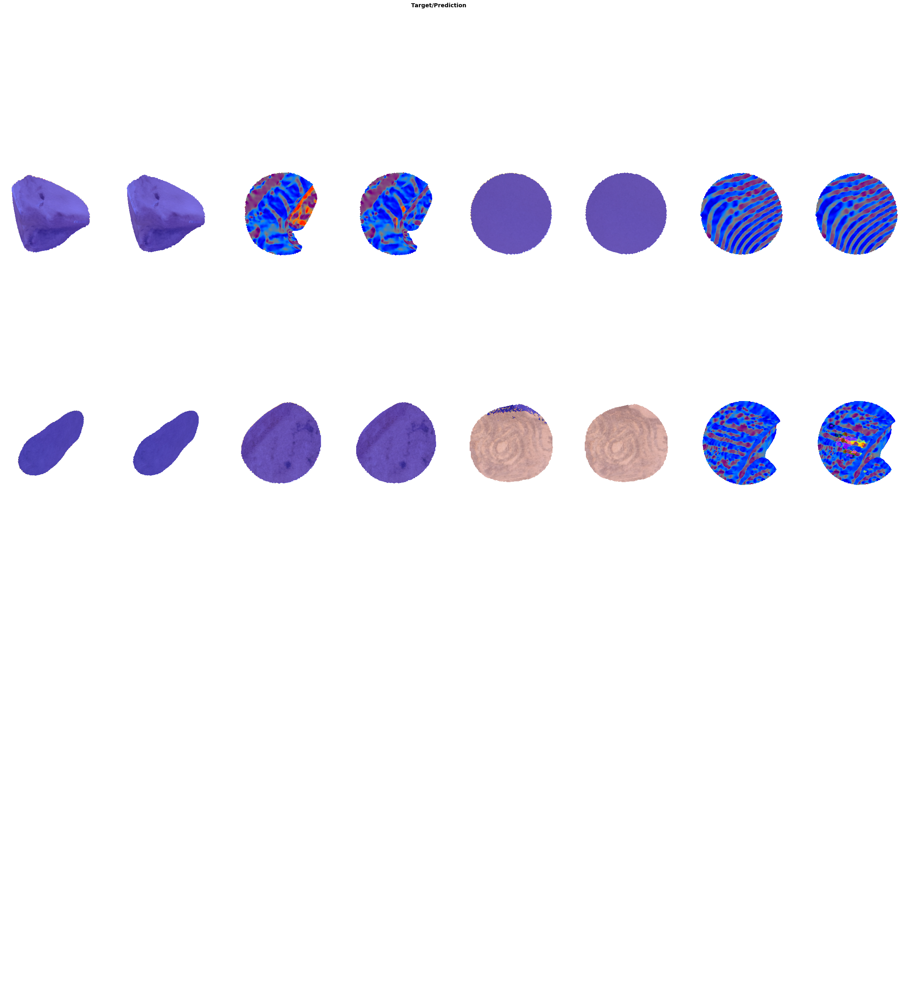

In [80]:
show_results(env, learn)

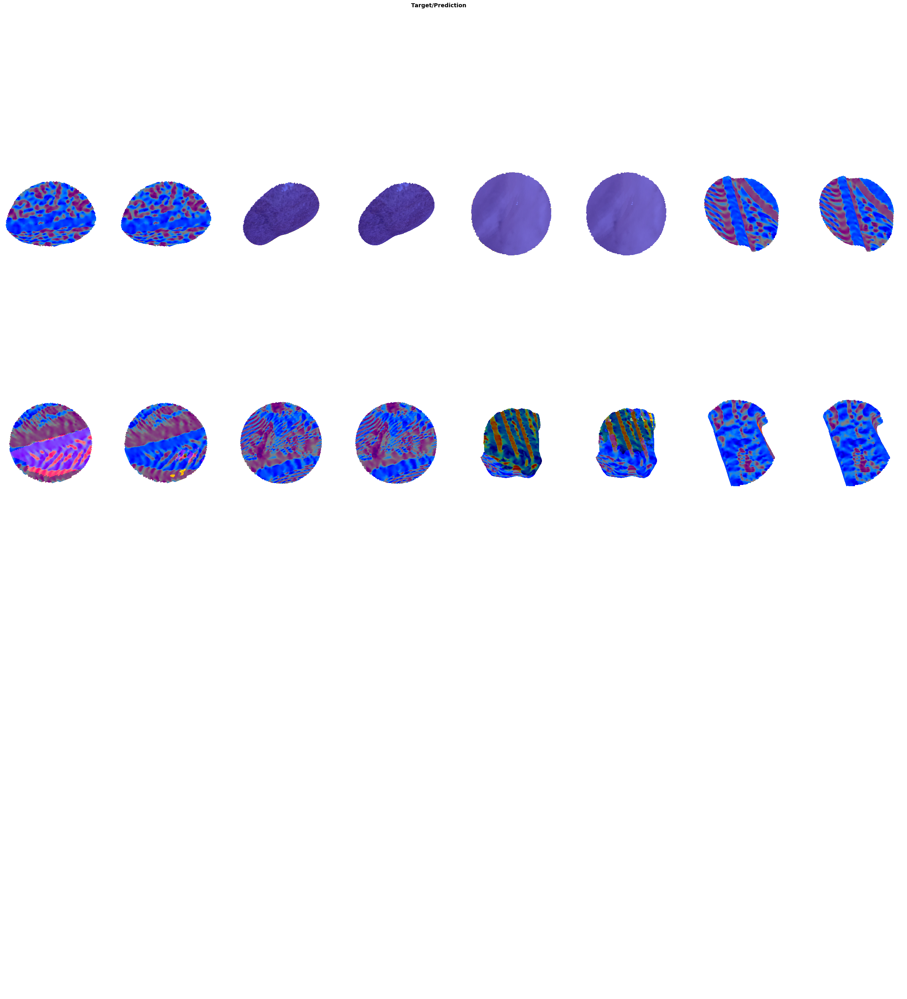

In [81]:
show_results(env, learn)

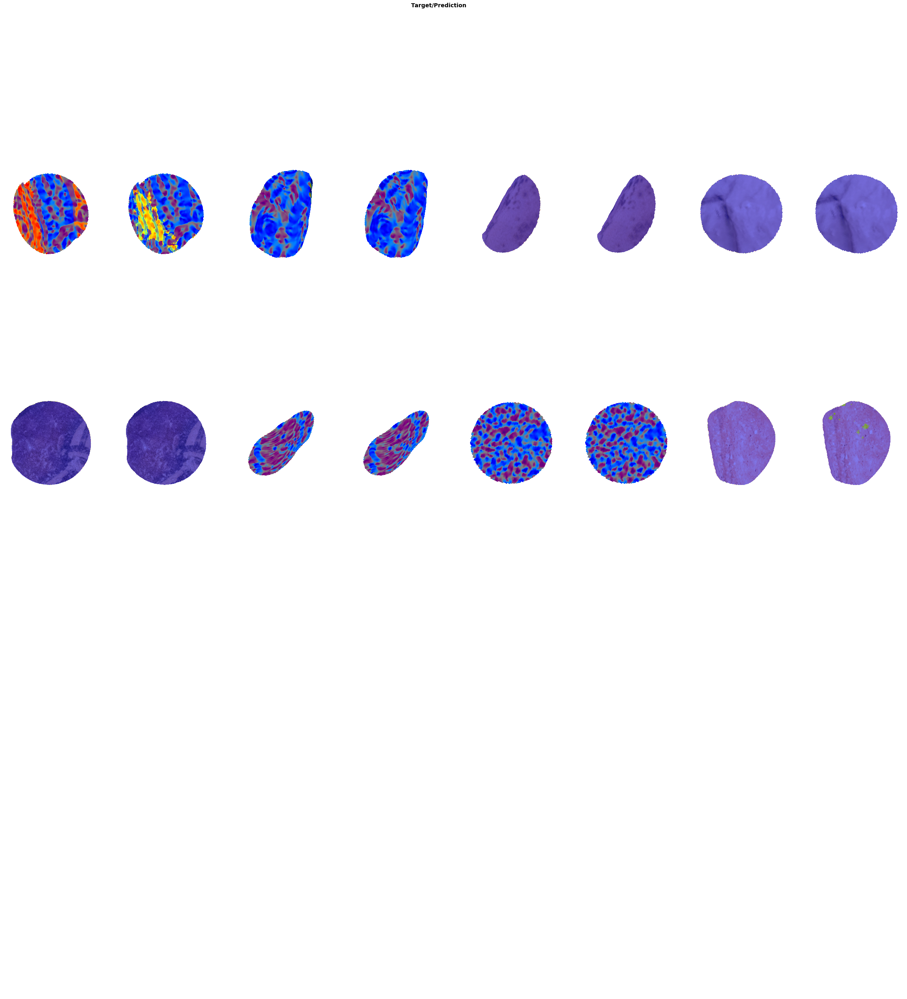

In [82]:
show_results(env, learn)

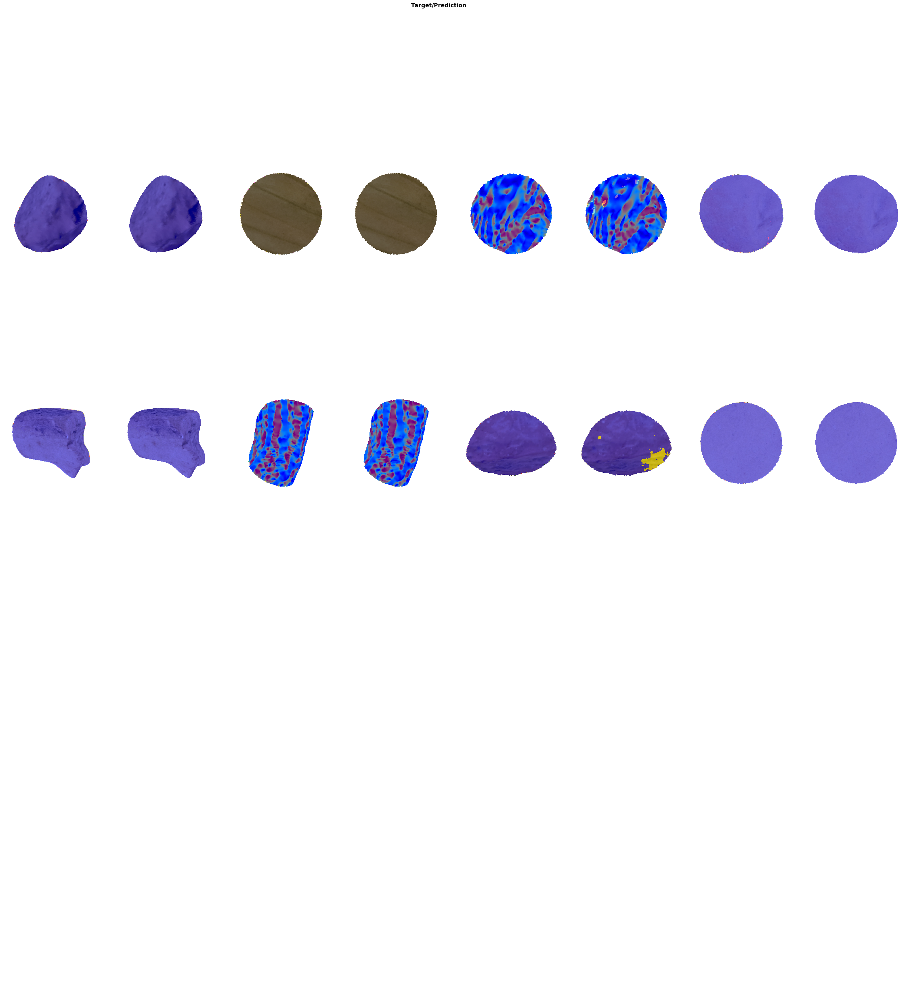

In [83]:
show_results(env, learn)

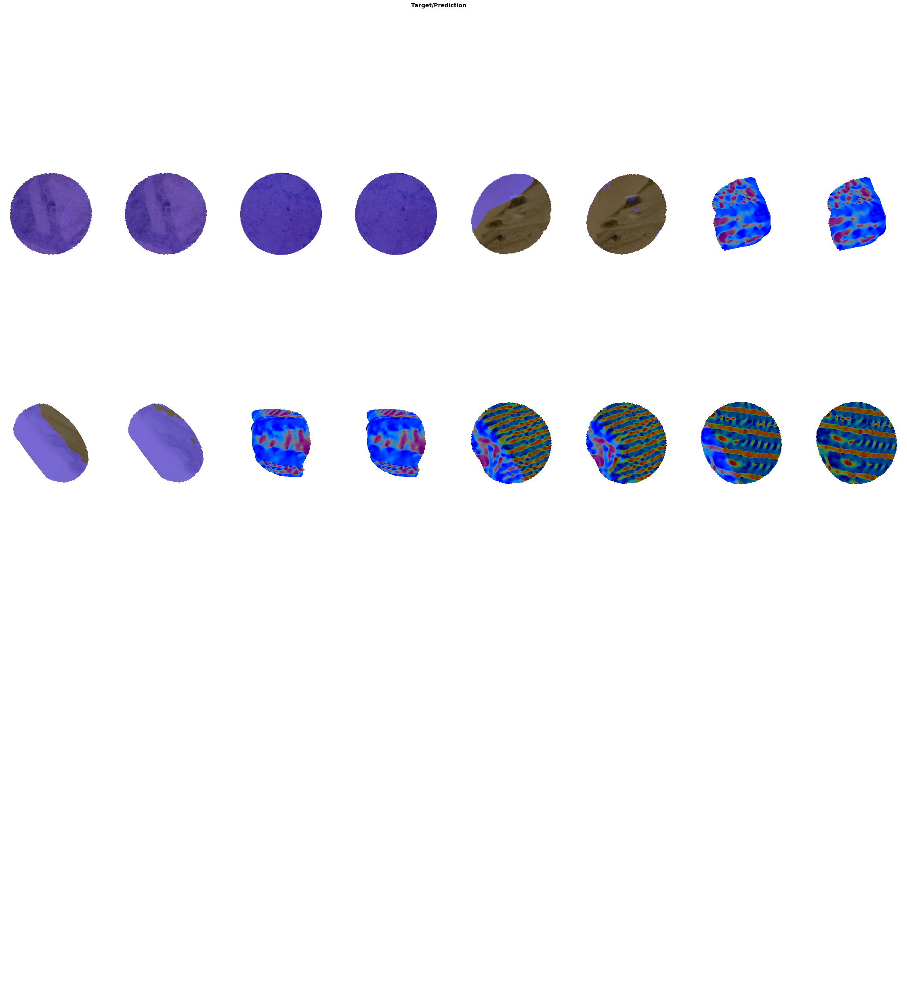

In [84]:
show_results(env, learn)

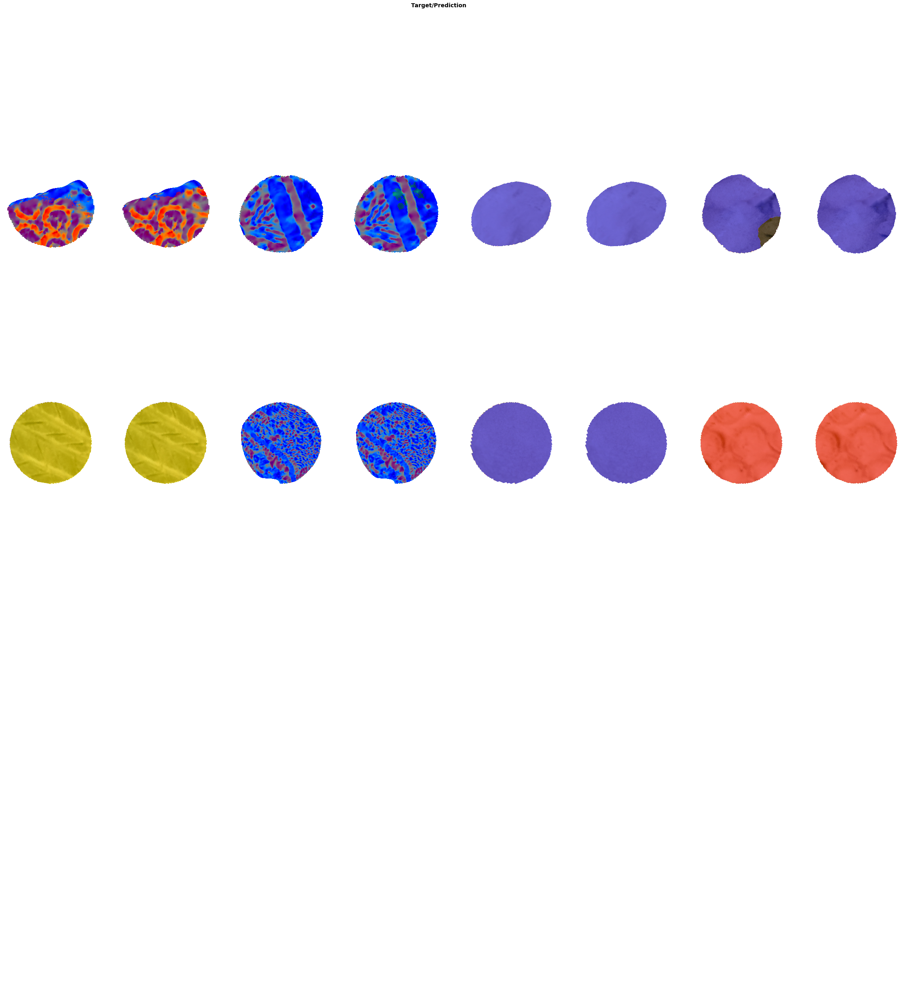

In [85]:
show_results(env, learn)

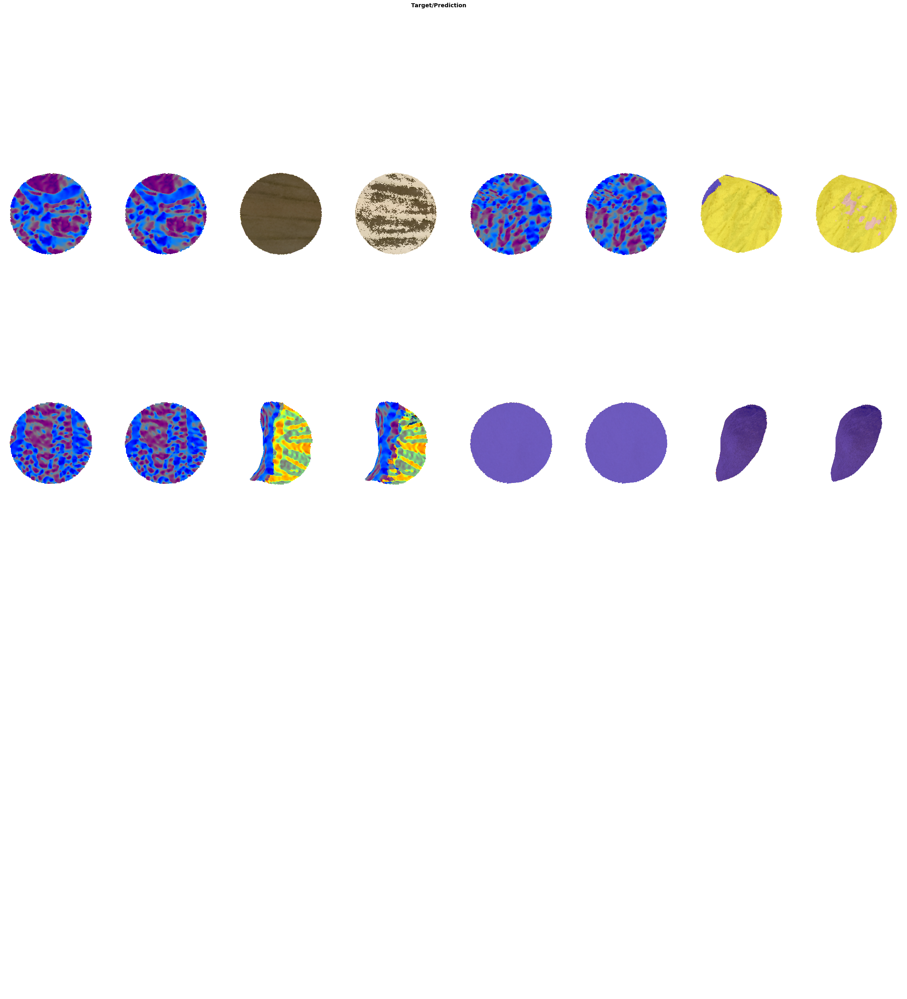

In [86]:
show_results(env, learn)

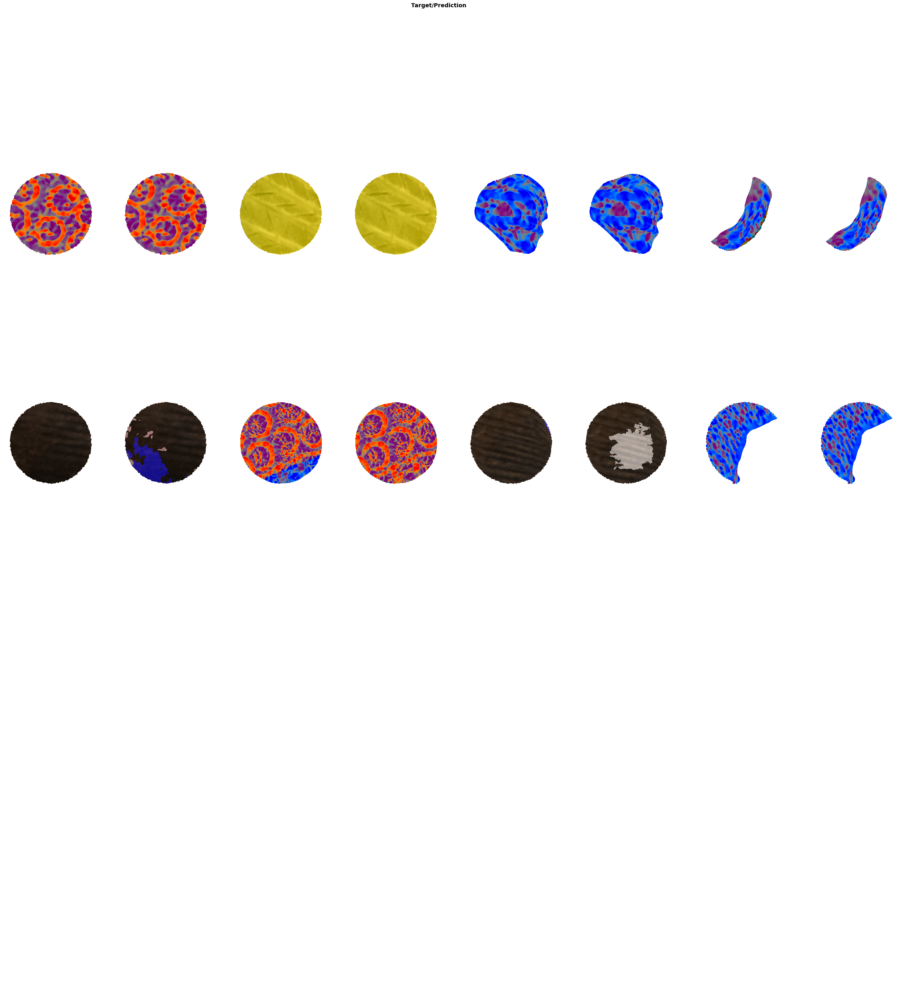

In [87]:
show_results(env, learn)

# Strong Data Aug

Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1554x1503
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/11_15-si.png
    applying PILBase.create gives
      PILMask mode=RGB size=1554x1503

Final sample: (PILImage mode=RGB size=1554x1503, PILMask mode=RGB size=

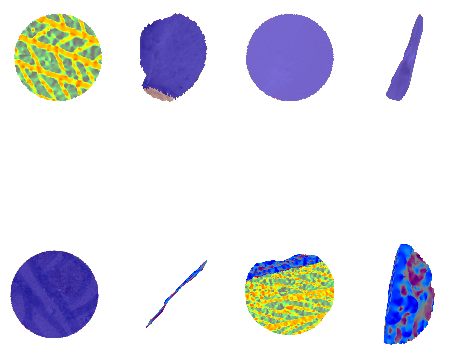

In [88]:
learn = init_learner(env)

## Round 1

-------------------------------------
Running with strong data augmentation
-------------------------------------
Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1554x1503
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/images/11_15-si.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI-patch-radius-1.25/training/masks/11_15-si.png
    applying PILBase.create gi

Sat Sep 25 09:24:28 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   40C    P0    39W / 250W |  31211MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.577588,0.499570,0.000000,0.227546,0.224005,0.248267,22:14
1,0.474099,0.419513,0.053579,0.270890,0.370363,0.276851,22:26
2,0.430003,0.386056,0.119999,0.294713,0.380628,0.312919,22:22
3,0.441599,0.421465,0.175276,0.325858,0.411619,0.344470,22:25
4,0.425124,0.374165,0.144991,0.341400,0.399748,0.342602,22:15
5,0.398981,0.358013,0.136576,0.329610,0.491760,0.329390,22:18
6,0.411410,0.351088,0.199796,0.405112,0.486203,0.388579,22:26
7,0.423487,0.379761,0.171250,0.336728,0.380239,0.361161,22:23
8,0.376885,0.326794,0.187091,0.383095,0.637445,0.377991,22:22
9,0.410804,0.309160,0.233162,0.411912,0.667536,0.409101,22:17


Better model found at epoch 0 with valid_loss value: 0.4995702803134918.
Better model found at epoch 0 with valid_loss value: 0.4995702803134918.


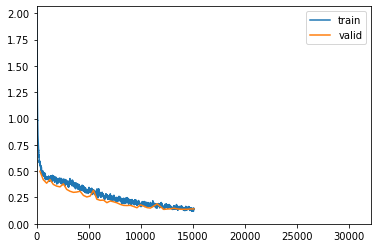

Better model found at epoch 1 with valid_loss value: 0.419513463973999.
Better model found at epoch 1 with valid_loss value: 0.419513463973999.
Better model found at epoch 2 with valid_loss value: 0.38605552911758423.
Better model found at epoch 2 with valid_loss value: 0.38605552911758423.
Better model found at epoch 4 with valid_loss value: 0.3741651773452759.
Better model found at epoch 4 with valid_loss value: 0.3741651773452759.
Better model found at epoch 5 with valid_loss value: 0.3580126464366913.
Better model found at epoch 5 with valid_loss value: 0.3580126464366913.
Better model found at epoch 6 with valid_loss value: 0.3510875701904297.
Better model found at epoch 6 with valid_loss value: 0.3510875701904297.
Better model found at epoch 8 with valid_loss value: 0.32679373025894165.
Better model found at epoch 8 with valid_loss value: 0.32679373025894165.
Better model found at epoch 9 with valid_loss value: 0.3091603219509125.
Better model found at epoch 9 with valid_loss val

Looking for SURFpatt_v3alpha-RGB+SI-patch-radius-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_14.46.24-WD-0.0001-BS-8-LR-0.0022908675670623778-0.02290867567062378-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-0.00010000000149011613-0.0010000000149011613-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-2.0892961401841603e-08-2.08929614018416e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-22_16.23.32-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpa

0 - valid_loss = 0.6060579419136047
1 - surfpatt_metric = 0.010905127972364426
2 - f-score = 0.2478314734498647
3 - precision = 0.4462781907498876
4 - recall = 0.25894854148580254
LR_finding in parallel_ctx context on GPU [0, 1]


Sun Sep 26 03:35:56 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   41C    P0    39W / 250W |  31211MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.659558,0.464749,0.163662,0.408073,0.509938,0.385636,23:32
1,0.532435,0.406448,0.265633,0.468322,0.530026,0.458514,23:25
2,0.446187,0.361516,0.305399,0.501222,0.577246,0.480592,23:26
3,0.404612,0.322544,0.330657,0.525397,0.613768,0.507828,23:24
4,0.353952,0.282631,0.341012,0.545793,0.660216,0.512583,23:22
5,0.345426,0.261843,0.395238,0.584240,0.642073,0.555737,23:35
6,0.309436,0.238587,0.446679,0.631999,0.669330,0.609652,23:29
7,0.291070,0.216914,0.440694,0.621975,0.681217,0.594733,23:26
8,0.272811,0.196337,0.476987,0.662384,0.747068,0.617273,23:19
9,0.211754,0.182209,0.485221,0.684262,0.762031,0.638612,23:35


Better model found at epoch 0 with valid_loss value: 0.46474891901016235.
Better model found at epoch 0 with valid_loss value: 0.46474891901016235.


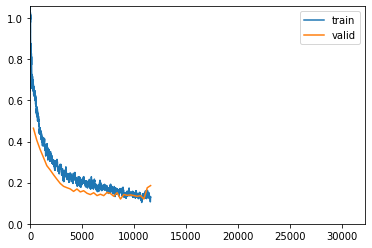

Better model found at epoch 1 with valid_loss value: 0.40644752979278564.
Better model found at epoch 1 with valid_loss value: 0.40644752979278564.
Better model found at epoch 2 with valid_loss value: 0.3615162968635559.
Better model found at epoch 2 with valid_loss value: 0.3615162968635559.
Better model found at epoch 3 with valid_loss value: 0.3225443363189697.
Better model found at epoch 3 with valid_loss value: 0.3225443363189697.
Better model found at epoch 4 with valid_loss value: 0.2826307415962219.
Better model found at epoch 4 with valid_loss value: 0.2826307415962219.
Better model found at epoch 5 with valid_loss value: 0.26184263825416565.
Better model found at epoch 5 with valid_loss value: 0.26184263825416565.
Better model found at epoch 6 with valid_loss value: 0.23858660459518433.
Better model found at epoch 6 with valid_loss value: 0.23858660459518433.
Better model found at epoch 7 with valid_loss value: 0.21691419184207916.
Better model found at epoch 7 with valid_los

Looking for SURFpatt_v3alpha-RGB+SI-patch-radius-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_14.46.24-WD-0.0001-BS-8-LR-0.0022908675670623778-0.02290867567062378-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-0.00010000000149011613-0.0010000000149011613-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-21_15.22.37-WD-0.0001-BS-8-LR-2.0892961401841603e-08-2.08929614018416e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-patch-radius-1.25-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-22_16.23.32-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpa

0 - valid_loss = 0.5298008322715759
1 - surfpatt_metric = 0.06895440071821213
2 - f-score = 0.30821072286319384
3 - precision = 0.46846496052885006
4 - recall = 0.29640740558453094


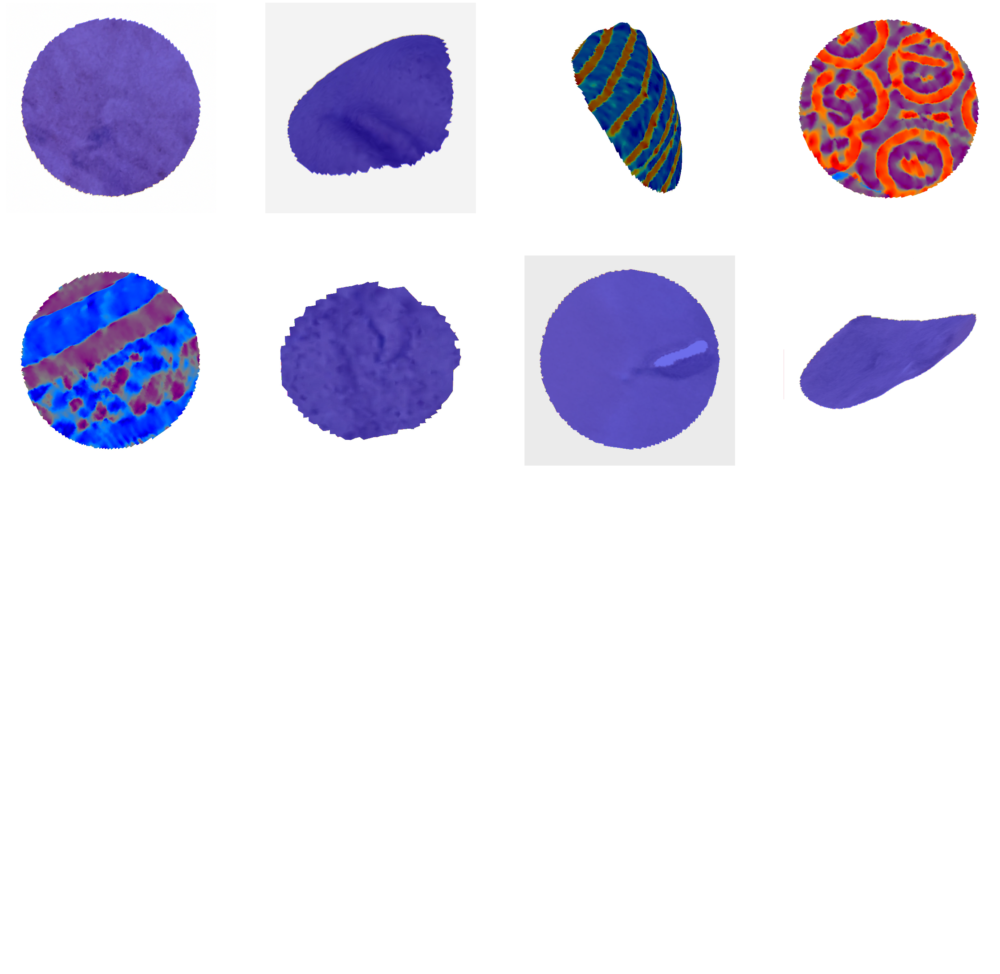

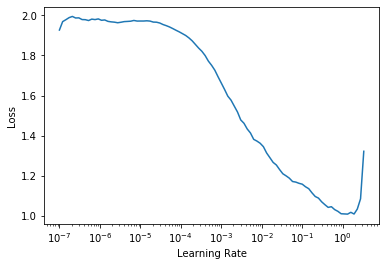

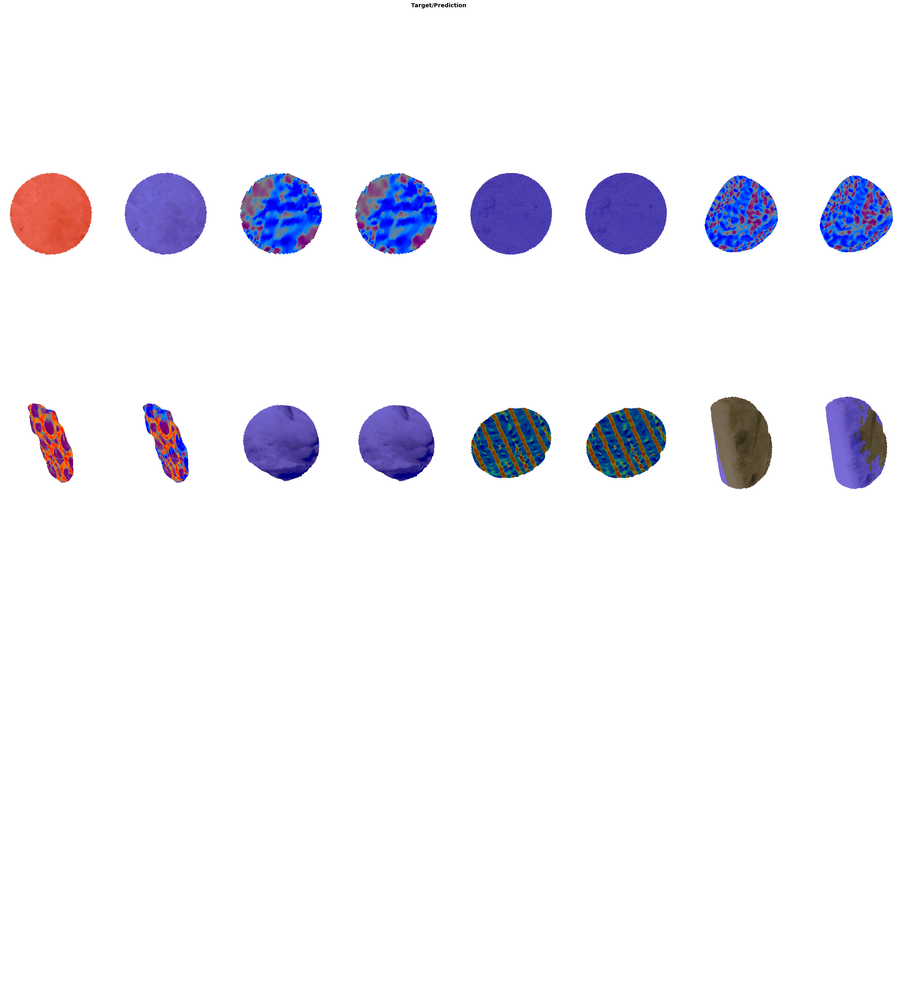

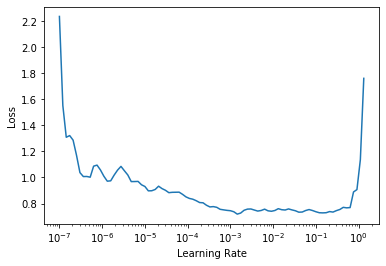

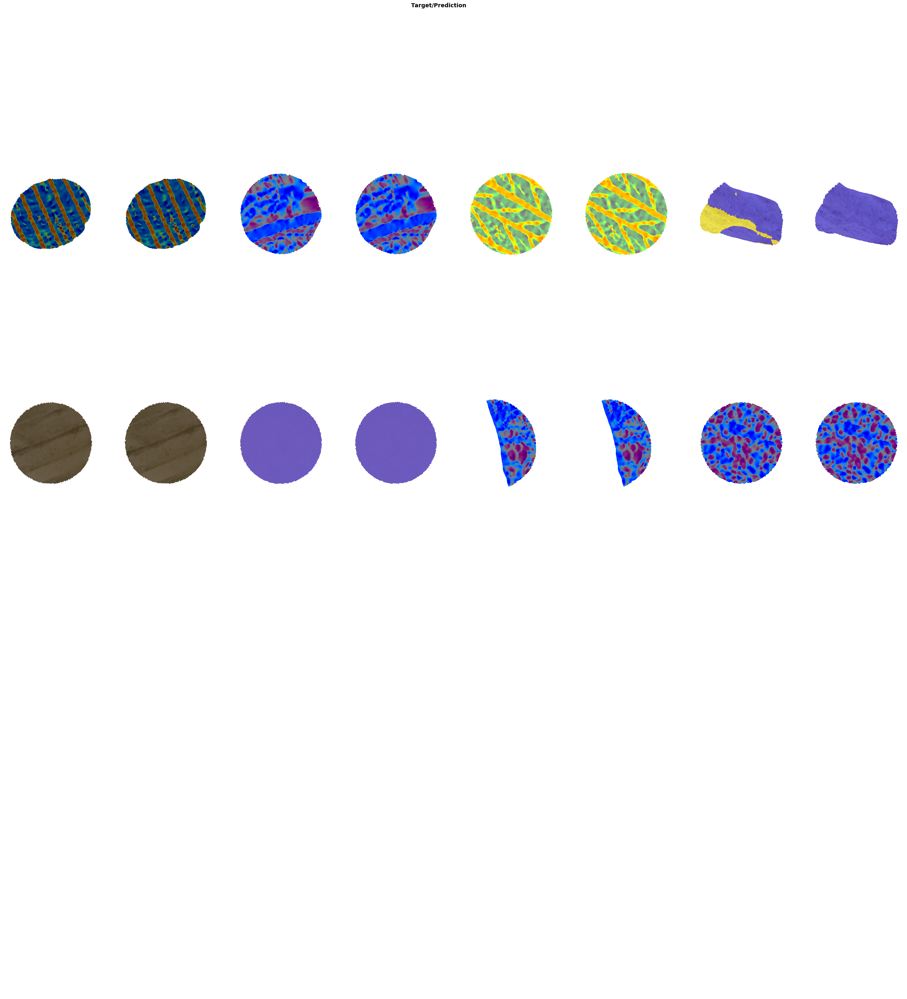

In [89]:
env['train_round']       = 0
env['data-augmentation'] = 'strong-data-aug'
do_training_round(env, learn, epochs=100)

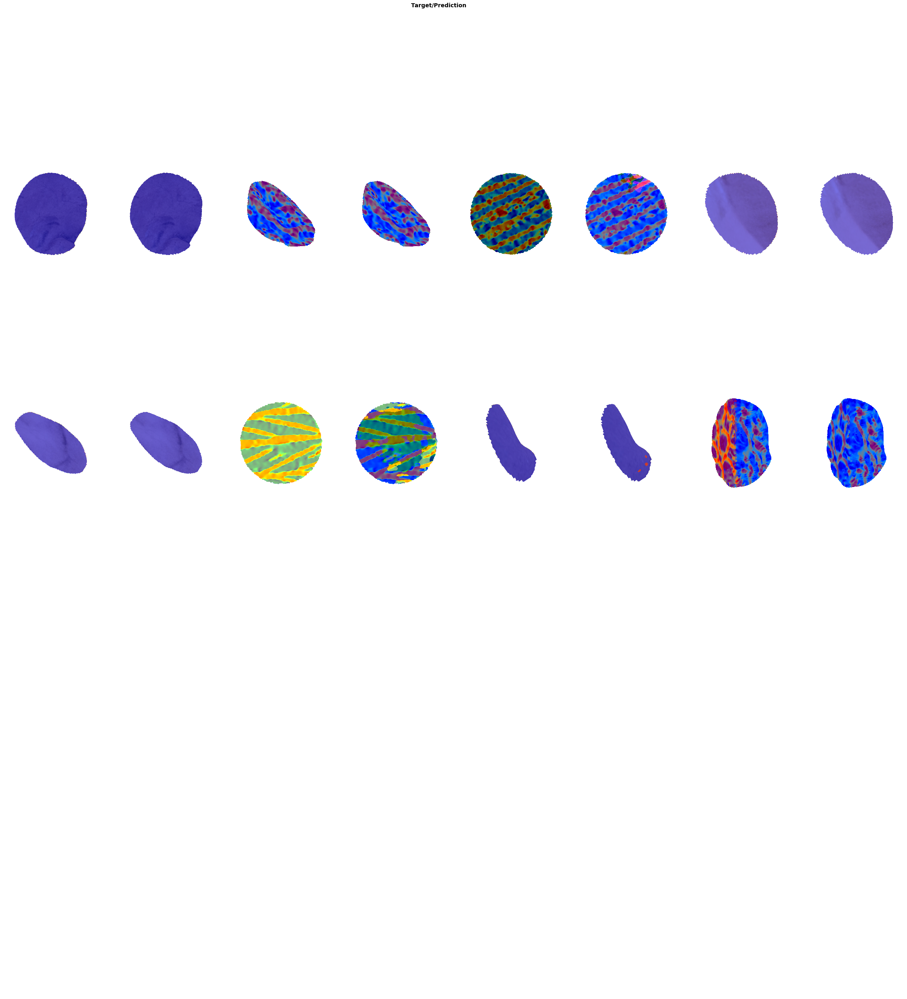

In [90]:
show_results(env, learn)

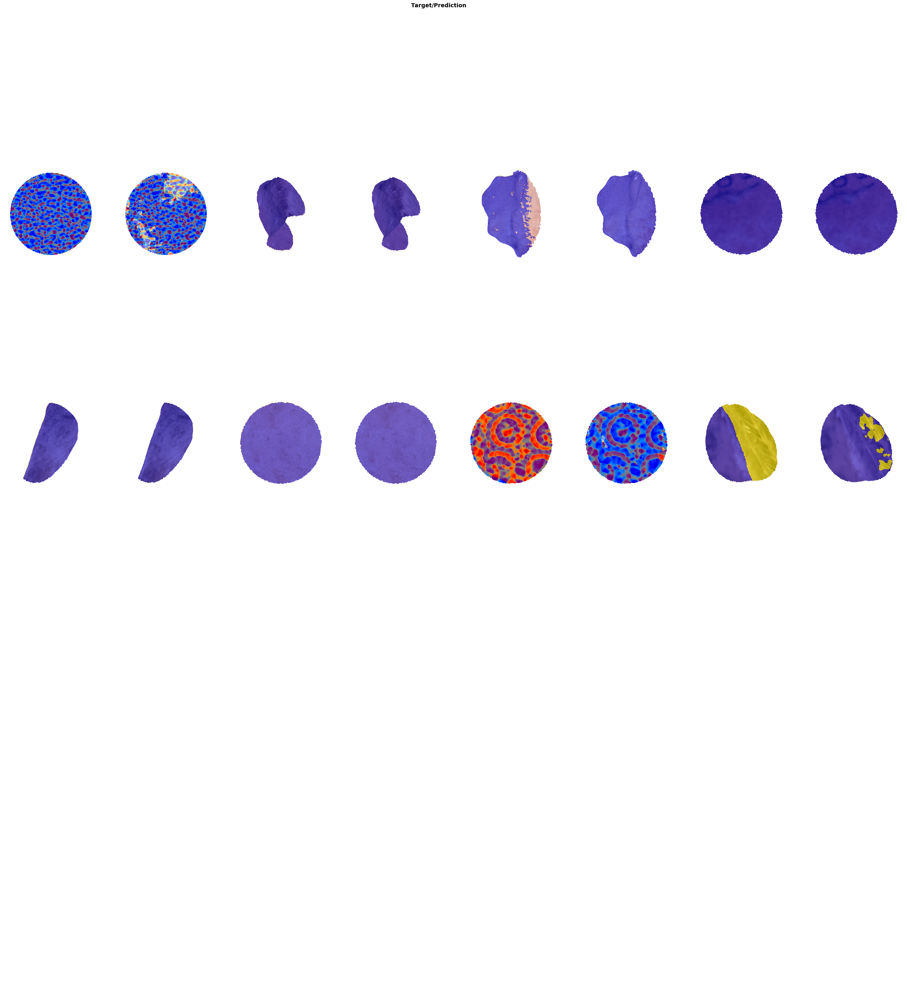

In [91]:
show_results(env, learn)

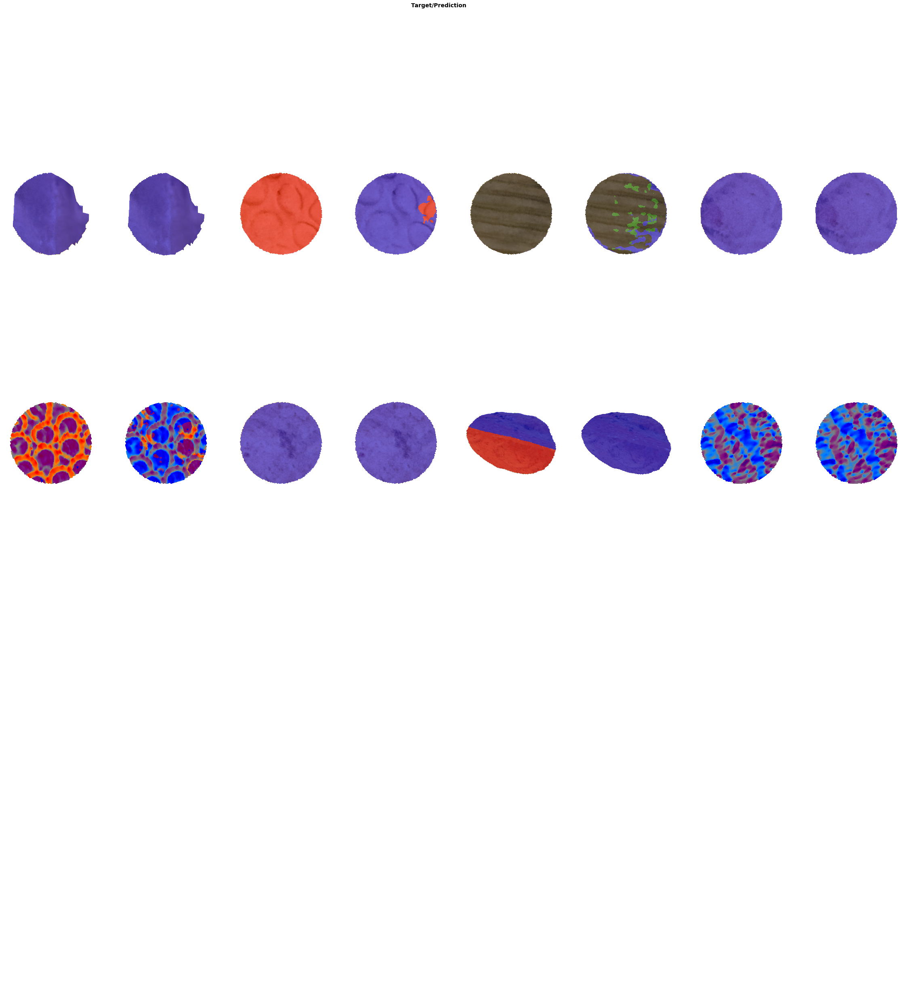

In [92]:
show_results(env, learn)

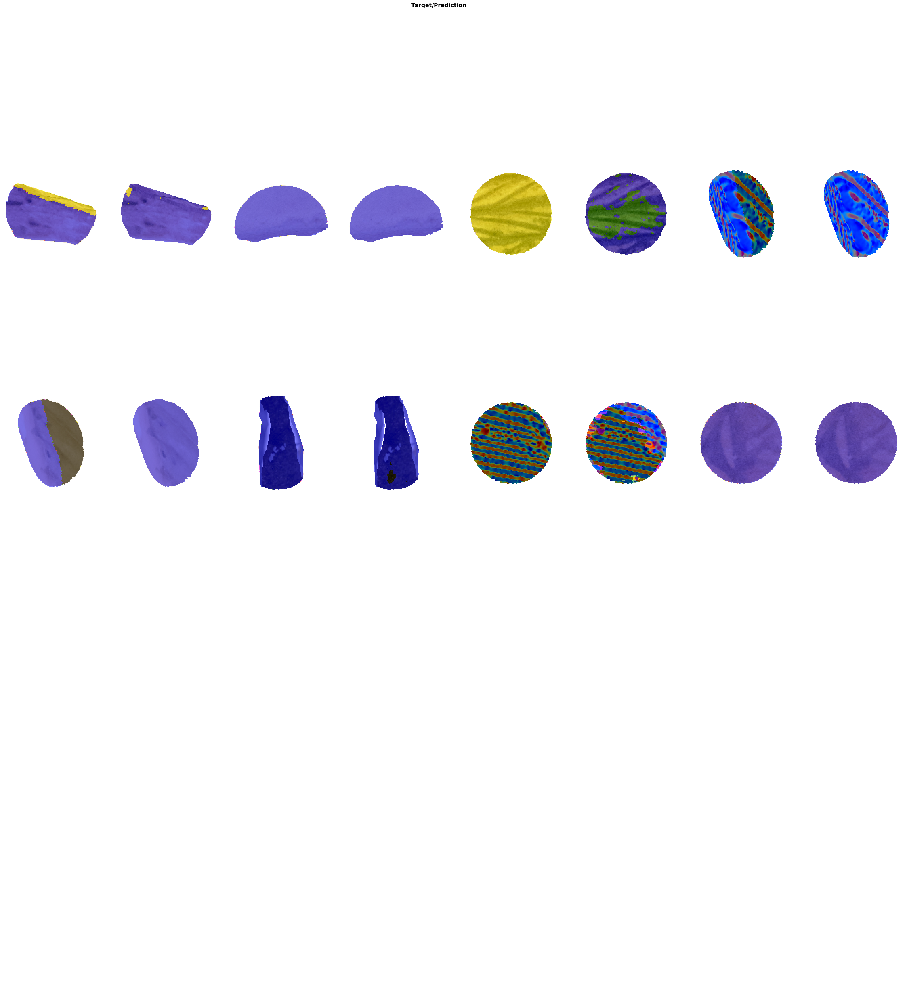

In [93]:
show_results(env, learn)

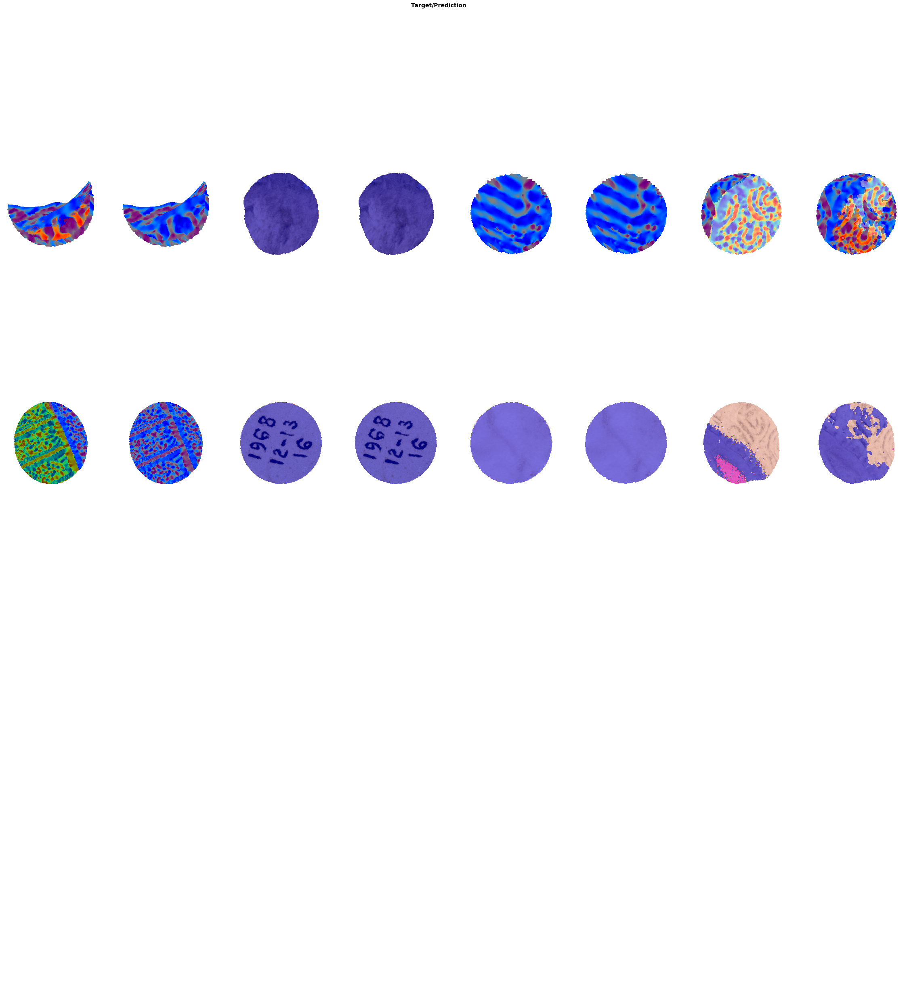

In [94]:
show_results(env, learn)

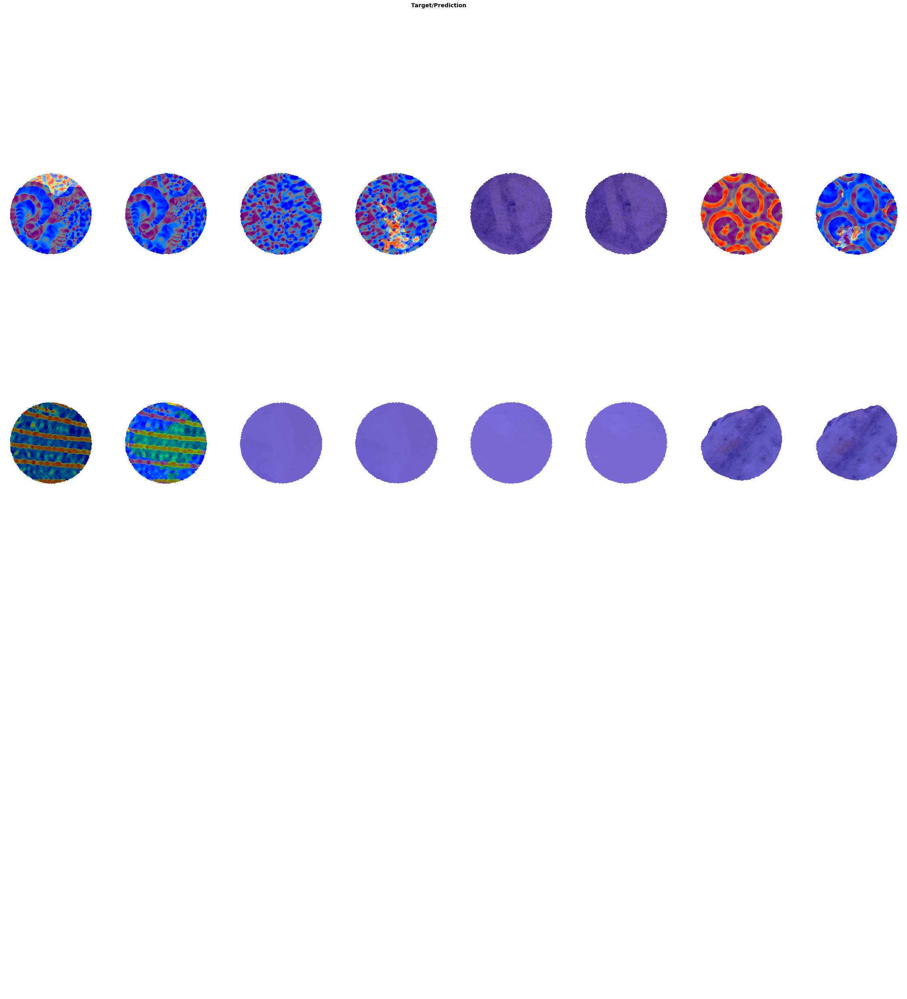

In [95]:
show_results(env, learn)

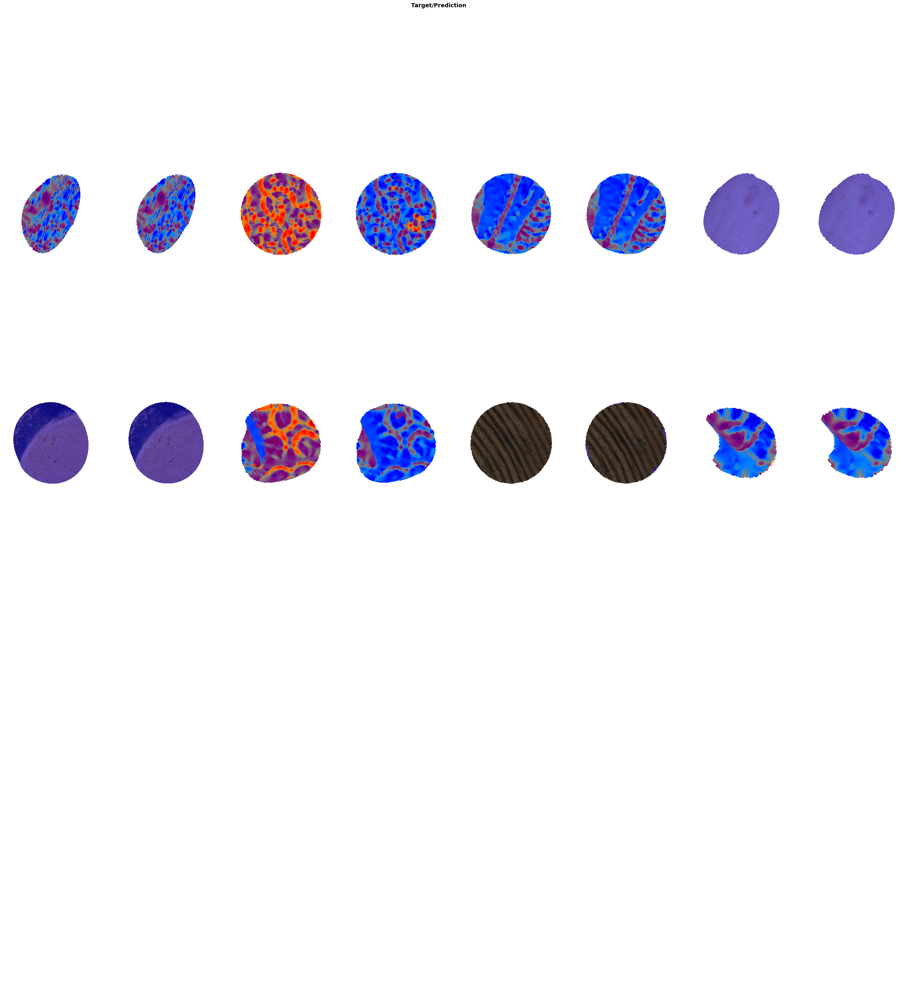

In [96]:
show_results(env, learn)

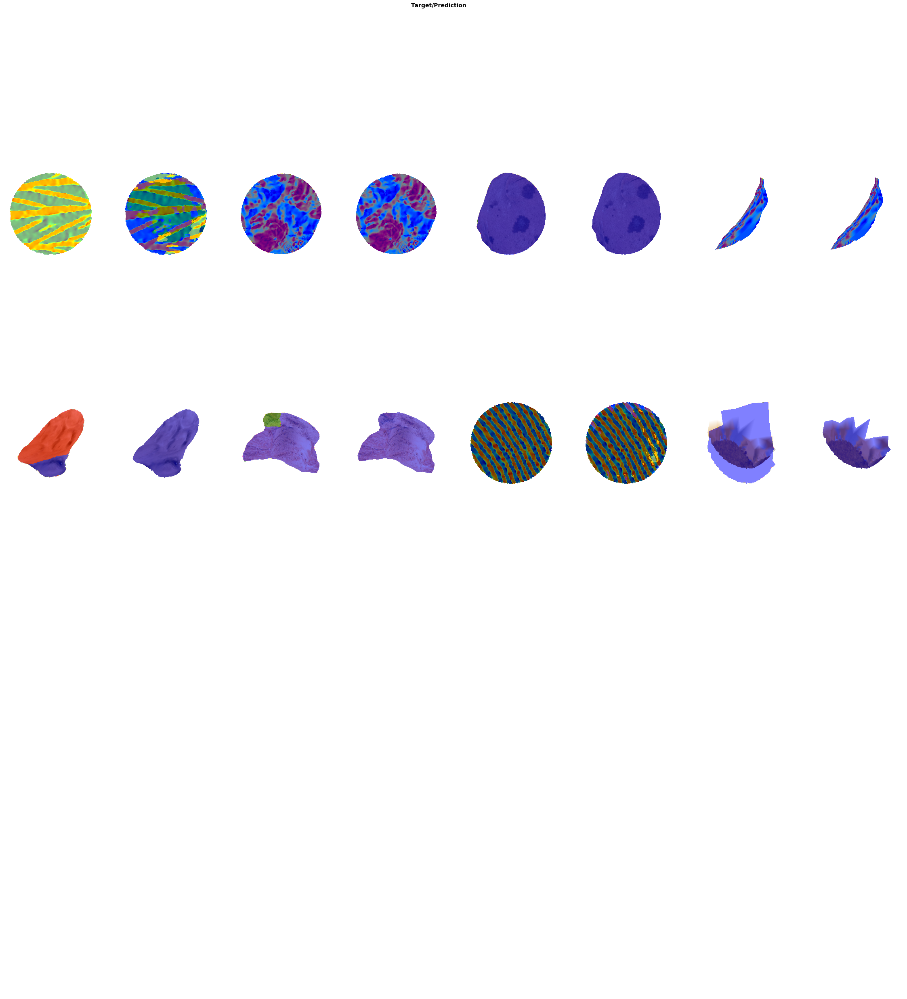

In [97]:
show_results(env, learn)

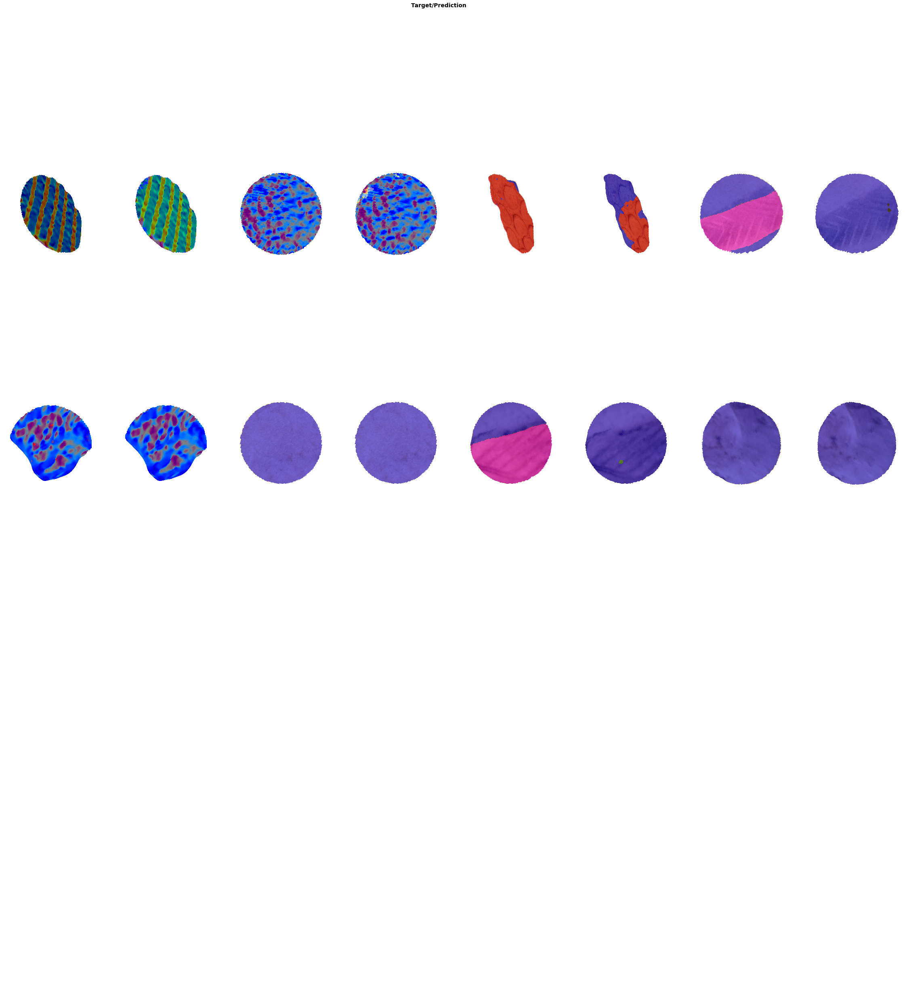

In [98]:
show_results(env, learn)

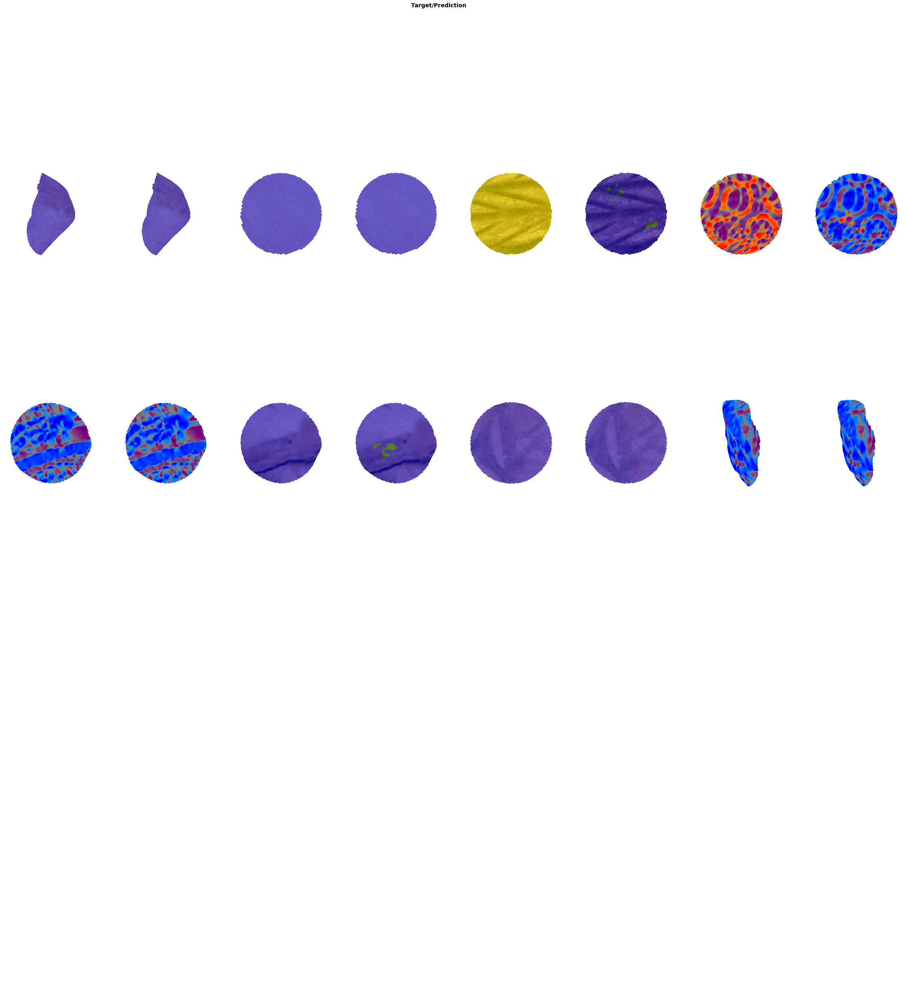

In [99]:
show_results(env, learn)

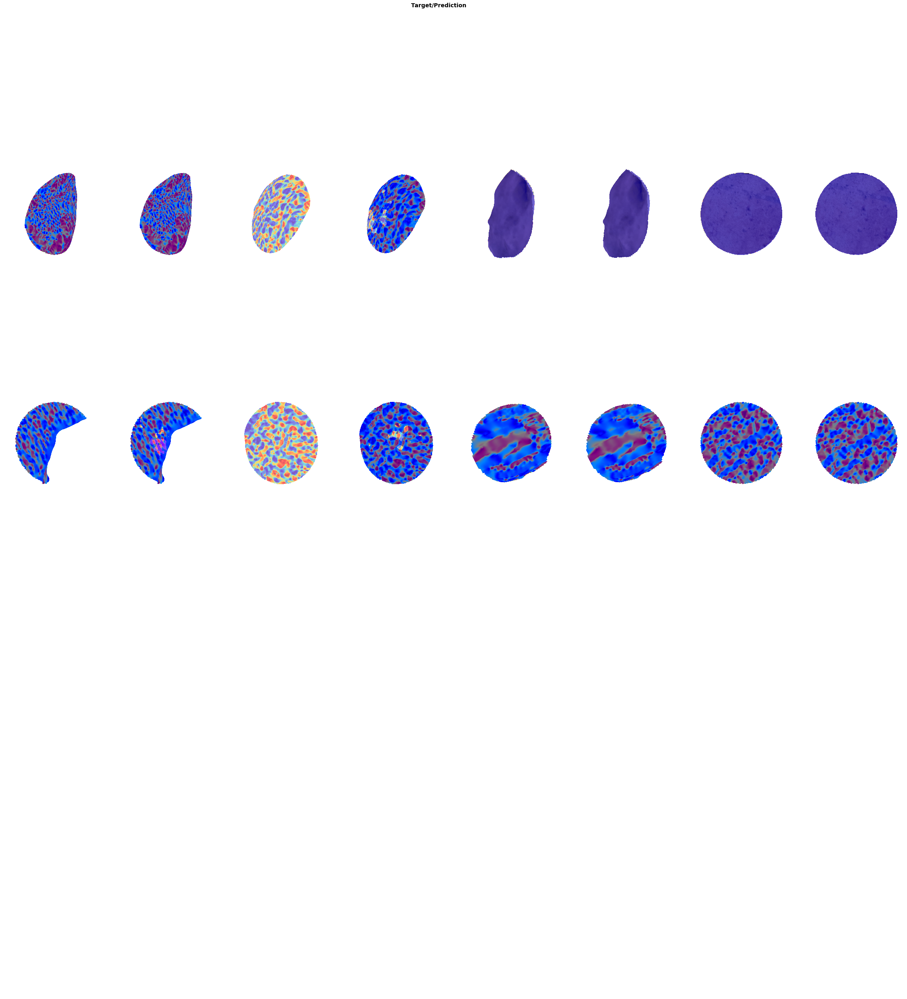

In [100]:
show_results(env, learn)

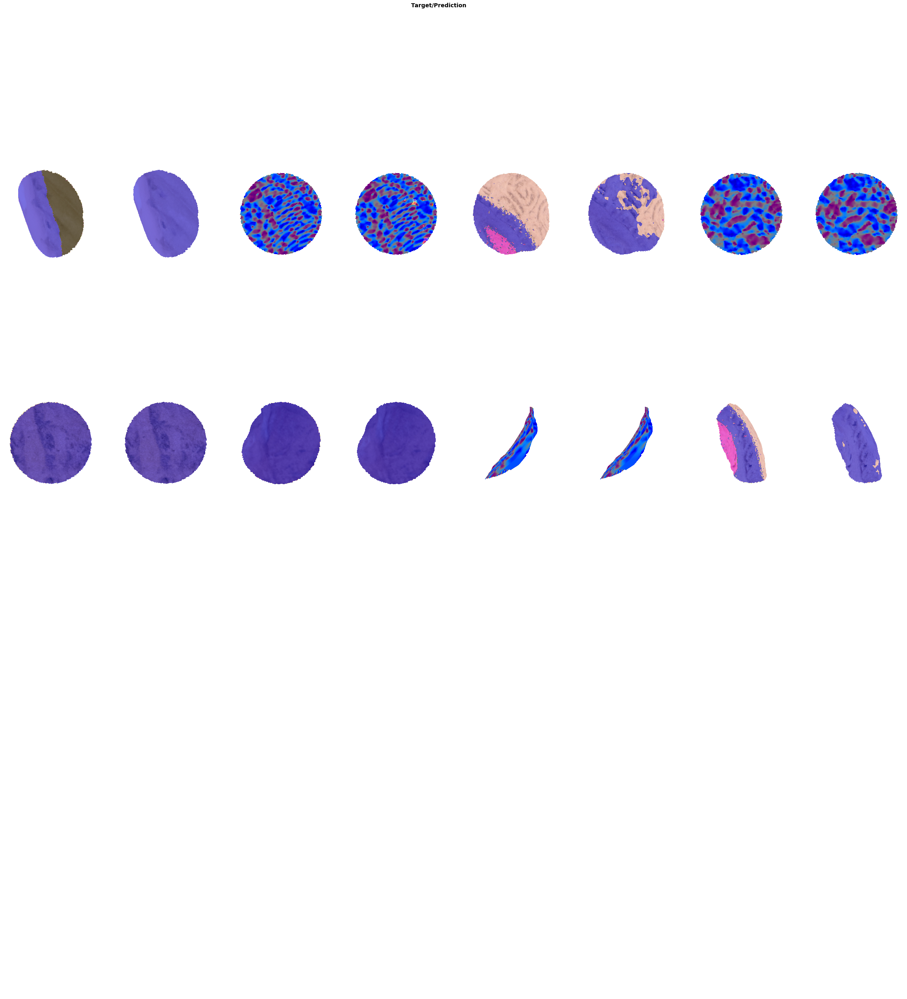

In [101]:
show_results(env, learn)

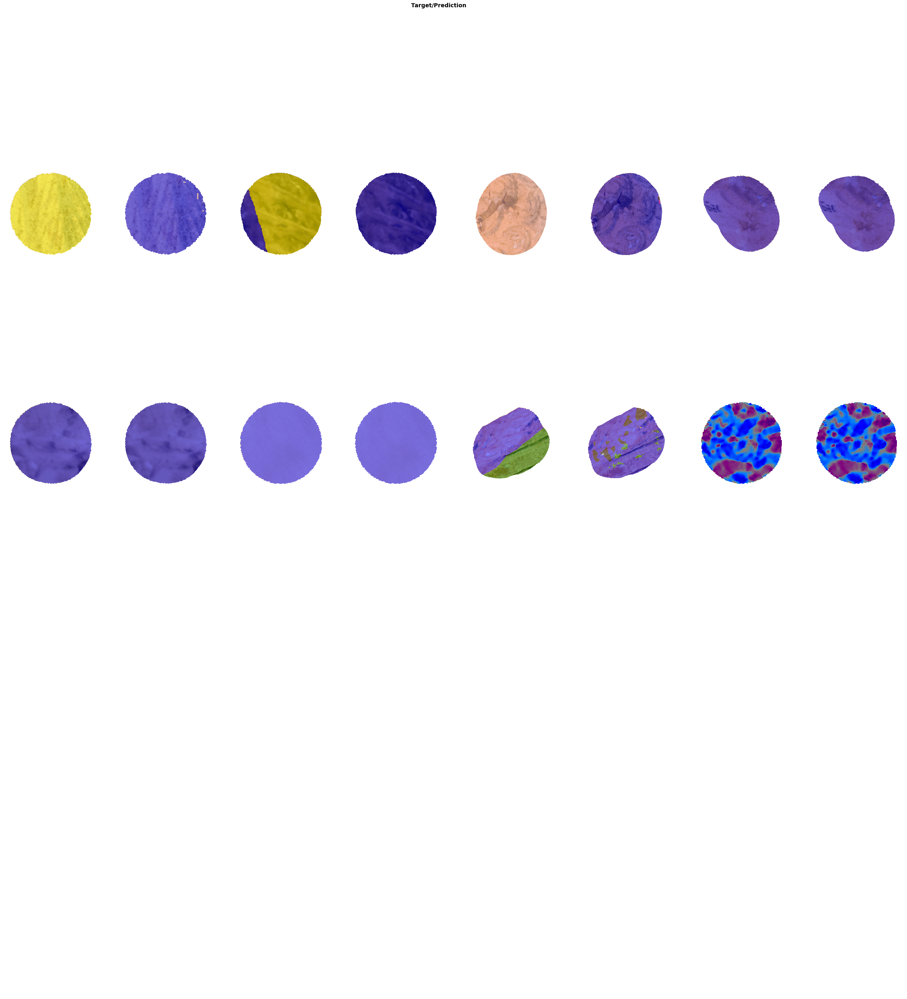

In [102]:
show_results(env, learn)

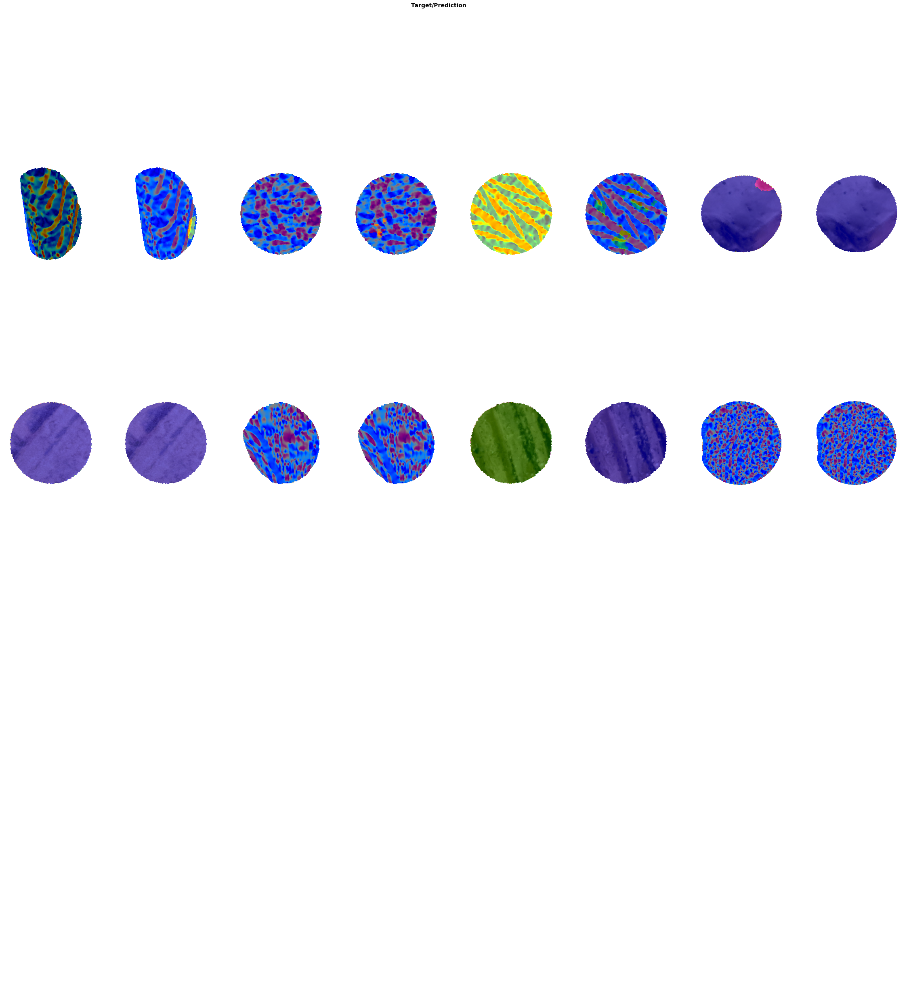

In [103]:
show_results(env, learn)

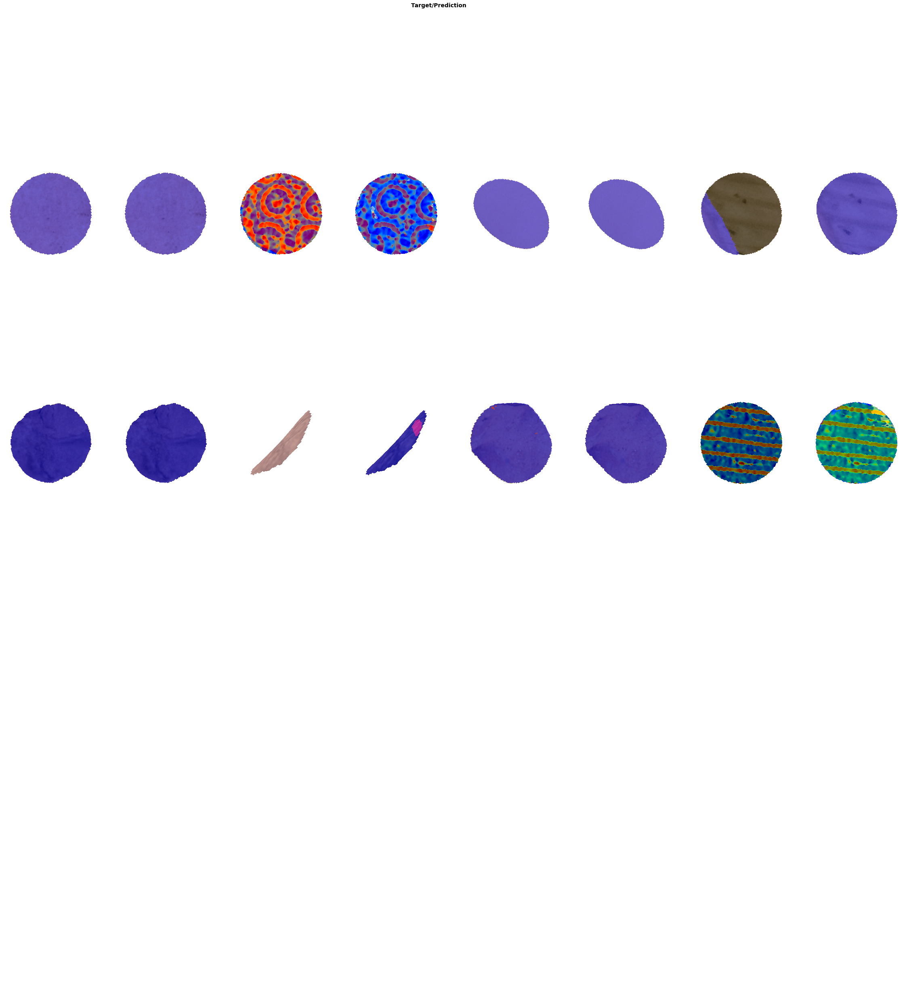

In [104]:
show_results(env, learn)

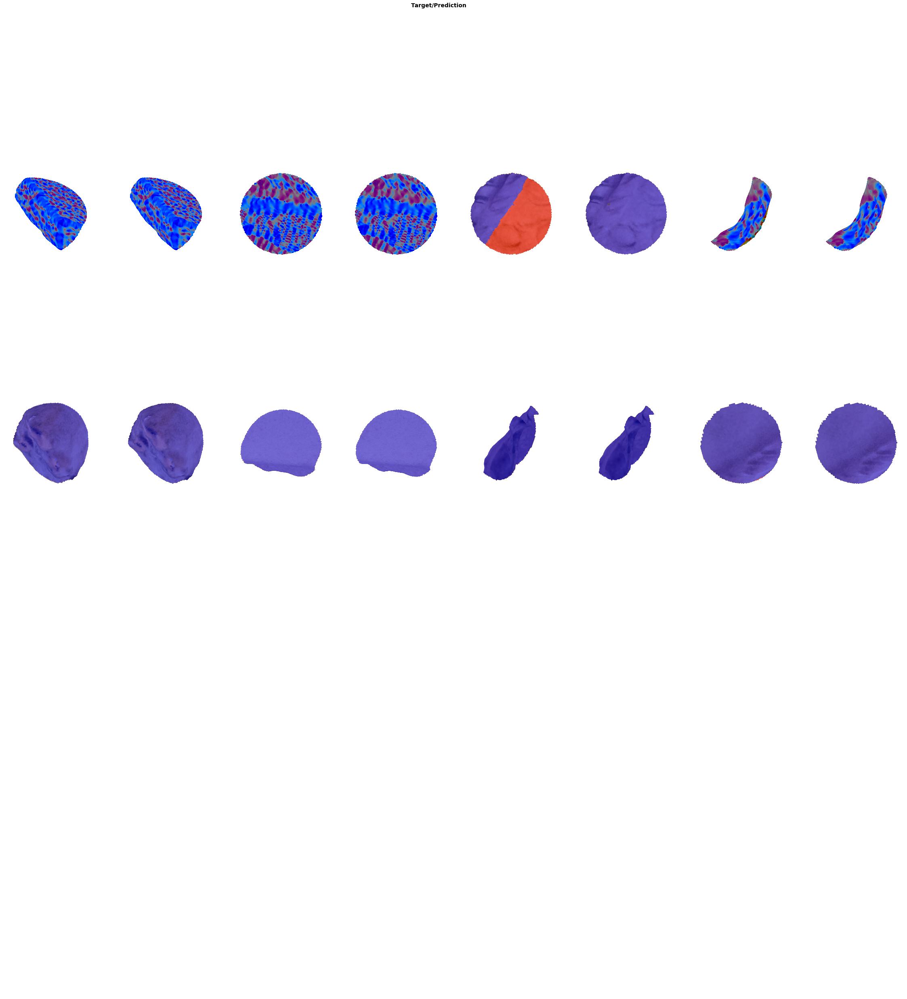

In [105]:
show_results(env, learn)

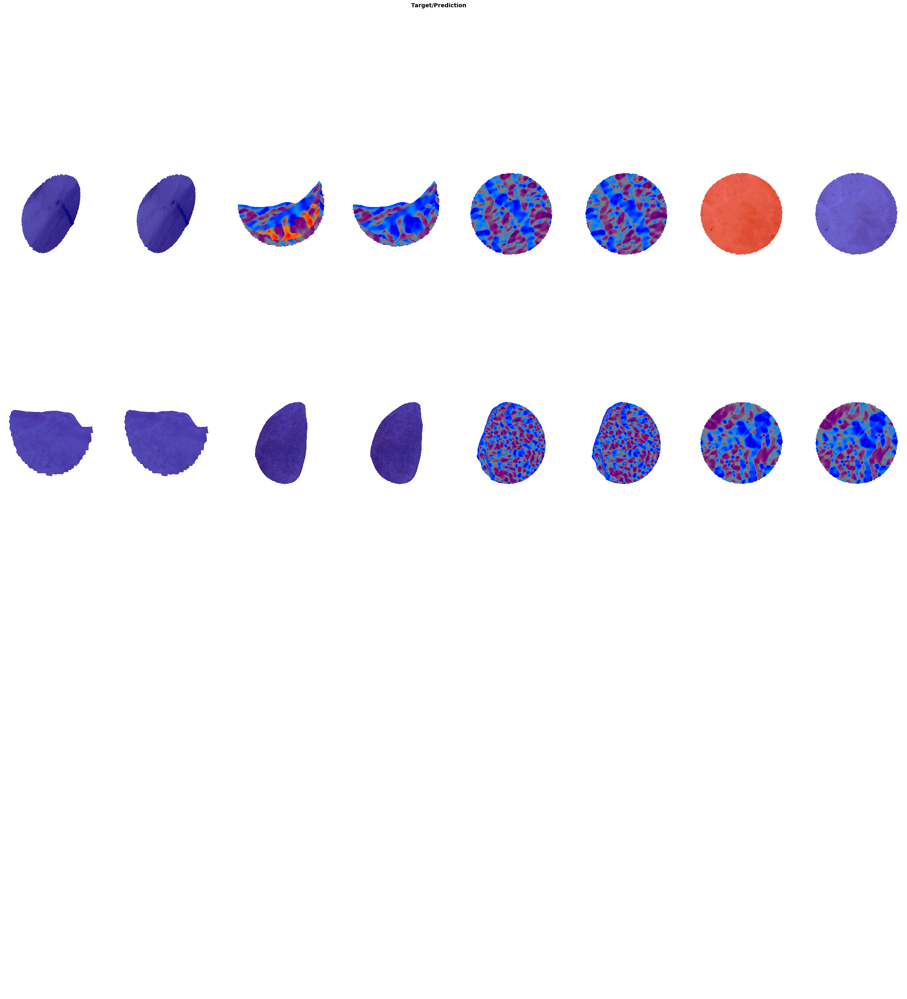

In [106]:
show_results(env, learn)

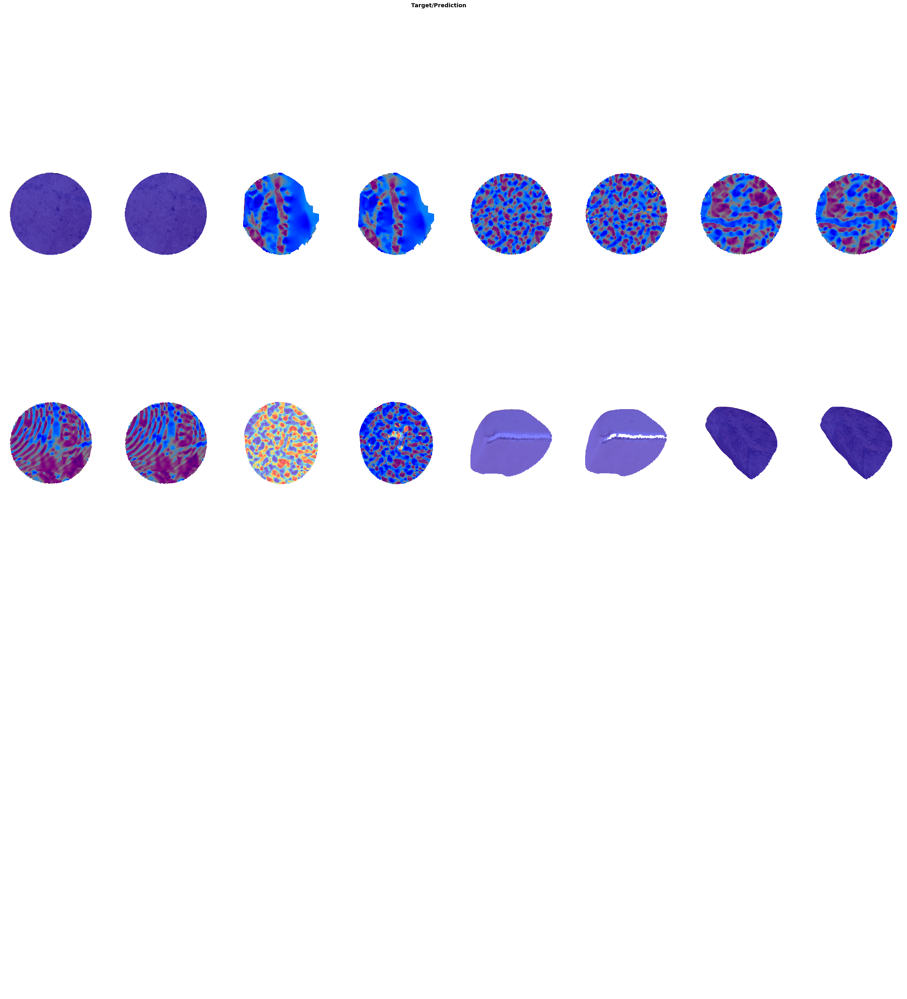

In [107]:
show_results(env, learn)

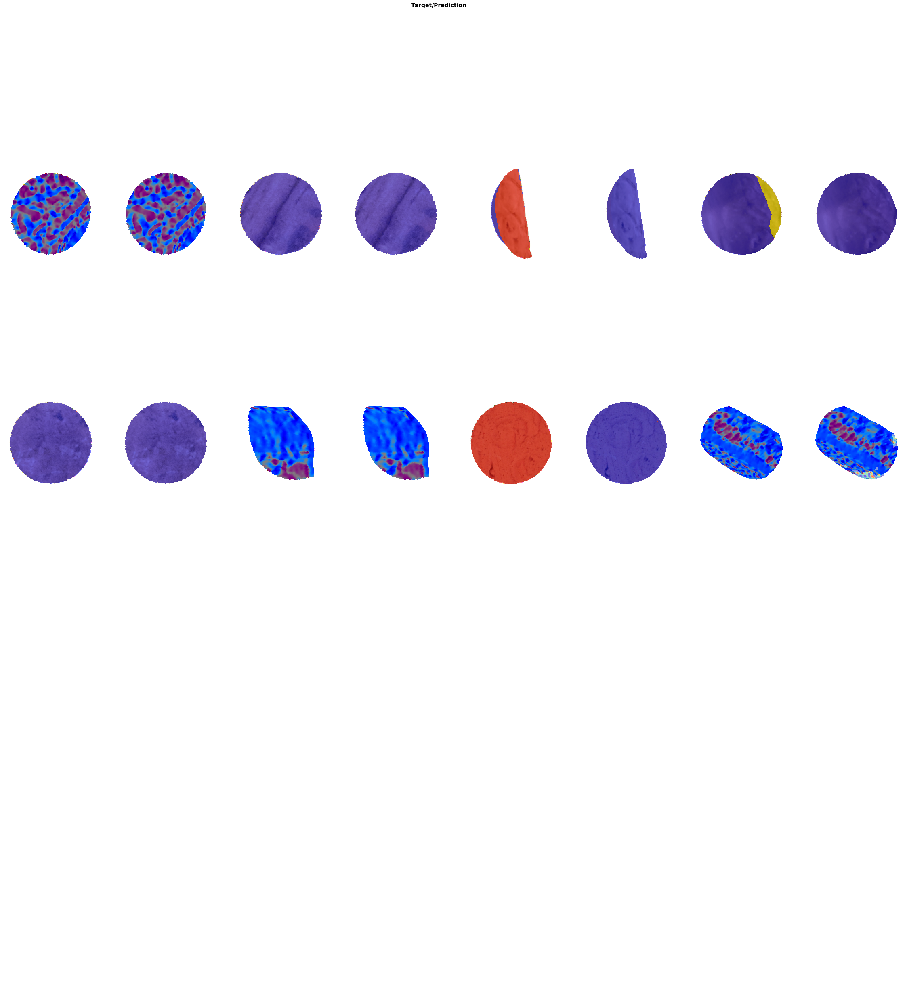

In [108]:
show_results(env, learn)

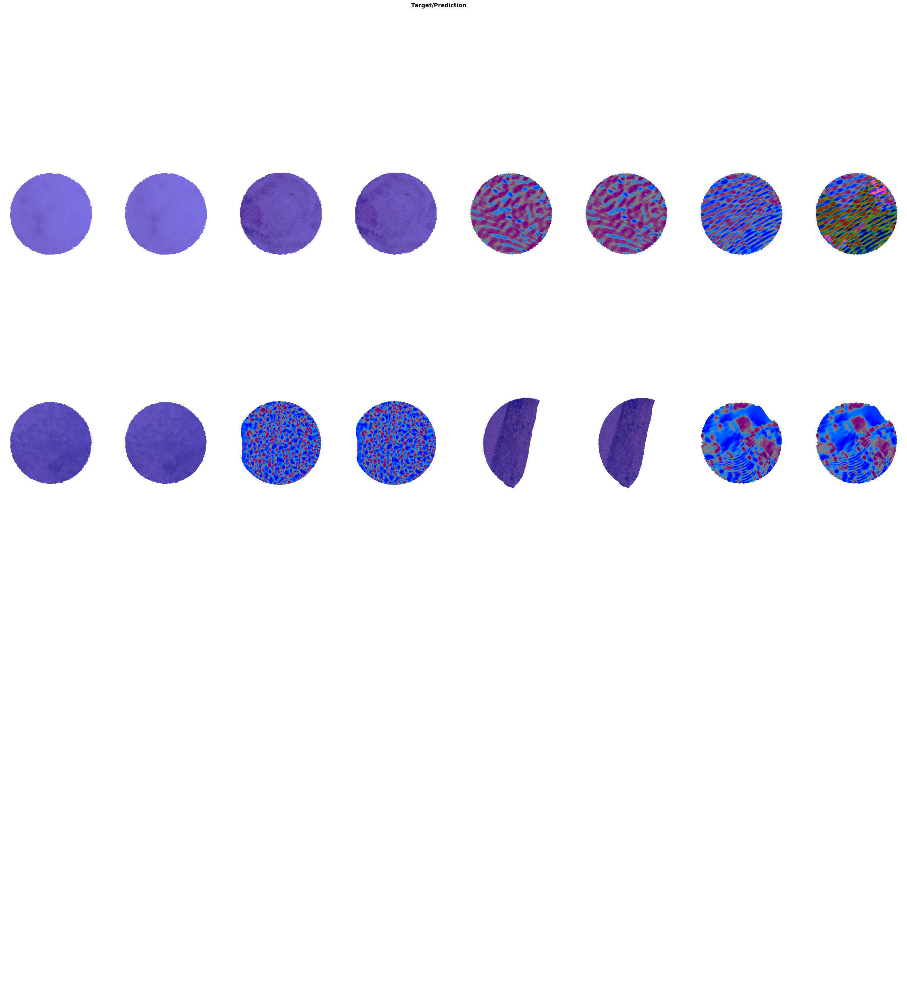

In [109]:
show_results(env, learn)